In [1]:
import networkx as nx
import pandas as pd
import gurobipy as gp
import random
import re
import csv
import itertools
import pickle

from gurobipy import GRB
from neo4j import GraphDatabase
from getpass import getpass

In [2]:
pd.set_option('max_colwidth', None)

Db da far partire zone_point_190623

In [2]:
user = getpass('Neo4j user: ')
password = getpass('Neo4j pass: ')

Neo4j user: ········
Neo4j pass: ········


In [3]:
uri = 'bolt://localhost:7687'
driver = GraphDatabase.driver(uri, auth=('neo4j','password'), encrypted=False)

In [4]:
def cypherQueryToDataFrame(query):
    with driver.session(database = 'neo4j') as session:
        result = session.run(query)
        return pd.DataFrame(result.data(), columns=result.keys())

## Nodi da prendere per ogni zona


In [5]:
query = """
MATCH (z:Zona)<-[]-(p:Point)
WITH z.descZona as zona, p
RETURN zona, count(p) as puntiTot,
CASE 
  WHEN count(p) < 11 THEN 1
  WHEN count(p) > 10 and count(p) < 51 THEN 3
  WHEN count(p) > 50 and count(p) < 151 THEN 5
  ELSE 8
END AS numNodiDaPrendere
ORDER BY numNodiDaPrendere
"""

zone = cypherQueryToDataFrame(query)
zone

,zona,puntiTot,numNodiDaPrendere
0,Ceranesi,1,1
1,Montoggio,1,1
2,Serra Riccò,1,1
3,CREVARI,50,3
4,CAMPI,41,3
...,...,...,...
69,S.FRUTTUOSO,172,8
70,MONTESIGNANO,167,8
71,MOLASSANA,200,8
72,PRATO,169,8


In [7]:
zone_centrali = """
MATCH (z:Zona)-[]-(:Point)
WITH z
MATCH path=(z:Zona)-[r:PATH]-(z1:Zona)
WITH DISTINCT path, r, z,z1
RETURN z.descZona as origine, z1.descZona as destinazione, 
        round(sum(r.NumViaggiGiornalieri),0) as numViaggi 
order by numViaggi desc
"""

df1 = cypherQueryToDataFrame(zone_centrali)
df1

,origine,destinazione,numViaggi
0,VOLTRI,VOLTRI,2858.0
1,PEGLI,SESTRI,2460.0
2,SESTRI,PEGLI,2460.0
3,SESTRI,CORNIGLIANO,2375.0
4,CORNIGLIANO,SESTRI,2375.0
...,...,...,...
2528,NERVI,BAVARI,12.0
2529,S.GIULIANO,BEGATO,9.0
2530,BEGATO,S.GIULIANO,9.0
2531,CORNIGLIANO,APPARIZIONE,8.0


In [139]:
zone_centrali = """
MATCH (z:Zona)-[]-(:Point)
WITH z
MATCH path=(z:Zona)-[r:PATH]-(z1:Zona)
WHERE r.FASCIA_ORARIA_VIAGGIO=2 
WITH DISTINCT r.descFascia as fasciaOraria, path, r, z,z1
RETURN fasciaOraria, z.descZona as origine, z1.descZona as destinazione, 
        round(sum(r.NumViaggiGiornalieri),0) as numViaggi 
order by numViaggi desc
"""

df1 = cypherQueryToDataFrame(zone_centrali)
df1

,fasciaOraria,origine,destinazione,numViaggi
0,17.00-20.00,SESTRI,CORNIGLIANO,733.0
1,17.00-20.00,CORNIGLIANO,SESTRI,733.0
2,17.00-20.00,PEGLI,SESTRI,609.0
3,17.00-20.00,SESTRI,PEGLI,609.0
4,17.00-20.00,S.GIOVANNI BATTISTA,CALCINARA,546.0
...,...,...,...,...
1689,17.00-20.00,STURLA,S.DESIDERIO,7.0
1690,17.00-20.00,S.VINCENZO,S.DESIDERIO,7.0
1691,17.00-20.00,CARIGNANO,S.DESIDERIO,7.0
1692,17.00-20.00,BAVARI,S.MARTINO,6.0


# Import del grafo risultante a seguito del mapping Point con Zone

Il grafo importato non contiene le zone che non hanno relazione con i nodi :Point


In [9]:
G = nx.read_graphml('zone_point_graph.graphml')

## Sottografo filtered_graph

Creo un sottografo filtered_graph che mi servirà per poter eseguire l'algoritmo dello shortest path solo sulle relazioni RELATED che hanno l'attributo 'length'

In [10]:
filtered_graph = nx.DiGraph()
for u, v, attr in G.edges(data=True):
    if attr.get('label') == 'RELATED':
        node_attributes_u = G.nodes[u]
        node_attributes_v = G.nodes[v]  
        filtered_graph.add_node(u, **node_attributes_u)
        filtered_graph.add_node(v, **node_attributes_v)
        attr['length'] = float(attr['length'])  # Conversione del peso in un valore numerico
        filtered_graph.add_edge(u, v, **attr)


## ARC COVERING

In [11]:
def calcola_shortest_path(name_origine,name_destinazione,nodi_origine,nodi_destinazione,subgraph_nodes):
    for index, row in zone.iterrows():
        if name_origine == row['zona']:
            num_path_o = int(row['numNodiDaPrendere'])
            random_origine = random.sample(nodi_origine, num_path_o)
        if name_destinazione == row['zona']:
            num_path_d = int(row['numNodiDaPrendere'])
            random_destinazione = random.sample(nodi_destinazione, num_path_d)
            
    for s in random_origine:
        for d in random_destinazione:
            try:

                shortest_path = nx.shortest_path(filtered_graph, s, d, weight='length', method='dijkstra')
                subgraph_nodes.append(shortest_path)
                
            except:
                continue
    

In [12]:
def calcolo_flusso(zone_att, flows_dict):
    total_flow = 0

    if len(zone_att) == 1:
        o_d = zone_att[0]
        if o_d in flows_dict:
            total_flow = flows_dict[o_d]
        else:
            for index, row in df1.iterrows():
                if row['origine'] == o_d and row['destinazione'] == o_d:
                    total_flow = float(row['numViaggi'])
                    flows_dict[o_d] = total_flow
                    break
    else:
        if len(zone_att) >= 3:
            for i in range(len(zone_att) - 1):
                origin = zone_att[i]
                destination = zone_att[i + 1]
                if (origin, destination) in flows_dict:
                    total_flow += flows_dict[(origin, destination)]
                else:
                    for index, row in df1.iterrows():
                        if row['origine'] == origin and row['destinazione'] == destination:
                            flow = float(row['numViaggi'])
                            total_flow += flow
                            flows_dict[(origin, destination)] = flow
                            break
        
        if (zone_att[0], zone_att[-1]) in flows_dict:
            total_flow += flows_dict[(zone_att[0], zone_att[-1])]
        else:
            for index, row in df1.iterrows():
                if row['origine'] == zone_att[0] and row['destinazione'] == zone_att[-1]:
                    flow = float(row['numViaggi'])
                    total_flow += flow
                    flows_dict[(zone_att[0], zone_att[-1])] = flow
                    break

    return total_flow


In [13]:
def calcolo_zone_attraversate(path):
# controllo quali sono le zone attraversate da ciascun path
    zone_attraversate = []
    for i in range(len(path) - 1):
        u=path[i]
        if filtered_graph.has_node(u) and 'zona_di_appartenenza' in filtered_graph.nodes[u]:
            zona = filtered_graph.nodes[u]['zona_di_appartenenza']
            if not zona in zone_attraversate:
                zone_attraversate.append(zona)          
        # L'attributo 'zona_di_appartenenza' esiste per il nodo u in filtered_graph
        else:
            continue
    #print("ZONE ATTRAVERSATE: " + str(zone_attraversate))
    return zone_attraversate

In [14]:
def get_unique_nodes(paths):
    unique_nodes = set()
    for path in paths:
        unique_nodes.update(path)
    return list(unique_nodes)

In [15]:
def reachability_constraint(path):
    tot_node = {}
    for i in range(len(path)-1):
        nodi_raggiungibili = []
        nodo_attuale = path[i]
        nodi_successivi = path[i+1:]

        for nodo in nodi_successivi:
            if shortest_paths[nodo_attuale][nodo]:
                distanza = shortest_paths[nodo_attuale][nodo]
                if distanza < 700:
                    nodi_raggiungibili.append(int(nodo.replace('n','')))
        nodi_raggiungibili.append(int(nodo_attuale.replace('n','')))
    
        tot_node[int(nodo_attuale.replace('n',''))] = nodi_raggiungibili
    return tot_node

In [16]:
cs_da_aprire = []
#tot_results = set()

def create_model(nodi_interi,subgraph_nodes,flusso_tot,model_num,tot_results):
    
    model = gp.Model()

    x = model.addVars(nodi_interi, vtype=GRB.BINARY, name='x')
    y = model.addVars(len(subgraph_nodes), vtype=GRB.BINARY, name='y')

    obj_expr = gp.LinExpr()

    for i in range(len(subgraph_nodes)):
        obj_expr += flusso_tot[i] * y[i]
    model.setObjective(obj_expr, GRB.MAXIMIZE)
    
    activated = 0
    if model_num > 0:
        #cs = set(cs_da_aprire)
        cs = list(tot_results)
        
        for i in cs:
            #print("CS GIA ATTIVE: " + str(i))
            if i in x:
                activated = activated + 1
                print("CS PRESENTE: " + str(i))
                model.addConstr(x[i] == 1, "vincolo_somma")
    print("ACTIVATE CS= " +str(activated))
    num_path = 0 
    for path in subgraph_nodes:
        reach_node = reachability_constraint(path)
        num_node = 0
        for i in reach_node:
            model.addConstr(gp.quicksum(x[nodo_ragg] for nodo_ragg in reach_node[i]) >= y[num_path], name=f"vincolo_reachability_{num_path}_{num_node}")
            num_node = num_node + 1
        num_path = num_path + 1
            
      
    if activated > 0:
        model.addConstr(x.sum() == activated)
    else: 
        model.addConstr(x.sum() == activated + 2)


    model.update()
    
    #model.write('model_'+str(model_num)+'.lp')
    
    model.optimize()
    
    
    results = []
    if model.status == GRB.OPTIMAL:
        for nodo in nodi_interi:
            x_value = x[nodo].x
            if x_value > 0.5:
                results.append(int(nodo))
    else:
        add_cs(nodi_interi,subgraph_nodes,flusso_tot,model_num,tot_results)
        
    print("MODEL COUNT: " + str(model_num) + " RESULTS: " + str(results))
    
    return results


In [17]:
cs_da_aprire = []

def add_cs(nodi_interi,subgraph_nodes,flusso_tot,model_num,tot_results):
    
    model = gp.Model()

    x = model.addVars(nodi_interi, vtype=GRB.BINARY, name='x')
    y = model.addVars(len(subgraph_nodes), vtype=GRB.BINARY, name='y')

    obj_expr = gp.LinExpr()

    for i in range(len(subgraph_nodes)):
        obj_expr += flusso_tot[i] * y[i]
    model.setObjective(obj_expr, GRB.MAXIMIZE)
    
    activated = 0
    #if model_count > 3:
    if model_num > 0:
        #cs = set(cs_da_aprire)
        cs = list(tot_results)
        
        for i in cs:
            #print("CS GIA ATTIVE: " + str(i))
            if i in x:
                activated = activated + 1
                print("CS PRESENTE: " + str(i))
                model.addConstr(x[i] == 1, "vincolo_somma")
    print("ACTIVATE CS= " +str(activated))
    num_path = 0
    for path in subgraph_nodes:
        reach_node = reachability_constraint(path)
        num_node = 0
        for i in reach_node:
            model.addConstr(gp.quicksum(x[nodo_ragg] for nodo_ragg in reach_node[i]) >= y[num_path], name=f"vincolo_reachability_{num_path}_{num_node}")
            num_node = num_node + 1
        num_path = num_path + 1
            
      
    model.addConstr(x.sum() == activated + 2)

    model.update()
        
    model.optimize()
    
    
    results = []
    if model.status == GRB.OPTIMAL:
        for nodo in nodi_interi:
            x_value = x[nodo].x
            if x_value > 0.5:
                results.append(int(nodo))
                #cs_da_aprire.append(int(nodo))
    else:
        print("MODELLO INFEASIBLE")
        
    print("MODEL COUNT: " + str(model_num) + " RESULTS: " + str(results))
    
    return results


In [18]:
shortest_paths = nx.all_pairs_dijkstra_path_length(filtered_graph, weight='length')

In [19]:
# Converto l'oggetto generatore in un dizionario
shortest_paths = dict(shortest_paths)  

In [137]:
tot_results = set()
model_num = 0
for index, row in df1.iterrows():
    subgraph_nodes = []
    # le liste nodi_origine e nodi_destinazione servono per inserire tutti i nodi che appartengono alla zona
    nodi_origine = []
    nodi_destinazione = []
    # Prendo nodo origine e destinazione dal dataframe
    name_origine = row['origine']
    name_destinazione = row['destinazione']
    
    pattern_o = re.compile(name_origine, re.IGNORECASE)
    pattern_d = re.compile(name_destinazione, re.IGNORECASE)
    
    # Prendo nel grafo tutti i nodi che appartengono alla zona di origine e tutti i nodi che appartengono alla zona
    # destinazione. Creo una lista per i nodi origine e destinazione.
    for node, attrs in G.nodes(data=True):
        if 'zona_di_appartenenza' in attrs and pattern_o.search(attrs['zona_di_appartenenza']):
            nodi_origine.append(node)
        if 'zona_di_appartenenza' in attrs and pattern_d.search(attrs['zona_di_appartenenza']):
            nodi_destinazione.append(node)
    
    
    calcola_shortest_path(name_origine,name_destinazione,nodi_origine,nodi_destinazione,subgraph_nodes)
    
    path_dict = dict()
    flows_dict = {}
    flusso_tot = []
    zone_att = []
    numPath = 0
    for i in subgraph_nodes:
        zone_att = set(calcolo_zone_attraversate(i))
        path_dict[numPath] = zone_att
     
        # CALCOLO FLUSSO PER LE ZONE CHE IL PATH ATTRAVERSA
        if len(zone_att) > 0:
            total_flow = calcolo_flusso(list(zone_att), flows_dict)
        if total_flow == 0:
            total_flow = 10
            
        flusso_tot.append(total_flow)
        #flows_dict[numPath] = float(total_flow)
        
        numPath = numPath + 1
        
    unique_nodes = get_unique_nodes(subgraph_nodes)
    nodi_interi = []
    for n in unique_nodes:
        nodi_interi.append(int(n.replace("n",'')))
        
    tot_res = create_model(nodi_interi,subgraph_nodes,flusso_tot,model_num,tot_results)
    model_num = model_num + 1 
    
    tot_results.update(tot_res)
    
print("CHARGING STATION TO ACTIVATE: " + str(tot_results))

ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2025 rows, 304 columns and 21306 nonzeros
Model fingerprint: 0xec1bd46f
Variable types: 0 continuous, 304 integer (304 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1454 rows and 161 columns
Presolve time: 0.02s
Presolved: 571 rows, 143 columns, 3698 nonzeros
Variable types: 0 continuous, 143 integer (135 binary)

Root relaxation: objective 1.320828e+03, 228 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 1320.82759    0   63   -0.00000 1320.82759 

Found heuristic solution: objective 30.0000000
Variable types: 0 continuous, 29 integer (28 binary)

Root relaxation: objective 7.200000e+01, 40 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0   72.00000    0   22   30.00000   72.00000   140%     -    0s
     0     0   68.00000    0   21   30.00000   68.00000   127%     -    0s
H    0     0                      40.0000000   68.00000  70.0%     -    0s

Cutting planes:
  Gomory: 2
  Mod-K: 2
  RLT: 3

Explored 1 nodes (48 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 40 30 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 4.000000000000e+01, best bound 4.000000000000e+01, gap 0.0000%
MODEL COUNT: 4 RESULTS: [1896, 5673, 1895, 2938]
CS PRESENTE: 1895
CS PRESENTE: 1896
ACTIVATE CS= 2
Gurobi Opti

  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 1e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1576 rows and 154 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 11 RESULTS: [6219, 6218]
CS PRESENTE: 1541
CS PRESENTE: 1895
CS PRESENTE: 1896
CS PRESENTE: 2938
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 11765 rows, 384 columns and 136756 nonzeros
Model fingerprint: 0x916cfc77
Variable types: 0 contin


Solution count 3: 2027 1606 155 

Optimal solution found (tolerance 1.00e-04)
Best objective 2.027000000000e+03, best bound 2.027000000000e+03, gap 0.0000%
MODEL COUNT: 17 RESULTS: [1896, 971, 1541, 4794, 5245, 1895, 3075, 5237]
CS PRESENTE: 3075
CS PRESENTE: 1541
CS PRESENTE: 6218
CS PRESENTE: 6219
CS PRESENTE: 971
CS PRESENTE: 5119
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6343 rows, 291 columns and 60969 nonzeros
Model fingerprint: 0xc3683028
Variable types: 0 continuous, 291 integer (291 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6343 rows and 291 columns
Presolve time: 0.03s
Presolve: All rows and columns removed

Explored 0 nodes (0 sim

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 24 RESULTS: [2781, 1565, 606, 6661, 5102, 6219, 2130, 530, 7259, 6218, 298]
CS PRESENTE: 2952
CS PRESENTE: 2969
CS PRESENTE: 4778
CS PRESENTE: 4790
CS PRESENTE: 8909
CS PRESENTE: 8908
CS PRESENTE: 2668
CS PRESENTE: 2669
CS PRESENTE: 6123
CS PRESENTE: 2938
CS PRESENTE: 5245
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2196 rows, 199 columns and 22062 nonzeros
Model fingerprint: 0x9ee539a9
Variable types: 0 continuous, 199 integer (199 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.000

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 31 RESULTS: [2781, 1565, 7259, 6661, 1560, 1715, 5102, 1816, 5119, 4671]
CS PRESENTE: 1541
CS PRESENTE: 8219
CS PRESENTE: 1661
CS PRESENTE: 4794
CS PRESENTE: 971
CS PRESENTE: 5325
CS PRESENTE: 1895
CS PRESENTE: 1896
CS PRESENTE: 2923
CS PRESENTE: 2938
CS PRESENTE: 5245
CS PRESENTE: 1662
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7297 rows, 320 columns and 85419 nonzeros
Model fingerprint: 0x7f4f9e13
Variable types: 0 continuous, 320 integer (320 binary)
Coefficient statistics:
  


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 967 rows, 130 columns and 8243 nonzeros
Model fingerprint: 0xc4c2e3f4
Variable types: 0 continuous, 130 integer (130 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 937 rows and 115 columns
Presolve time: 0.01s
Presolved: 30 rows, 15 columns, 101 nonzeros
Variable types: 0 continuous, 15 integer (15 binary)
Found heuristic solution: objective 202.0000000

Root relaxation: cutoff, 7 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0     cutoff    0       202.00000  202.00000  0.00%     -    0s

Explored 1 nodes (7 simplex iterations) 


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 455 rows, 86 columns and 3528 nonzeros
Model fingerprint: 0xf76d9973
Variable types: 0 continuous, 86 integer (86 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+01, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 455 rows and 86 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 45 RESULTS: [2388, 2387, 1575, 1761]
CS PRESENTE: 6661
CS PRESENTE: 1560
CS PRESENTE: 1565
CS PRESENTE: 5156
CS PRESENTE: 4671
CS PRE


Optimize a model with 5434 rows, 271 columns and 62265 nonzeros
Model fingerprint: 0x65c82343
Variable types: 0 continuous, 271 integer (271 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 8e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5434 rows and 271 columns
Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.03 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 51 RESULTS: [1661, 747, 2524, 1896, 971, 1549, 4794, 1546, 1662, 5245, 1767, 1895, 5325, 2938, 2923, 1575, 8219, 1761]
CS PRESENTE: 1541
CS PRESENTE: 1546
CS PRESENTE: 1549
CS PRESENTE: 8219
CS PRESENTE: 1575
CS PRESENTE: 6

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 56 RESULTS: [2952, 8435, 1549, 1565, 5149, 978, 2309, 8909, 1806, 6661, 5677, 2969, 979, 1558, 6102, 3063, 2938, 6095, 976, 2668, 6125, 5102, 1816, 2669, 5156, 2307]
CS PRESENTE: 6661
CS PRESENTE: 530
CS PRESENTE: 1560
CS PRESENTE: 1565
CS PRESENTE: 5149
CS PRESENTE: 5156
CS PRESENTE: 1575
CS PRESENTE: 4671
CS PRESENTE: 6218
CS PRESENTE: 6219
CS PRESENTE: 7259
CS PRESENTE: 606
CS PRESENTE: 3684
CS PRESENTE: 3687
CS PRESENTE: 1661
CS PRESENTE: 1662
CS PRESENTE: 1715
CS PRESENTE: 1216
CS PRESENTE: 2781
CS PRESENTE: 1761
CS PRESENTE: 1767
CS PRESENTE: 747
CS PRESENTE: 1806
CS PRESENTE: 1816
CS PRESENTE: 298
CS PRESENTE: 1321
CS PRESENTE: 2524
CS PRESENTE: 5102
ACTIVATE CS= 28
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU mode

Variable types: 0 continuous, 6 integer (6 binary)
Found heuristic solution: objective 177.0000000

Root relaxation: cutoff, 0 iterations, 0.00 seconds (0.00 work units)

Explored 1 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 8 (of 8 available processors)

Solution count 2: 177 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 1.770000000000e+02, best bound 1.770000000000e+02, gap 0.0000%
MODEL COUNT: 62 RESULTS: [2781, 1565, 5149, 2309, 7596, 5098, 1806, 7259, 6661, 1560, 1715, 5102, 1816, 5156, 2307, 4671]
CS PRESENTE: 1661
CS PRESENTE: 1199
CS PRESENTE: 8570
CS PRESENTE: 4495
CS PRESENTE: 4531
CS PRESENTE: 2524
CS PRESENTE: 3037
CS PRESENTE: 2529
CS PRESENTE: 3042
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4534 rows, 251 columns and 39623 nonzeros
Model fingerprint: 0xbb0814c4


Variable types: 0 continuous, 120 integer (120 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1011 rows and 105 columns
Presolve time: 0.00s
Presolved: 27 rows, 15 columns, 85 nonzeros
Variable types: 0 continuous, 15 integer (15 binary)
Found heuristic solution: objective 1228.0000000

Root relaxation: objective 1.485000e+03, 12 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

*    0     0               0    1485.0000000 1485.00000  0.00%     -    0s

Explored 1 nodes (12 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 1485 1228 -0 

Optimal solution found (tolerance 1.00e-04)
Best objecti

Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 73 RESULTS: [2952, 3348, 1896, 8435, 1549, 3054, 6123, 4794, 1546, 8909, 5677, 2969, 979, 8908, 1895, 3063, 2938, 2923, 6095, 976, 2668, 3046, 2669, 3350]
CS PRESENTE: 1612
CS PRESENTE: 3684
CS PRESENTE: 3687
CS PRESENTE: 6315
CS PRESENTE: 6327
CS PRESENTE: 739
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1320 rows, 128 columns and 13402 nonzeros
Model fingerprint: 0x4a727b9a
Variable types: 0 continuous, 128 integer (128 binary)
Coefficient statistics:
  Matrix

Best objective 6.260000000000e+02, best bound 6.260000000000e+02, gap 0.0000%
MODEL COUNT: 79 RESULTS: [5987, 3046, 6125, 8908, 8909, 8435, 6102, 6114, 3054, 7146, 6123, 7150]
CS PRESENTE: 1546
CS PRESENTE: 1549
CS PRESENTE: 5677
CS PRESENTE: 561
CS PRESENTE: 563
CS PRESENTE: 2668
CS PRESENTE: 2669
CS PRESENTE: 1661
CS PRESENTE: 4794
CS PRESENTE: 1895
CS PRESENTE: 1896
CS PRESENTE: 2938
CS PRESENTE: 2952
CS PRESENTE: 2969
CS PRESENTE: 6095
CS PRESENTE: 976
CS PRESENTE: 978
CS PRESENTE: 979
CS PRESENTE: 2529
CS PRESENTE: 3063
ACTIVATE CS= 20
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2600 rows, 205 columns and 30042 nonzeros
Model fingerprint: 0x5eba700a
Variable types: 0 continuous, 205 integer (205 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range  


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3945 rows, 238 columns and 32062 nonzeros
Model fingerprint: 0x798cb31c
Variable types: 0 continuous, 238 integer (238 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 1e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3945 rows and 238 columns
Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.04 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 85 RESULTS: [6896, 8570, 1199, 2387, 4495, 6894, 2388]
CS PRESENTE: 1199
CS PRESENTE: 8570
CS PRESENTE: 4495
ACTIVATE CS= 3
Gu

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 91 RESULTS: [1896, 971, 1549, 1541, 4794, 1546, 2587, 2586, 4749, 1895, 2923, 1542, 1543, 3350]
CS PRESENTE: 1541
CS PRESENTE: 1543
CS PRESENTE: 1546
CS PRESENTE: 1549
CS PRESENTE: 8219
CS PRESENTE: 3618
CS PRESENTE: 1575
CS PRESENTE: 2609
CS PRESENTE: 1612
CS PRESENTE: 1661
CS PRESENTE: 1662
CS PRESENTE: 4749
CS PRESENTE: 6315
CS PRESENTE: 6327
CS PRESENTE: 4794
CS PRESENTE: 5325
CS PRESENTE: 735
CS PRESENTE: 736
CS PRESENTE: 1761
CS PRESENTE: 738
CS PRESENTE: 739
CS PRESENTE: 1767
CS PRESENTE: 747
CS PRESENTE: 263
CS PRESENTE: 8465
CS PRESENTE: 310
CS PRESENTE: 4444
CS PRESENTE: 1895
CS PRESENTE: 1896
CS PRESENTE: 2923
CS PRESENTE: 29


Solution count 2: 306 138 

Optimal solution found (tolerance 1.00e-04)
Best objective 3.060000000000e+02, best bound 3.060000000000e+02, gap 0.0000%
MODEL COUNT: 96 RESULTS: [1661, 3032, 735, 1509, 1507, 2115, 1575, 263, 1761]
CS PRESENTE: 1560
CS PRESENTE: 5149
CS PRESENTE: 5156
CS PRESENTE: 6694
CS PRESENTE: 6703
CS PRESENTE: 561
CS PRESENTE: 563
CS PRESENTE: 2115
CS PRESENTE: 7269
CS PRESENTE: 1661
CS PRESENTE: 735
CS PRESENTE: 736
CS PRESENTE: 738
CS PRESENTE: 263
CS PRESENTE: 3348
CS PRESENTE: 3350
CS PRESENTE: 7596
CS PRESENTE: 2529
CS PRESENTE: 1507
CS PRESENTE: 1509
ACTIVATE CS= 20
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1938 rows, 202 columns and 20887 nonzeros
Model fingerprint: 0xd1ea371e
Variable types: 0 continuous, 202 integer (202 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 1e

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2329 rows and 146 columns
Presolve time: 0.01s
Presolved: 159 rows, 43 columns, 735 nonzeros
Variable types: 0 continuous, 43 integer (41 binary)

Root relaxation: objective 1.512000e+03, 61 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

*    0     0               0    1512.0000000 1512.00000  0.00%     -    0s

Explored 1 nodes (61 simplex iterations) in 0.02 seconds (0.02 work units)
Thread count was 8 (of 8 available processors)

Solution count 2: 1512 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 1.512000000000e+03, best bound 1.512000000000e+03, gap 0.0000%
MODEL COUNT: 102 RESULTS: [1549, 4790, 15

CS PRESENTE: 1542
CS PRESENTE: 1543
CS PRESENTE: 1546
CS PRESENTE: 1549
CS PRESENTE: 8219
CS PRESENTE: 5677
CS PRESENTE: 2609
CS PRESENTE: 3148
CS PRESENTE: 5245
CS PRESENTE: 4749
CS PRESENTE: 4794
CS PRESENTE: 5325
CS PRESENTE: 1761
CS PRESENTE: 1767
CS PRESENTE: 2791
CS PRESENTE: 747
CS PRESENTE: 8465
CS PRESENTE: 2838
CS PRESENTE: 1895
CS PRESENTE: 1896
CS PRESENTE: 2923
CS PRESENTE: 2938
CS PRESENTE: 9160
CS PRESENTE: 971
CS PRESENTE: 976
CS PRESENTE: 3032
CS PRESENTE: 2524
CS PRESENTE: 3063
ACTIVATE CS= 28
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5354 rows, 263 columns and 60600 nonzeros
Model fingerprint: 0x4eb2ddeb
Variable types: 0 continuous, 263 integer (263 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 2e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+01]
Found heu

Found heuristic solution: objective 19.0000000
Presolve removed 113 rows and 46 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 2: 79 19 

Optimal solution found (tolerance 1.00e-04)
Best objective 7.900000000000e+01, best bound 7.900000000000e+01, gap 0.0000%
MODEL COUNT: 112 RESULTS: [3340, 738, 263, 4976, 735, 736]
CS PRESENTE: 547
CS PRESENTE: 1637
CS PRESENTE: 1199
CS PRESENTE: 1216
CS PRESENTE: 722
CS PRESENTE: 723
CS PRESENTE: 769
CS PRESENTE: 298
CS PRESENTE: 1321
CS PRESENTE: 1327
CS PRESENTE: 305
CS PRESENTE: 337
CS PRESENTE: 8570
CS PRESENTE: 391
CS PRESENTE: 396
CS PRESENTE: 4495
CS PRESENTE: 4531
ACTIVATE CS= 17
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4066 rows, 257 columns

MODEL COUNT: 118 RESULTS: [5149, 2309, 5098, 1806, 6661, 1455, 5102, 1816, 1555, 5156, 2307]
CS PRESENTE: 1541
CS PRESENTE: 1543
CS PRESENTE: 1546
CS PRESENTE: 1549
CS PRESENTE: 8219
CS PRESENTE: 2609
CS PRESENTE: 3148
CS PRESENTE: 5245
CS PRESENTE: 4749
CS PRESENTE: 4794
CS PRESENTE: 5325
CS PRESENTE: 2791
CS PRESENTE: 8465
CS PRESENTE: 2838
CS PRESENTE: 1895
CS PRESENTE: 1896
CS PRESENTE: 2923
CS PRESENTE: 9160
CS PRESENTE: 971
ACTIVATE CS= 19
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4516 rows, 214 columns and 51719 nonzeros
Model fingerprint: 0xf94dc093
Variable types: 0 continuous, 214 integer (214 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 1e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4516 rows an

Found heuristic solution: objective -0.0000000
Presolve removed 530 rows and 90 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 123 RESULTS: [1661, 2529, 1507, 561, 735, 263, 3340, 563, 2601, 1509, 1419, 2115]
CS PRESENTE: 1541
CS PRESENTE: 1542
CS PRESENTE: 1543
CS PRESENTE: 1546
CS PRESENTE: 1549
CS PRESENTE: 8219
CS PRESENTE: 1575
CS PRESENTE: 2609
CS PRESENTE: 561
CS PRESENTE: 563
CS PRESENTE: 3148
CS PRESENTE: 4749
CS PRESENTE: 4794
CS PRESENTE: 5325
CS PRESENTE: 1761
CS PRESENTE: 1767
CS PRESENTE: 2791
CS PRESENTE: 747
CS PRESENTE: 8465
CS PRESENTE: 2838
CS PRESENTE: 1895
CS PRESENTE: 1896
CS PRESENTE: 2923
CS PRESENTE: 2933
CS PRESENTE: 2934
CS PRE


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 128 RESULTS: [1661, 3348, 2529, 1507, 561, 2767, 7596, 735, 2766, 263, 563, 7269, 2601, 1509, 1419, 3350, 2115]
CS PRESENTE: 1575
CS PRESENTE: 561
CS PRESENTE: 563
CS PRESENTE: 2115
CS PRESENTE: 6738
CS PRESENTE: 6740
CS PRESENTE: 8796
CS PRESENTE: 1661
CS PRESENTE: 735
CS PRESENTE: 1761
CS PRESENTE: 3821
CS PRESENTE: 263
CS PRESENTE: 2364
CS PRESENTE: 2880
CS PRESENTE: 9101
CS PRESENTE: 3035
CS PRESENTE: 1507
CS PRESENTE: 1509
ACTIVATE CS= 18
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1164 rows, 152 columns and 10304 nonzeros
Model fingerprint: 0x434795a3
Variable types: 0 continuous, 152 integer (152 binary)
Coefficient statistics:
  Matrix range     

Found heuristic solution: objective -0.0000000
Presolve removed 3728 rows and 301 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 134 RESULTS: [6057, 4531, 1278, 722, 8570, 1216, 2217, 723, 1199, 300, 4495, 4516, 1327, 736, 497, 337, 4507, 6335, 1060, 2238, 1321]
CS PRESENTE: 1060
CS PRESENTE: 1199
CS PRESENTE: 6335
CS PRESENTE: 3282
CS PRESENTE: 8570
CS PRESENTE: 4495
CS PRESENTE: 4507
CS PRESENTE: 4516
CS PRESENTE: 6057
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3409 rows, 205 columns and 27020 no


Optimize a model with 684 rows, 109 columns and 5425 nonzeros
Model fingerprint: 0x939f218f
Variable types: 0 continuous, 109 integer (109 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+00, 2e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 684 rows and 109 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 2: 45 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 4.500000000000e+01, best bound 4.500000000000e+01, gap 0.0000%
MODEL COUNT: 139 RESULTS: [2178, 1661, 6057, 1507, 1662, 735, 736, 2243, 2177, 263, 738, 337, 4507, 3381, 1060, 2238]
CS PRESENTE: 1612
CS PRESENTE: 6315
CS PRESENTE: 6327
CS PRESENTE: 735
CS PRESENTE: 736
CS PRESENTE: 738
CS PRESENTE: 739
CS PRESENTE: 263
CS PRESENTE: 31

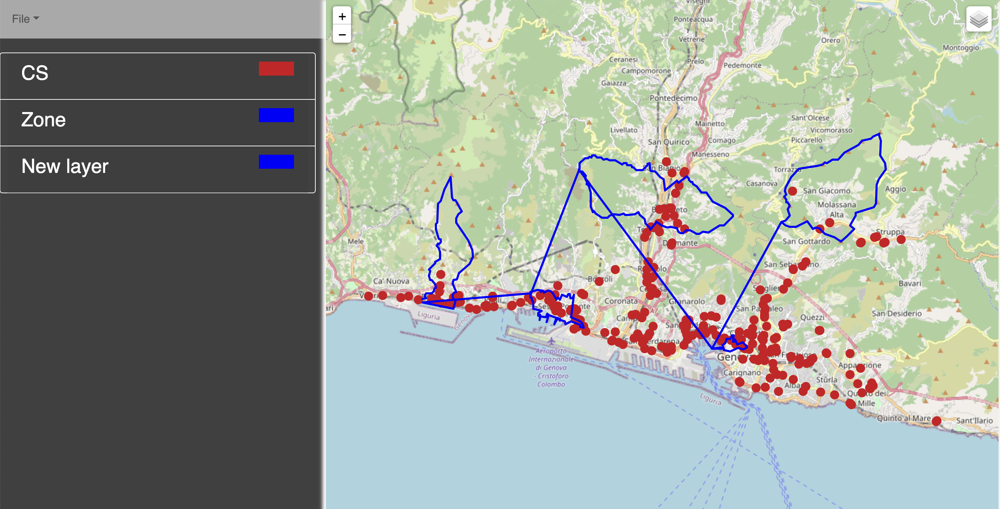

In [138]:
len(tot_results)

286

## Considero fascia_orarira = 1 (6:30-9:00)

Le labels nel database da considerare sono tutti i nodi con :aggregateArcCovering, mentre per le nuove stazioni sono da considerare i nodi con :newStation. I nodi che raggiungono le stazioni hanno le labels :reachable

In [148]:
tot_results = set()
model_num = 0
for index, row in df1.iterrows():
    subgraph_nodes = []
    # le liste nodi_origine e nodi_destinazione servono per inserire tutti i nodi che appartengono alla zona
    nodi_origine = []
    nodi_destinazione = []
    # Prendo nodo origine e destinazione dal dataframe
    name_origine = row['origine']
    name_destinazione = row['destinazione']
    
    pattern_o = re.compile(name_origine, re.IGNORECASE)
    pattern_d = re.compile(name_destinazione, re.IGNORECASE)
    
    # Prendo nel grafo tutti i nodi che appartengono alla zona di origine e tutti i nodi che appartengono alla zona
    # destinazione. Creo una lista per i nodi origine e destinazione.
    for node, attrs in G.nodes(data=True):
        if 'zona_di_appartenenza' in attrs and pattern_o.search(attrs['zona_di_appartenenza']):
            nodi_origine.append(node)
        if 'zona_di_appartenenza' in attrs and pattern_d.search(attrs['zona_di_appartenenza']):
            nodi_destinazione.append(node)
    
    
    calcola_shortest_path(name_origine,name_destinazione,nodi_origine,nodi_destinazione,subgraph_nodes)
    
    path_dict = dict()
    flows_dict = {}
    flusso_tot = []
    zone_att = []
    numPath = 0
    for i in subgraph_nodes:
        zone_att = set(calcolo_zone_attraversate(i))
        path_dict[numPath] = zone_att
     
        # CALCOLO FLUSSO PER LE ZONE CHE IL PATH ATTRAVERSA
        if len(zone_att) > 0:
            total_flow = calcolo_flusso(list(zone_att), flows_dict)
        if total_flow == 0:
            total_flow = 10
            
        flusso_tot.append(total_flow)
        #flow[numPath] = float(total_flow)
        
        numPath = numPath + 1
        
    unique_nodes = get_unique_nodes(subgraph_nodes)
    nodi_interi = []
    for n in unique_nodes:
        nodi_interi.append(int(n.replace("n",'')))
        
    tot_res = create_model(nodi_interi,subgraph_nodes,flusso_tot,model_num,tot_results)
    model_num = model_num + 1 
    
    tot_results.update(tot_res)
    
print("CHARGING STATION TO ACTIVATE: " + str(tot_results))

ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2945 rows, 358 columns and 33918 nonzeros
Model fingerprint: 0x920e8dcd
Variable types: 0 continuous, 358 integer (358 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2821 rows and 312 columns
Presolve time: 0.04s
Presolved: 124 rows, 46 columns, 455 nonzeros
Variable types: 0 continuous, 46 integer (44 binary)

Root relaxation: objective 3.708600e+03, 64 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 3708.60000    0   29   -0.00000 3708.60000      

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1267 rows and 77 columns
Presolve time: 0.02s
Presolved: 704 rows, 116 columns, 4505 nonzeros
Variable types: 0 continuous, 116 integer (94 binary)

Root relaxation: objective 1.012000e+03, 147 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 1012.00000    0   43   -0.00000 1012.00000      -     -    0s
     0     0  785.00000    0   33   -0.00000  785.00000      -     -    0s
     0     0  369.33333    0   35   -0.00000  369.33333      -     -    0s

Cutting planes:
  Gomory: 1

Explored 1 nodes (307 simplex iterations) in 0.07 seconds (0.09 work units)
Thread count was 8 (of 8 available processors)

Solution

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.04 seconds (0.08 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 12 RESULTS: [1216, 1321]
CS PRESENTE: 1216
CS PRESENTE: 1321
CS PRESENTE: 6325
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3414 rows, 273 columns and 30887 nonzeros
Model fingerprint: 0xc1aae13c
Variable types: 0 continuous, 273 integer (273 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3414 rows an


Optimize a model with 2282 rows, 237 columns and 19863 nonzeros
Model fingerprint: 0x97d28e1b
Variable types: 0 continuous, 237 integer (237 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2282 rows and 237 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 20 RESULTS: [4775]
CS PRESENTE: 4775
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimi

  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 881 rows and 35 columns
Presolve time: 0.01s
Presolved: 483 rows, 155 columns, 3152 nonzeros
Variable types: 0 continuous, 155 integer (148 binary)

Root relaxation: objective 1.782000e+03, 149 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 1782.00000    0   15   -0.00000 1782.00000      -     -    0s
H    0     0                    1188.0000000 1782.00000  50.0%     -    0s
     0     0 1544.40000    0   10 1188.00000 1544.40000  30.0%     -    0s
     0     0 1544.40000    0   14 1188.00000 1544.40000  30.0%     -    0s
     0     0     cutoff    0      1188.00000 1188.00000  0.00%     -    0s

Explored 1 nodes (274 simplex iterations) in 0.03 seconds (0.03 work units)
Thread count was 8 (of 8 av

     0     0  505.55556    0   27   -0.00000  505.55556      -     -    0s
     0     0  444.50000    0   19   -0.00000  444.50000      -     -    0s
     0     0  402.00000    0   21   -0.00000  402.00000      -     -    0s
     0     0  292.00000    0   16   -0.00000  292.00000      -     -    0s
     0     0  268.00000    0   15   -0.00000  268.00000      -     -    0s
     0     0  268.00000    0   15   -0.00000  268.00000      -     -    0s
     0     0  201.00000    0    8   -0.00000  201.00000      -     -    0s

Cutting planes:
  Mod-K: 8

Explored 1 nodes (387 simplex iterations) in 0.07 seconds (0.08 work units)
Thread count was 8 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 32 RESULTS: [1786, 1486]
CS PRESENTE: 1486
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CP

Presolve removed 2968 rows and 249 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 39 RESULTS: [6325, 1216, 409, 726, 1321]
CS PRESENTE: 1685
CS PRESENTE: 6239
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1941 rows, 213 columns and 18254 nonzeros
Model fingerprint: 0x780566ab
Variable types: 0 continuous, 213 integer (213 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristi

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1092 rows and 123 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 46 RESULTS: [3620]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1011 rows, 115 columns and 9010 nonzeros
Model fingerprint: 0x1b5392fa
Variable types: 0 continuous, 115 integer (115 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 5e+02]
  Bounds range     [1e+00,

CS PRESENTE: 2969
CS PRESENTE: 3620
CS PRESENTE: 4775
CS PRESENTE: 976
CS PRESENTE: 981
CS PRESENTE: 342
CS PRESENTE: 2527
CS PRESENTE: 6239
CS PRESENTE: 2532
CS PRESENTE: 2937
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4504 rows, 370 columns and 51065 nonzeros
Model fingerprint: 0x357ca0bb
Variable types: 0 continuous, 370 integer (370 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4504 rows and 370 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Opt

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 59 RESULTS: [2532, 2527]
CS PRESENTE: 3259
CS PRESENTE: 6653
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1752 rows, 200 columns and 17702 nonzeros
Model fingerprint: 0x463a7a45
Variable types: 0 continuous, 200 integer (200 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1752 rows and 200 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6452 rows and 289 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 67 RESULTS: [6325, 6653, 4775, 3259, 1531, 409, 679]
CS PRESENTE: 5195
CS PRESENTE: 1136
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1936 rows, 194 columns and 16711 nonzeros
Model fingerprint: 0x7624e6cc
Variable t

Found heuristic solution: objective -0.0000000
Presolve removed 5959 rows and 352 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 74 RESULTS: [6615, 6664, 2532, 2527]
CS PRESENTE: 6664
CS PRESENTE: 3259
CS PRESENTE: 2766
CS PRESENTE: 4713
CS PRESENTE: 6653
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4967 rows, 328 columns and 54181 nonzeros
Model fingerprint: 0xa53712a6
Variable types: 0 continuous, 328 integer (328 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 81 RESULTS: [6653, 3259]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 674 rows, 172 columns and 6116 nonzeros
Model fingerprint: 0x04f46e19
Variable types: 0 continuous, 172 integer (172 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 344 rows and 55 columns
Presolve time: 0.01s
Presolved: 330 rows, 117 columns, 2463 nonzeros
Variable types: 0 continuous, 117 integer (105 binary)

Root relaxation: objective 1.0257

Variable types: 0 continuous, 11 integer (10 binary)

Root relaxation: objective 5.200000e+02, 11 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0  520.00000    0    7  248.00000  520.00000   110%     -    0s
H    0     0                     390.0000000  520.00000  33.3%     -    0s

Cutting planes:
  Zero half: 1

Explored 1 nodes (11 simplex iterations) in 0.03 seconds (0.03 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 390 248 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 3.900000000000e+02, best bound 3.900000000000e+02, gap 0.0000%
MODEL COUNT: 88 RESULTS: [524, 506]
CS PRESENTE: 506
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a mode

Best objective 5.640000000000e+02, best bound 5.640000000000e+02, gap 0.0000%
MODEL COUNT: 94 RESULTS: [8557, 1987]
CS PRESENTE: 528
CS PRESENTE: 409
CS PRESENTE: 3259
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 613
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3548 rows, 203 columns and 36789 nonzeros
Model fingerprint: 0x90c6cf5b
Variable types: 0 continuous, 203 integer (203 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3548 rows and 203 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1:

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3805 rows and 265 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 102 RESULTS: [4775, 1531, 2937, 1543]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 4775
CS PRESENTE: 1531
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1119 rows, 221 columns and 11457 nonzeros
Model fingerprint: 

MODEL COUNT: 109 RESULTS: [3259, 1216, 2766, 679, 1321, 6664, 6653, 4713]
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1423 rows, 137 columns and 13154 nonzeros
Model fingerprint: 0x105eb864
Variable types: 0 continuous, 137 integer (137 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1423 rows and 137 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000

CS PRESENTE: 3083
CS PRESENTE: 1423
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 1531
CS PRESENTE: 6653
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2737 rows, 240 columns and 30096 nonzeros
Model fingerprint: 0x7578cb13
Variable types: 0 continuous, 240 integer (240 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2737 rows and 240 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.00000000000

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 125 RESULTS: [6653, 3259]
CS PRESENTE: 3620
CS PRESENTE: 711
CS PRESENTE: 342
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2240 rows, 226 columns and 27053 nonzeros
Model fingerprint: 0x150464a1
Variable types: 0 continuous, 226 integer (226 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2240 rows and 226 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal so


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 133 RESULTS: [1136, 651, 5195]
CS PRESENTE: 4884
CS PRESENTE: 5280
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1939 rows, 244 columns and 22324 nonzeros
Model fingerprint: 0x43dba4cd
Variable types: 0 continuous, 244 integer (244 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1939 rows and 244 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 141 RESULTS: [931, 651]
CS PRESENTE: 1543
CS PRESENTE: 1423
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 3396
CS PRESENTE: 2937
CS PRESENTE: 1531
CS PRESENTE: 6653
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 11497 rows, 351 columns and 123999 nonzeros
Model fingerprint: 0x8f6e5c87
Variable types: 0 continuous, 351 integer (351 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3026 rows, 230 columns and 34270 nonzeros
Model fingerprint: 0x4ada9e66
Variable types: 0 continuous, 230 integer (230 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3026 rows and 230 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 149 RESULTS: [6653, 4775, 3259, 1531, 1423]
CS PRESENTE: 1922
CS PRESENTE: 409
CS PRESENTE: 679
CS PRESENTE: 711
CS PRESENTE: 


Optimize a model with 647 rows, 101 columns and 5546 nonzeros
Model fingerprint: 0x5bf40937
Variable types: 0 continuous, 101 integer (101 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 647 rows and 101 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 156 RESULTS: [4225, 6325]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model wit

Model fingerprint: 0x4fded546
Variable types: 0 continuous, 91 integer (91 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 593 rows and 91 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 163 RESULTS: [1987]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 563 rows, 95 columns and 3902 nonzeros
Model fingerprint: 0x12469494
V


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 170 RESULTS: [6316, 651, 409, 528, 679, 613]
CS PRESENTE: 1321
CS PRESENTE: 1216
CS PRESENTE: 845
CS PRESENTE: 726
CS PRESENTE: 613
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2527 rows, 246 columns and 18705 nonzeros
Model fingerprint: 0xbdf4f478
Variable types: 0 continuous, 246 integer (246 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve remove

Model fingerprint: 0x704d72c6
Variable types: 0 continuous, 312 integer (312 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3324 rows and 312 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 178 RESULTS: [4713, 6664, 2766]
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 981
CS PRESENTE: 2937
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimi

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 185 RESULTS: [4775, 2937, 2969, 976]
CS PRESENTE: 1423
CS PRESENTE: 2969
CS PRESENTE: 4775
CS PRESENTE: 976
CS PRESENTE: 2937
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3146 rows, 197 columns and 38773 nonzeros
Model fingerprint: 0xe670fac5
Variable types: 0 continuous, 197 integer (197 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3146 rows and 197 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -


Optimize a model with 7463 rows, 339 columns and 77561 nonzeros
Model fingerprint: 0xe9b483d8
Variable types: 0 continuous, 339 integer (339 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 7463 rows and 339 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 193 RESULTS: [6653, 3259, 262, 409, 1423, 679]
CS PRESENTE: 1922
CS PRESENTE: 262
CS PRESENTE: 409
CS PRESENTE: 679
CS PRESENTE: 3259
CS PRESENTE: 6653
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[

  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 15228 rows and 483 columns
Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.03 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 200 RESULTS: [6316, 1531, 4884, 5280, 262, 1543, 342, 5985, 4775, 2532, 2527]
CS PRESENTE: 976
CS PRESENTE: 2937
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1728 rows, 177 columns and 20979 nonzeros
Model fingerprint: 0x4d9b4066
Variable types: 0 continuous, 177 integer (177 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3704 rows, 243 columns and 39888 nonzeros
Model fingerprint: 0xfc5497f8
Variable types: 0 continuous, 243 integer (243 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3704 rows and 243 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 208 RESULTS: [6653, 3259, 262, 5080, 1423]
CS PRESENTE: 524
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (m

MODEL COUNT: 215 RESULTS: [4713, 4775, 2766, 5080, 1423]
CS PRESENTE: 262
CS PRESENTE: 834
CS PRESENTE: 2766
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 4713
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2832 rows, 196 columns and 32442 nonzeros
Model fingerprint: 0x51f49025
Variable types: 0 continuous, 196 integer (196 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2832 rows and 196 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution f

  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4302 rows and 249 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 223 RESULTS: [4775, 262, 834, 2937, 2532, 976, 2527]
CS PRESENTE: 1423
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1374 rows, 173 columns and 15524 nonzeros
Model fingerprint: 0x3ca18010
Variable types: 0 continuous, 173 integer (173 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 5e+02]
  Bound

  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5423 rows and 358 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 230 RESULTS: [6664, 6829, 6828, 1423]
CS PRESENTE: 262
CS PRESENTE: 6664
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3023 rows, 268 columns and 35358 nonzeros
Model fingerprint: 0xaf1e7b40
Variable types: 0 continuous, 268 integer (268 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  O


Optimize a model with 1628 rows, 189 columns and 11719 nonzeros
Model fingerprint: 0xc9450392
Variable types: 0 continuous, 189 integer (189 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1628 rows and 189 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 238 RESULTS: [6664, 1987]
CS PRESENTE: 6664
CS PRESENTE: 1979
CS PRESENTE: 1982
CS PRESENTE: 8557
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physic


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1458 rows, 171 columns and 16667 nonzeros
Model fingerprint: 0xfc3bdfeb
Variable types: 0 continuous, 171 integer (171 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1458 rows and 171 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 245 RESULTS: [6316, 911, 912]
CS PRESENTE: 262
CS PRESENTE: 4775
CS PRESENTE: 976
CS PRESENTE: 342
CS PRESENTE: 2527
CS PRESEN

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 252 RESULTS: [2937, 2969, 976]
CS PRESENTE: 1543
CS PRESENTE: 6664
CS PRESENTE: 3083
CS PRESENTE: 6829
CS PRESENTE: 6828
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6142 rows, 324 columns and 53121 nonzeros
Model fingerprint: 0xbe0ff9d1
Variable types: 0 continuous, 324 integer (324 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6142 rows and 324 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5454 rows, 253 columns and 58670 nonzeros
Model fingerprint: 0x8832e38a
Variable types: 0 continuous, 253 integer (253 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5454 rows and 253 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 260 RESULTS: [4713, 4775, 981, 2937, 2969, 2766, 976]
CS PRESENTE: 1423
CS PRESENTE: 2969
CS PRESENTE: 4775
CS PRESENTE: 976
C

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1406 rows and 158 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 266 RESULTS: [8670, 7861]
CS PRESENTE: 6325
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1321
CS PRESENTE: 845
CS PRESENTE: 342
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5272 rows, 277 columns and 50217 nonzero


Optimize a model with 1781 rows, 192 columns and 20226 nonzeros
Model fingerprint: 0xd250179f
Variable types: 0 continuous, 192 integer (192 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1781 rows and 192 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 274 RESULTS: [342, 409, 3396, 679, 1486]
CS PRESENTE: 524
CS PRESENTE: 633
CS PRESENTE: 1216
CS PRESENTE: 711
CS PRESENTE: 726
CS PRESENTE: 1321
CS PRESENTE: 342
CS PRESENTE: 506
ACTIVATE CS= 8
Gurobi Optimizer version 10.0

  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1578 rows and 195 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 281 RESULTS: [6653, 4775, 3259, 981, 2937, 2969, 1423, 976]
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3844 rows, 231 columns and 36507 nonzeros
Model fingerprint: 0x3cdf903b
Variable types: 0 continuous, 231 integer (231 binary)
Coeffici


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3980 rows, 249 columns and 31399 nonzeros
Model fingerprint: 0x4d9e5345
Variable types: 0 continuous, 249 integer (249 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3980 rows and 249 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 289 RESULTS: [2392, 524, 2211, 262, 3396, 726, 506]
CS PRESENTE: 3083
CS PRESENTE: 5280
CS PRESENTE: 4775
CS PRESENTE: 3259
CS

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 296 RESULTS: [1531, 409, 4884, 5280, 3259, 262, 679, 6653, 3083, 1423, 4775]
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 6316
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 825 rows, 156 columns and 7277 nonzeros
Model fingerprint: 0x9d999884
Variable types: 0 continuous, 156 integer (156 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 825 rows and 156 columns
Presolve time: 0.00s
Presolve: All rows and columns r

Model fingerprint: 0x49626ad0
Variable types: 0 continuous, 196 integer (196 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1996 rows and 196 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 304 RESULTS: [6316, 342, 911, 711, 912]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1009 rows, 124 columns and 9420 nonzeros
Model

Variable types: 0 continuous, 501 integer (501 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 15855 rows and 501 columns
Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.03 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 311 RESULTS: [911, 3217, 976, 3259, 262, 2937, 1672, 6653, 651, 5985, 2969, 1423, 4775, 912]
CS PRESENTE: 4775
CS PRESENTE: 6316
CS PRESENTE: 262
CS PRESENTE: 342
CS PRESENTE: 5985
CS PRESENTE: 2937
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 

Presolve removed 3675 rows and 251 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 318 RESULTS: [6664, 6829, 4555, 6828, 5080, 2136]
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 8435
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 981
CS PRESENTE: 6653
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3700 rows, 255 columns and 41654 nonzeros
Model fingerprint: 0x7c53cd2f
Variable types: 0 continuous, 255 integer (255 binary)
Coefficient statistics:
  Matrix range   

     0     0  641.66667    0   29   -0.00000  641.66667      -     -    0s
     0     0  616.00000    0   30   -0.00000  616.00000      -     -    0s
     0     0  560.00000    0   33   -0.00000  560.00000      -     -    0s
     0     0  513.33333    0   32   -0.00000  513.33333      -     -    0s

Cutting planes:
  Gomory: 9
  Mod-K: 3

Explored 1 nodes (270 simplex iterations) in 0.06 seconds (0.07 work units)
Thread count was 8 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 325 RESULTS: [1463, 6809]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 746 rows, 117 columns and 6236 nonzeros
Model fingerprint: 0x416699fe
Variable types: 0 continuous, 117 integer (

Variable types: 0 continuous, 120 integer (120 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 530 rows and 120 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 332 RESULTS: [6829, 4555, 2136]
CS PRESENTE: 2575
CS PRESENTE: 2136
CS PRESENTE: 6829
CS PRESENTE: 6828
CS PRESENTE: 1423
CS PRESENTE: 3493
CS PRESENTE: 4555
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, usin

Model fingerprint: 0x5485319e
Variable types: 0 continuous, 365 integer (365 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 7665 rows and 365 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 339 RESULTS: [6316, 6615, 262, 6664, 651, 3493, 2773, 2532, 2575, 2527]
CS PRESENTE: 6239
CS PRESENTE: 1685
CS PRESENTE: 4775
CS PRESENTE: 8925
CS PRESENTE: 8435
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 981
ACTIVATE CS= 10
Gurobi Optimizer versi

Presolve removed 2576 rows and 242 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 346 RESULTS: [4775, 1531, 3083, 4884, 1423, 5280]
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 6316
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1225 rows, 182 columns and 9213 nonzeros
Model fingerprint: 0xa2a97c37
Variable types: 0 continuous, 182 integer (182 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+0


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1589 rows, 155 columns and 12713 nonzeros
Model fingerprint: 0x9f9becdd
Variable types: 0 continuous, 155 integer (155 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1589 rows and 155 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 354 RESULTS: [6325, 4502, 1216, 3396, 679, 726, 1188, 1321]
CS PRESENTE: 524
CS PRESENTE: 1188
CS PRESENTE: 679
CS PRESENTE: 1

MODEL COUNT: 361 RESULTS: [651]
CS PRESENTE: 2575
CS PRESENTE: 1423
CS PRESENTE: 1439
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1288 rows, 239 columns and 14423 nonzeros
Model fingerprint: 0xa997b5f3
Variable types: 0 continuous, 239 integer (239 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+01, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective 91.0000000
Presolve removed 1288 rows and 239 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: 91 

Optimal solution found (tolerance 1.00e-04)
Best objective 9.100000000000e+01, best bound 9.100000000000e+01, gap 0.0000%
MODEL C

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1480 rows and 194 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 369 RESULTS: [6664, 2773]
CS PRESENTE: 6664
CS PRESENTE: 2773
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1685 rows, 198 columns and 14357 nonzeros
Model fingerprint: 0xd9cff48e
Variable types: 0 continuous, 198 int


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1047 rows, 270 columns and 11252 nonzeros
Model fingerprint: 0x5ab27030
Variable types: 0 continuous, 270 integer (270 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1047 rows and 270 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 377 RESULTS: [3204, 342, 3203, 262, 911, 3620, 711, 912]
CS PRESENTE: 262
CS PRESENTE: 834
ACTIVATE CS= 2
Gurobi Optimizer ver


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 8432 rows, 369 columns and 101035 nonzeros
Model fingerprint: 0x87d8683e
Variable types: 0 continuous, 369 integer (369 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 8432 rows and 369 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 384 RESULTS: [6316, 911, 1531, 262, 1543, 342, 4775, 2532, 912, 2527]
CS PRESENTE: 651
CS PRESENTE: 4775
CS PRESENTE: 6316
CS

Model fingerprint: 0xa16d8b26
Variable types: 0 continuous, 172 integer (172 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2073 rows and 172 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 391 RESULTS: [4775, 1531, 1543]
CS PRESENTE: 2575
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 1216
CS PRESENTE: 262
CS PRESENTE: 1321
CS PRESENTE: 845
CS PRESENTE: 3493
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1r


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 398 RESULTS: [8670, 633, 7861]
CS PRESENTE: 2575
CS PRESENTE: 3259
CS PRESENTE: 1786
CS PRESENTE: 262
CS PRESENTE: 1439
CS PRESENTE: 6653
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1076 rows, 193 columns and 11011 nonzeros
Model fingerprint: 0xcb2d170a
Variable types: 0 continuous, 193 integer (193 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1076 rows and 193 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex

Found heuristic solution: objective -0.0000000
Presolve removed 2637 rows and 160 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 406 RESULTS: [8435, 981, 8925, 2969]
CS PRESENTE: 6664
CS PRESENTE: 2136
CS PRESENTE: 6829
CS PRESENTE: 2773
CS PRESENTE: 4555
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 806 rows, 149 columns and 7287 nonzeros
Model fingerprint: 0x98c4f554
Variable types: 0 continuous, 149 integer (149 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8

Variable types: 0 continuous, 142 integer (142 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 631 rows and 142 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 414 RESULTS: [3396, 679]
CS PRESENTE: 679
CS PRESENTE: 845
CS PRESENTE: 2423
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 984 rows, 134 columns and 9447 nonzeros



CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2091 rows, 213 columns and 19833 nonzeros
Model fingerprint: 0x98217599
Variable types: 0 continuous, 213 integer (213 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2091 rows and 213 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 421 RESULTS: [845, 342, 931, 1922, 1216, 610, 381, 726, 613, 1321]
CS PRESENTE: 633
CS PRESENTE: 726
CS PRESENTE: 1922
ACTIVAT

  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1128 rows and 154 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 428 RESULTS: [6653, 4775, 3259, 1531, 3083, 1423]
CS PRESENTE: 1543
CS PRESENTE: 4775
CS PRESENTE: 262
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 1531
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5021 rows, 249 columns and 56979 nonzeros
Model fingerprint: 0x42c14888
Variable types: 0 continuous, 249 integer (249 binary)
Coefficient s

MODEL COUNT: 435 RESULTS: [1786, 1486]
CS PRESENTE: 651
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 1531
CS PRESENTE: 6653
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5346 rows, 360 columns and 56551 nonzeros
Model fingerprint: 0x464d31ea
Variable types: 0 continuous, 360 integer (360 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5346 rows and 360 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 


Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 9644 rows and 392 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 443 RESULTS: [911, 3620, 976, 262, 2937, 342, 2969, 4775, 2532, 912, 2527]
CS PRESENTE: 2575
CS PRESENTE: 3620
CS PRESENTE: 262
CS PRESENTE: 342
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 3493
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 log

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 450 RESULTS: [633, 524, 651, 1922, 726, 506]
CS PRESENTE: 409
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 907 rows, 111 columns and 9059 nonzeros
Model fingerprint: 0xe8c6b64c
Variable types: 0 continuous, 111 integer (111 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 907 rows and 111 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2154 rows, 258 columns and 24917 nonzeros
Model fingerprint: 0xea5c82f8
Variable types: 0 continuous, 258 integer (258 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2154 rows and 258 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 458 RESULTS: [8435, 6239, 6653, 4775, 3259, 981, 8925, 2937, 2969, 1423, 976]
CS PRESENTE: 3620
CS PRESENTE: 610
CS PRESENTE: 

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 465 RESULTS: [6316, 651, 262, 2532, 2527]
CS PRESENTE: 3620
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 679
CS PRESENTE: 711
CS PRESENTE: 342
CS PRESENTE: 409
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1522 rows, 202 columns and 17663 nonzeros
Model fingerprint: 0xc8288247
Variable types: 0 continuous, 202 integer (202 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 472 RESULTS: [6653, 3259, 262, 3493, 1987]
CS PRESENTE: 3203
CS PRESENTE: 3204
CS PRESENTE: 711
CS PRESENTE: 342
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 897 rows, 145 columns and 8322 nonzeros
Model fingerprint: 0xee657cad
Variable types: 0 continuous, 145 integer (145 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 897 rows and 145 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1981 rows and 169 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 479 RESULTS: [633, 1343, 2422, 726]
CS PRESENTE: 726
CS PRESENTE: 2422
CS PRESENTE: 2423
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1675 rows, 168 columns and 12338 nonzeros
Model fingerprint: 0x87b829b2
Variable types: 0 continuous, 168 integer (168 binary)
Coefficient statistics:
  Matrix range     [1e+

Presolve removed 5203 rows and 287 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 486 RESULTS: [4502, 6653, 3259, 262, 3396, 5080, 1423, 1188, 506]
CS PRESENTE: 651
CS PRESENTE: 1373
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 971 rows, 130 columns and 7252 nonzeros
Model fingerprint: 0x78aa1911
Variable types: 0 continuous, 130 integer (130 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00,

Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 493 RESULTS: [6316, 342, 262, 911, 2532, 912, 2527]
CS PRESENTE: 3203
CS PRESENTE: 3204
CS PRESENTE: 6316
CS PRESENTE: 262
CS PRESENTE: 342
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 2475
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1298 rows, 288 columns and 12512 nonzeros
Model fingerprint: 0x81db0d6e
Variable types: 0 continuous, 288 integer (288 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objec

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 500 RESULTS: [1672, 1136]
CS PRESENTE: 1672
CS PRESENTE: 3217
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1452 rows, 167 columns and 13748 nonzeros
Model fingerprint: 0xe8062bd4
Variable types: 0 continuous, 167 integer (167 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1452 rows and 167 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (to

Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5644 rows, 298 columns and 65469 nonzeros
Model fingerprint: 0xb3e253e9
Variable types: 0 continuous, 298 integer (298 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5644 rows and 298 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 508 RESULTS: [342, 3203, 262, 3493, 2773, 2532, 2575, 711, 2527]
CS PRESENTE: 4713
CS PRESENTE: 2766
CS PRESENTE: 2773
CS PRESENTE: 3493
ACTIVATE C


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 515 RESULTS: [6653, 3259, 3493, 2575]
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 679
CS PRESENTE: 6316
CS PRESENTE: 711
CS PRESENTE: 342
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 409
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4648 rows, 282 columns and 52759 nonzeros
Model fingerprint: 0x381ad3a6
Variable types: 0 continuous, 282 integer (282 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Fo

MODEL COUNT: 522 RESULTS: [1672, 651, 5985, 911, 3217, 912]
CS PRESENTE: 2575
CS PRESENTE: 2136
CS PRESENTE: 679
CS PRESENTE: 262
CS PRESENTE: 845
CS PRESENTE: 1423
CS PRESENTE: 409
CS PRESENTE: 3493
CS PRESENTE: 4555
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3832 rows, 306 columns and 42972 nonzeros
Model fingerprint: 0xab645efe
Variable types: 0 continuous, 306 integer (306 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3832 rows and 306 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 availa

CS PRESENTE: 6664
CS PRESENTE: 4713
CS PRESENTE: 3259
CS PRESENTE: 2766
CS PRESENTE: 2773
CS PRESENTE: 3493
CS PRESENTE: 6653
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4467 rows, 265 columns and 47741 nonzeros
Model fingerprint: 0xf221e1d2
Variable types: 0 continuous, 265 integer (265 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4467 rows and 265 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best object

Model fingerprint: 0x1fcf831b
Variable types: 0 continuous, 88 integer (88 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 368 rows and 88 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 537 RESULTS: [679, 845, 381, 409]
CS PRESENTE: 1343
CS PRESENTE: 342
CS PRESENTE: 381
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1394


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1083 rows, 151 columns and 7269 nonzeros
Model fingerprint: 0xce630fea
Variable types: 0 continuous, 151 integer (151 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1083 rows and 151 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 545 RESULTS: [4502, 726, 1188, 506]
CS PRESENTE: 633
CS PRESENTE: 1216
CS PRESENTE: 711
CS PRESENTE: 726
CS PRESENTE: 1321
CS P


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5870 rows, 280 columns and 63301 nonzeros
Model fingerprint: 0x6d2dec73
Variable types: 0 continuous, 280 integer (280 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5870 rows and 280 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 552 RESULTS: [845, 342, 6325, 911, 1216, 409, 912, 726, 1321]
CS PRESENTE: 1094
CS PRESENTE: 651
CS PRESENTE: 262
CS PRESENTE:


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 559 RESULTS: [1373]
CS PRESENTE: 931
CS PRESENTE: 2475
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1050 rows, 157 columns and 10256 nonzeros
Model fingerprint: 0xd2c3608e
Variable types: 0 continuous, 157 integer (157 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1050 rows and 157 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available p


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 13659 rows, 416 columns and 151682 nonzeros
Model fingerprint: 0x81ea413f
Variable types: 0 continuous, 416 integer (416 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 13659 rows and 416 columns
Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.03 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 567 RESULTS: [6239, 976, 2937, 8435, 981, 8925, 2969, 4775, 2532, 2527]
CS PRESENTE: 6239
CS PRESENTE: 610
CS PRESENTE: 613

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 573 RESULTS: [6316, 342, 1343, 911, 610, 381, 912, 613]
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 1188
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1321
CS PRESENTE: 845
CS PRESENTE: 342
CS PRESENTE: 1922
CS PRESENTE: 4502
CS PRESENTE: 931
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2322 rows, 188 columns and 21719 nonzeros
Model fingerprint: 0xd3dc71d7
Variable types: 0 continuous, 188 integer (188 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solu

MODEL COUNT: 580 RESULTS: [3204, 6316, 342, 651, 3203, 610, 409, 711, 613]
CS PRESENTE: 3620
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 3203
CS PRESENTE: 3204
CS PRESENTE: 711
CS PRESENTE: 342
CS PRESENTE: 409
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1079 rows, 167 columns and 9546 nonzeros
Model fingerprint: 0x3e9dac1f
Variable types: 0 continuous, 167 integer (167 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1079 rows and 167 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No 

Variable types: 0 continuous, 334 integer (334 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6172 rows and 334 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 588 RESULTS: [6316, 342, 911, 711, 912]
CS PRESENTE: 1672
CS PRESENTE: 651
CS PRESENTE: 3217
CS PRESENTE: 711
CS PRESENTE: 1786
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors,

Found heuristic solution: objective -0.0000000
Presolve removed 4736 rows and 290 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 595 RESULTS: [493, 4775, 981, 262, 2937, 2969, 2532, 3396, 976, 2527]
CS PRESENTE: 2575
CS PRESENTE: 2773
CS PRESENTE: 1423
CS PRESENTE: 3493
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2024 rows, 239 columns and 23557 nonzeros
Model fingerprint: 0x727fded2
Variable types: 0 continuous, 239 integer (239 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Ob

MODEL COUNT: 602 RESULTS: [845, 633, 1094, 262, 3493, 2532, 3396, 2575, 1423, 679, 2527]
CS PRESENTE: 554
CS PRESENTE: 262
CS PRESENTE: 2475
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2862 rows, 243 columns and 28608 nonzeros
Model fingerprint: 0x80ee5008
Variable types: 0 continuous, 243 integer (243 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2862 rows and 243 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions bet


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2221 rows, 245 columns and 20888 nonzeros
Model fingerprint: 0x5d631eee
Variable types: 0 continuous, 245 integer (245 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2221 rows and 245 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 610 RESULTS: [6325, 6653, 3259, 1094, 262, 1216, 3493, 3396, 679, 726, 1321]
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 3


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7277 rows, 319 columns and 86115 nonzeros
Model fingerprint: 0x0ad177d3
Variable types: 0 continuous, 319 integer (319 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 7277 rows and 319 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 617 RESULTS: [4775, 1531, 2527, 1543]
CS PRESENTE: 2136
CS PRESENTE: 2773
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build

MODEL COUNT: 624 RESULTS: [6653, 4775, 3259, 1531, 2937, 1423]
CS PRESENTE: 3620
CS PRESENTE: 262
CS PRESENTE: 342
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4547 rows, 283 columns and 50236 nonzeros
Model fingerprint: 0xab2be587
Variable types: 0 continuous, 283 integer (283 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4547 rows and 283 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solut

Variable types: 0 continuous, 177 integer (177 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1008 rows and 177 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 632 RESULTS: [3083]
CS PRESENTE: 6664
CS PRESENTE: 4713
CS PRESENTE: 2766
CS PRESENTE: 2773
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1909 rows, 190 columns a


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6336 rows, 289 columns and 74313 nonzeros
Model fingerprint: 0x2dc5f332
Variable types: 0 continuous, 289 integer (289 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6336 rows and 289 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 640 RESULTS: [6653, 4775, 3259, 1094, 262, 1531, 2937, 409, 1423, 679]
CS PRESENTE: 1343
CS PRESENTE: 409
ACTIVATE CS= 2
Gurob

  Objective range  [6e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1270 rows and 187 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 647 RESULTS: [6325, 1321, 1216, 834, 3396, 726]
CS PRESENTE: 6325
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1321
CS PRESENTE: 3396
CS PRESENTE: 2475
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1222 rows, 191 columns and 12737 nonzeros
Model fingerprint: 0xfcf639c1
Va


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1790 rows, 154 columns and 21564 nonzeros
Model fingerprint: 0x1230d75e
Variable types: 0 continuous, 154 integer (154 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1790 rows and 154 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 655 RESULTS: [3162, 3493, 2532, 2575, 2527]
CS PRESENTE: 2575
CS PRESENTE: 2773
CS PRESENTE: 3493
CS PRESENTE: 2527
ACTIVATE C

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2597 rows and 251 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 662 RESULTS: [4713, 6664, 6829, 6828, 3493, 2773, 2766]
CS PRESENTE: 2575
CS PRESENTE: 1423
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2211 rows, 188 columns and 22736 nonzeros
M


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 669 RESULTS: [2392, 6653, 2211, 3259, 3493]
CS PRESENTE: 554
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRESENTE: 976
CS PRESENTE: 6653
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2135 rows, 220 columns and 23557 nonzeros
Model fingerprint: 0x8e06906f
Variable types: 0 continuous, 220 integer (220 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2135 rows and 220 columns
Presolve time: 0.00s
Presolve: All rows and columns remove


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7031 rows, 273 columns and 75007 nonzeros
Model fingerprint: 0xb81870e9
Variable types: 0 continuous, 273 integer (273 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 7031 rows and 273 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 677 RESULTS: [524, 4775, 262, 1531, 3083, 2532, 3396, 2527, 1543, 726]
CS PRESENTE: 2575
CS PRESENTE: 1094
CS PRESENTE: 633
CS

Presolve removed 2628 rows and 208 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 684 RESULTS: [1323, 1324, 506]
CS PRESENTE: 651
CS PRESENTE: 1373
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 530 rows, 90 columns and 5197 nonzeros
Model fingerprint: 0x3e98da67
Variable types: 0 continuous, 90 integer (90 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: obje


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1211 rows, 154 columns and 8907 nonzeros
Model fingerprint: 0xce890b48
Variable types: 0 continuous, 154 integer (154 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1211 rows and 154 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 692 RESULTS: [4502, 524, 1188, 506]
CS PRESENTE: 1188
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 3396
CS

Model fingerprint: 0x46a0ba6b
Variable types: 0 continuous, 409 integer (409 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+01, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6204 rows and 409 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 699 RESULTS: [845, 409, 6615, 262, 1216, 679, 1321, 6325, 6664, 1094, 3493, 493, 2773, 2532, 2575, 2527]
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 262
CS PRESENTE: 1373
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1

Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 706 RESULTS: [8435, 6829, 981, 8925, 2937, 2969, 976]
CS PRESENTE: 2575
CS PRESENTE: 554
CS PRESENTE: 3203
CS PRESENTE: 3204
CS PRESENTE: 262
CS PRESENTE: 342
CS PRESENTE: 2475
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5015 rows, 290 columns and 52067 nonzeros
Model fingerprint: 0x1aff0cfd
Variable types: 0 continuous, 290 integer (290 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Obj

MODEL COUNT: 713 RESULTS: [6653, 4775, 3259, 262, 1531, 3083, 3396, 1423]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 4775
CS PRESENTE: 726
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 1423
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 1531
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6794 rows, 355 columns and 70884 nonzeros
Model fingerprint: 0x3f7c8a1c
Variable types: 0 continuous, 355 integer (355 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6794 rows and 355 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 availabl

CS PRESENTE: 1094
CS PRESENTE: 610
CS PRESENTE: 679
CS PRESENTE: 1860
CS PRESENTE: 409
CS PRESENTE: 493
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2385 rows, 221 columns and 22622 nonzeros
Model fingerprint: 0xc118392a
Variable types: 0 continuous, 221 integer (221 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2385 rows and 221 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+0


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 728 RESULTS: [6653, 3259, 262, 554, 2532, 2527]
CS PRESENTE: 554
CS PRESENTE: 3259
CS PRESENTE: 6653
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 510 rows, 90 columns and 4210 nonzeros
Model fingerprint: 0xdc395329
Variable types: 0 continuous, 90 integer (90 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 510 rows and 90 columns
Presolve t


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2844 rows, 161 columns and 30924 nonzeros
Model fingerprint: 0x240ff7f9
Variable types: 0 continuous, 161 integer (161 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2844 rows and 161 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 736 RESULTS: [6325, 1094, 262, 3493, 2532, 2575, 679, 2527]
CS PRESENTE: 2575
CS PRESENTE: 2195
CS PRESENTE: 262
CS PRESENTE: 

Model fingerprint: 0x81708906
Variable types: 0 continuous, 179 integer (179 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2315 rows and 179 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 743 RESULTS: [6325, 6653, 3259, 1094, 262, 409, 3396, 381, 679]
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 6325
CS PRESENTE: 1216
CS PRESENTE: 262
CS PRESENTE: 3396
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 750 RESULTS: [493, 6316, 651, 1094]
CS PRESENTE: 3204
CS PRESENTE: 1786
CS PRESENTE: 1343
CS PRESENTE: 342
CS PRESENTE: 1486
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1108 rows, 146 columns and 10351 nonzeros
Model fingerprint: 0xf9bfbf48
Variable types: 0 continuous, 146 integer (146 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heu


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 757 RESULTS: [493, 1860, 610, 409, 3620, 1463, 613]
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 409
CS PRESENTE: 1463
CS PRESENTE: 493
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1102 rows, 180 columns and 10470 nonzeros
Model fingerprint: 0xf020c750
Variable types: 0 continuous, 180 integer (180 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1102 rows and 180 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simple

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6205 rows, 316 columns and 70087 nonzeros
Model fingerprint: 0x4f25894a
Variable types: 0 continuous, 316 integer (316 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6205 rows and 316 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 765 RESULTS: [6653, 4775, 3259, 1531, 2937, 3083, 1423, 976

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2249 rows and 206 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 772 RESULTS: [493, 6316, 1860, 610, 409, 1463, 679, 613]
CS PRESENTE: 6239
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 8925
CS PRESENTE: 8435
CS PRESENTE: 262
CS PRESENTE: 834
CS PRESENTE: 3396
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 981
CS PRESENTE: 6653
ACTIVATE CS= 14
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (ma

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 779 RESULTS: [524]
CS PRESENTE: 1094
CS PRESENTE: 6809
CS PRESENTE: 679
CS PRESENTE: 262
CS PRESENTE: 2392
CS PRESENTE: 1922
CS PRESENTE: 409
CS PRESENTE: 493
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1769 rows, 194 columns and 15187 nonzeros
Model fingerprint: 0x4e8efec6
Variable types: 0 continuous, 194 integer (194 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1769 rows and 194 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 786 RESULTS: [1343, 381, 2475]
CS PRESENTE: 633
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1343
CS PRESENTE: 845
CS PRESENTE: 2422
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 717 rows, 127 columns and 5562 nonzeros
Model fingerprint: 0x3bd4dfd7
Variable types: 0 continuous, 127 integer (127 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 717 rows and 127 columns
Presolve time: 0.00s
Presolve: All rows and co

Model fingerprint: 0x94d9e6b4
Variable types: 0 continuous, 165 integer (165 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1181 rows and 165 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 794 RESULTS: [1373, 931]
CS PRESENTE: 3083
CS PRESENTE: 1094
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 1922
CS PRESENTE: 1423
CS PRESENTE: 493
CS PRESENTE: 1531
CS PRESENTE: 6653
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

C

  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4485 rows and 211 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 801 RESULTS: [633, 524, 651, 726, 506]
CS PRESENTE: 2575
CS PRESENTE: 4775
CS PRESENTE: 2937
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 981
CS PRESENTE: 2527
CS PRESENTE: 3047
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3904 rows, 283 columns and 45786 nonzeros
Model fingerprint: 0x4dc2a1ae
Variable types: 0 continuous, 283 integer (2

  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3229 rows and 227 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 808 RESULTS: [6653, 4775, 3259, 981, 2937, 2969, 1423, 976]
CS PRESENTE: 3620
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 262
CS PRESENTE: 1373
CS PRESENTE: 493
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2157 rows, 169 columns and 22580 nonzeros
Model fingerprint: 0x2

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 815 RESULTS: [6239, 976, 262, 2937, 342, 8435, 981, 8925, 2969, 493, 4775, 554, 2532, 2527, 2475]
CS PRESENTE: 2773
CS PRESENTE: 3493
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1042 rows, 256 columns and 9443 nonzeros
Model fingerprint: 0x57e22d2f
Variable types: 0 continuous, 256 integer (256 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1042 rows and 256 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex itera

Model fingerprint: 0x5d7c90ed
Variable types: 0 continuous, 110 integer (110 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+01, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 526 rows and 110 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 823 RESULTS: [1786, 1486]
CS PRESENTE: 2575
CS PRESENTE: 1423
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a mo


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 830 RESULTS: [6829, 4555, 6828, 2136]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 1094
CS PRESENTE: 4775
CS PRESENTE: 679
CS PRESENTE: 6325
CS PRESENTE: 262
CS PRESENTE: 1423
CS PRESENTE: 409
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
CS PRESENTE: 1531
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3074 rows, 289 columns and 31657 nonzeros
Model fingerprint: 0x2c674f9d
Variable types: 0 continuous, 289 integer (289 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1380 rows, 121 columns and 11095 nonzeros
Model fingerprint: 0x6dd87e2b
Variable types: 0 continuous, 121 integer (121 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1380 rows and 121 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 838 RESULTS: [6829, 4555, 6828, 2136]
CS PRESENTE: 6664
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64

CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 981
CS PRESENTE: 3047
CS PRESENTE: 6653
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2653 rows, 237 columns and 30735 nonzeros
Model fingerprint: 0xd58639c7
Variable types: 0 continuous, 237 integer (237 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2653 rows and 237 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Opt

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 853 RESULTS: [1373, 6316, 651]
CS PRESENTE: 610
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1268 rows, 156 columns and 13847 nonzeros
Model fingerprint: 0x87de75f5
Variable types: 0 continuous, 156 integer (156 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1268 rows and 156 colu


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 860 RESULTS: [4775, 262, 1531, 2532, 2527, 1543]
CS PRESENTE: 1147
CS PRESENTE: 6316
CS PRESENTE: 262
CS PRESENTE: 342
CS PRESENTE: 1423
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9739 rows, 416 columns and 95050 nonzeros
Model fingerprint: 0x18c262f8
Variable types: 0 continuous, 416 integer (416 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 9739 rows and 416 columns
Presolve time: 0.01s
Presolve: All rows and columns remove

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 867 RESULTS: [3785]
CS PRESENTE: 2575
CS PRESENTE: 1094
CS PRESENTE: 1147
CS PRESENTE: 1672
CS PRESENTE: 651
CS PRESENTE: 3217
CS PRESENTE: 3259
CS PRESENTE: 3785
CS PRESENTE: 262
CS PRESENTE: 5985
CS PRESENTE: 1423
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 5080
CS PRESENTE: 493
CS PRESENTE: 6653
ACTIVATE CS= 16
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9717 rows, 467 columns and 89931 nonzeros
Model fingerprint: 0x69ad7ffa
Variable types: 0 continuous, 467 integer (46


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 890 rows, 146 columns and 6589 nonzeros
Model fingerprint: 0xe483eed6
Variable types: 0 continuous, 146 integer (146 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 890 rows and 146 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 875 RESULTS: [2969]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 2136
CS PRESENTE: 6829
CS PRESENTE: 6828
CS PRESENTE: 2937
C

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 7524 rows and 303 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 882 RESULTS: [493, 5531, 6653, 4775, 3259, 1094, 262, 834, 2937, 1423, 976]
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 6325
CS PRESENTE: 845
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 715 rows, 94 columns and 6248 nonzeros
Model fingerprint: 0x89c925ae
Variable types: 0 continuous, 94 integer (94 bin


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 889 RESULTS: [2392, 2211, 262, 2532, 2527]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 662 rows, 107 columns and 4025 nonzeros
Model fingerprint: 0xa1c437c3
Variable types: 0 continuous, 107 integer (107 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 662 rows and 107 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Exp

Optimize a model with 641 rows, 101 columns and 7001 nonzeros
Model fingerprint: 0xdfd14855
Variable types: 0 continuous, 101 integer (101 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 641 rows and 101 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 897 RESULTS: [493, 1860, 554, 1463]
CS PRESENTE: 1860
CS PRESENTE: 1463
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 904 RESULTS: [2392, 1860, 2211, 6809, 506]
CS PRESENTE: 3203
CS PRESENTE: 3204
CS PRESENTE: 6316
CS PRESENTE: 711
CS PRESENTE: 342
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2136 rows, 213 columns and 17424 nonzeros
Model fingerprint: 0x8535f1ae
Variable types: 0 continuous, 213 integer (213 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2136 rows and 213 columns
Presolve time:

  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1856 rows and 144 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 912 RESULTS: [506]
CS PRESENTE: 3620
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1321
CS PRESENTE: 845
CS PRESENTE: 1373
CS PRESENTE: 506
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5112 rows, 267 columns and 50391 nonzeros
Model fingerprint: 0x3ed718c9
Variable type

No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 919 RESULTS: [931, 1922, 3620]
CS PRESENTE: 3204
CS PRESENTE: 1786
CS PRESENTE: 931
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 610 rows, 139 columns and 6039 nonzeros
Model fingerprint: 0x1178fef1
Variable types: 0 continuous, 139 integer (139 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 610 rows and 139 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 availabl

CS PRESENTE: 1543
CS PRESENTE: 2211
CS PRESENTE: 4775
CS PRESENTE: 1423
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 1531
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2648 rows, 240 columns and 29347 nonzeros
Model fingerprint: 0xe79157de
Variable types: 0 continuous, 240 integer (240 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2648 rows and 240 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best object

  Objective range  [5e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1580 rows and 312 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 934 RESULTS: [6316, 493, 342, 262, 911, 2532, 711, 912, 2527, 1147]
CS PRESENTE: 6809
CS PRESENTE: 2211
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 1860
CS PRESENTE: 2392
CS PRESENTE: 1463
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 891 rows, 160 columns and 6431 nonze


Optimize a model with 1591 rows, 177 columns and 17912 nonzeros
Model fingerprint: 0x2d64a241
Variable types: 0 continuous, 177 integer (177 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1591 rows and 177 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 941 RESULTS: [2392, 2211, 262, 2532, 3396, 1423, 2527]
CS PRESENTE: 554
CS PRESENTE: 6239
CS PRESENTE: 1685
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 8925
CS PRESENTE: 8435
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRES

Presolve removed 719 rows and 86 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 948 RESULTS: [679, 409, 931]
CS PRESENTE: 6239
CS PRESENTE: 1685
CS PRESENTE: 4775
CS PRESENTE: 8925
CS PRESENTE: 8435
CS PRESENTE: 2937
CS PRESENTE: 2969
CS PRESENTE: 976
CS PRESENTE: 981
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6550 rows, 307 columns and 64865 nonzeros
Model fingerprint: 0x210b5dae
Variable types: 0 continuous, 307 integer (307 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Obje


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2145 rows, 308 columns and 17719 nonzeros
Model fingerprint: 0x43991207
Variable types: 0 continuous, 308 integer (308 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2145 rows and 308 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 956 RESULTS: [3785, 1786, 1672, 493, 651, 5985, 1094, 911, 3956, 3217, 912, 1147]
CS PRESENTE: 6239
CS PRESENTE: 8925
ACTIVATE

Presolve removed 4822 rows and 302 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 963 RESULTS: [1373, 493, 6316, 651, 262, 3620, 3493, 2773, 2532, 2575, 2527]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 771 rows, 96 columns and 4436 nonzeros
Model fingerprint: 0xde809588
Variable types: 0 continuous, 96 integer (96 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic sol


Optimize a model with 3449 rows, 264 columns and 41108 nonzeros
Model fingerprint: 0x01bfe6c4
Variable types: 0 continuous, 264 integer (264 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3449 rows and 264 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 971 RESULTS: [3493, 2773, 1423]
CS PRESENTE: 2575
CS PRESENTE: 4713
CS PRESENTE: 2192
CS PRESENTE: 2766
CS PRESENTE: 2773
CS PRESENTE: 3493
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])



Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 978 RESULTS: [262, 834, 2532, 2575, 2527]
CS PRESENTE: 2575
CS PRESENTE: 1094
CS PRESENTE: 262
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1501 rows, 129 columns and 14744 nonzeros
Model fingerprint: 0xdce1e9e2
Variable types: 0 continuous, 129 integer (129 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 596 rows and 122 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 986 RESULTS: [6653, 3259, 262, 834, 554, 2575, 1423]
CS PRESENTE: 554
CS PRESENTE: 726
CS PRESENTE: 834
CS PRESENTE: 3396
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1303 rows, 158 columns and 11455 nonzeros
Model fi


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2322 rows, 224 columns and 23326 nonzeros
Model fingerprint: 0x6e649798
Variable types: 0 continuous, 224 integer (224 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2322 rows and 224 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 994 RESULTS: [6316, 931, 1136, 911, 610, 5195, 912, 613]
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 3259
CS PRESENTE: 262


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1918 rows, 277 columns and 18747 nonzeros
Model fingerprint: 0x94599d18
Variable types: 0 continuous, 277 integer (277 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1918 rows and 277 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1001 RESULTS: [1786, 493, 931, 651, 1094, 911, 409, 679, 912]
CS PRESENTE: 5195
CS PRESENTE: 1136
CS PRESENTE: 651
CS PRESENTE

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4492 rows and 267 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1008 RESULTS: [493, 342, 6829, 262, 1922, 4555, 3493, 2532, 2575, 2136, 2527]
CS PRESENTE: 1672
CS PRESENTE: 3956
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2333 rows, 176 columns and 14968 nonzeros
Model fingerpri


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1403 rows, 208 columns and 14039 nonzeros
Model fingerprint: 0xdd2a64ca
Variable types: 0 continuous, 208 integer (208 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1403 rows and 208 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1016 RESULTS: [6653, 3259, 262, 834, 554, 2575, 1423]
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 2475
ACTIVATE CS= 3
Guro

  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4518 rows and 295 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1023 RESULTS: [493, 6316, 342, 262, 911, 3162, 3493, 2532, 2575, 2766, 912, 2527]
CS PRESENTE: 6664
CS PRESENTE: 2575
CS PRESENTE: 262
CS PRESENTE: 3493
CS PRESENTE: 6615
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 11097 rows, 378 columns and 128090 nonzeros
Model fingerprint: 0xda902541

MODEL COUNT: 1030 RESULTS: [2392, 2211, 554, 2532, 2527]
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 262
CS PRESENTE: 2885
CS PRESENTE: 409
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
CS PRESENTE: 2541
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5636 rows, 277 columns and 55552 nonzeros
Model fingerprint: 0xf02837b3
Variable types: 0 continuous, 277 integer (277 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5636 rows and 277 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available p


Optimize a model with 757 rows, 110 columns and 7641 nonzeros
Model fingerprint: 0xceb186ae
Variable types: 0 continuous, 110 integer (110 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 757 rows and 110 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1038 RESULTS: [6325, 4225, 1216, 554, 381, 2507]
CS PRESENTE: 679
CS PRESENTE: 1343
CS PRESENTE: 381
CS PRESENTE: 409
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Threa


Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1045 RESULTS: [3204, 6316, 342, 3203, 911, 711, 912, 1147]
CS PRESENTE: 1094
CS PRESENTE: 4225
CS PRESENTE: 679
CS PRESENTE: 6325
CS PRESENTE: 1860
CS PRESENTE: 381
CS PRESENTE: 409
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1148 rows, 127 columns and 9349 nonzeros
Model fingerprint: 0x9128b688
Variable types: 0 continuous, 127 integer (127 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heurist


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1589 rows, 243 columns and 16195 nonzeros
Model fingerprint: 0xfc6ee24a
Variable types: 0 continuous, 243 integer (243 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1589 rows and 243 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1053 RESULTS: [3204, 1786, 342, 931, 3203]
CS PRESENTE: 3708
CS PRESENTE: 651
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 4

Found heuristic solution: objective -0.0000000
Presolve removed 9261 rows and 357 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1060 RESULTS: [6239, 976, 2937, 8435, 2211, 981, 8925, 2969, 1685, 2392, 4775, 2532, 2527]
CS PRESENTE: 2969
CS PRESENTE: 976
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1288 rows, 174 columns and 10041 nonzeros
Model fingerprint: 0x891e3d66
Variable types: 0 continuous, 174 integer (174 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4608 rows, 284 columns and 46554 nonzeros
Model fingerprint: 0x63602141
Variable types: 0 continuous, 284 integer (284 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4608 rows and 284 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1068 RESULTS: [845, 633, 1321, 4775, 1094, 262, 1216, 2532, 3396, 1423, 679, 2527, 726]
CS PRESENTE: 6664
CS PRESENTE: 4713
CS

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1075 RESULTS: [2211, 6809]
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 726
CS PRESENTE: 262
CS PRESENTE: 1323
CS PRESENTE: 1324
CS PRESENTE: 3396
CS PRESENTE: 845
CS PRESENTE: 1373
CS PRESENTE: 493
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1613 rows, 365 columns and 13108 nonzeros
Model fingerprint: 0x14f11b84
Variable types: 0 continuous, 365 integer (365 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 16

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1082 RESULTS: [1373, 493, 6316, 4775, 651, 262, 1531, 2937, 2532, 976, 2527, 1543]
CS PRESENTE: 6829
CS PRESENTE: 6828
CS PRESENTE: 5358
CS PRESENTE: 1979
CS PRESENTE: 1982
CS PRESENTE: 5080
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2726 rows, 212 columns and 20172 nonzeros
Model fingerprint: 0xfe9d8a76
Variable types: 0 continuous, 212 integer (212 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2726 rows and 212 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Th


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5943 rows, 286 columns and 63903 nonzeros
Model fingerprint: 0x1e3b1aaa
Variable types: 0 continuous, 286 integer (286 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5943 rows and 286 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1090 RESULTS: [1373, 493, 6316, 651, 262, 2532, 1423, 2527]
CS PRESENTE: 2575
CS PRESENTE: 1094
CS PRESENTE: 262
CS PRESENTE: 

Found heuristic solution: objective -0.0000000
Presolve removed 1444 rows and 211 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1097 RESULTS: [1373, 3204, 6316, 3203, 651, 911, 3620, 912]
CS PRESENTE: 633
CS PRESENTE: 5776
CS PRESENTE: 3259
CS PRESENTE: 1216
CS PRESENTE: 711
CS PRESENTE: 5358
CS PRESENTE: 262
CS PRESENTE: 1321
CS PRESENTE: 342
CS PRESENTE: 8557
CS PRESENTE: 3493
CS PRESENTE: 1987
CS PRESENTE: 6653
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4150 rows, 356 columns and 34748 nonzero


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1104 RESULTS: [3762, 1831]
CS PRESENTE: 3083
CS PRESENTE: 1094
CS PRESENTE: 651
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 1373
CS PRESENTE: 2937
CS PRESENTE: 1423
CS PRESENTE: 493
CS PRESENTE: 1531
CS PRESENTE: 6653
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7544 rows, 342 columns and 85601 nonzeros
Model fingerprint: 0x26647c13
Variable types: 0 continuous, 342 integer (342 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 7544 rows a

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+01, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 376 rows and 43 columns
Presolve time: 0.01s
Presolved: 256 rows, 102 columns, 1973 nonzeros
Variable types: 0 continuous, 102 integer (87 binary)

Root relaxation: objective 3.622222e+02, 110 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0  362.22222    0   23   -0.00000  362.22222      -     -    0s
     0     0  324.60000    0   23   -0.00000  324.60000      -     -    0s
H    0     0                      56.0000000  324.60000   480%     -    0s
     0     0  275.48077    0   26   56.00000  275.48077   392%     -    0s
     0     0  257.50000    0   26   56.00000  257.50000   360%     -    0s
     0     0 


Optimize a model with 2413 rows, 314 columns and 30087 nonzeros
Model fingerprint: 0x61f1dda1
Variable types: 0 continuous, 314 integer (314 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2413 rows and 314 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1119 RESULTS: [4775, 1531, 3083, 3493, 1423, 2136, 1543]
CS PRESENTE: 2136
CS PRESENTE: 3493
CS PRESENTE: 4555
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread co

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1126 RESULTS: [6653, 3259, 2192, 262]
CS PRESENTE: 2575
CS PRESENTE: 4713
CS PRESENTE: 3708
CS PRESENTE: 2766
CS PRESENTE: 2773
CS PRESENTE: 1928
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 3493
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3490 rows, 232 columns and 37066 nonzeros
Model fingerprint: 0x20d5d0bf
Variable types: 0 continuous, 232 integer (232 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3490 rows and 232 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work un

Variable types: 0 continuous, 256 integer (256 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3119 rows and 256 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1134 RESULTS: [4713, 6664, 6653, 2211, 3259, 3493, 2773, 2766]
CS PRESENTE: 3259
CS PRESENTE: 6653
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 708 rows, 76 colu


Optimize a model with 352 rows, 79 columns and 3144 nonzeros
Model fingerprint: 0x56871f1d
Variable types: 0 continuous, 79 integer (79 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 352 rows and 79 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1142 RESULTS: [262, 834]
CS PRESENTE: 4713
CS PRESENTE: 3259
CS PRESENTE: 2766
CS PRESENTE: 2773
CS PRESENTE: 262
CS PRESENTE: 3493
CS PRESENTE: 6653
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2]


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2296 rows, 182 columns and 21337 nonzeros
Model fingerprint: 0x5ca88362
Variable types: 0 continuous, 182 integer (182 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2296 rows and 182 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1150 RESULTS: [8435, 6239, 8925, 1685]
CS PRESENTE: 6239
CS PRESENTE: 1685
CS PRESENTE: 8925
CS PRESENTE: 8435
ACTIVATE CS= 4



Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1157 RESULTS: [4775, 1531, 3083, 2575, 1423]
CS PRESENTE: 2575
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 265 rows, 79 columns and 2040 nonzeros
Model fingerprint: 0x91b8456b
Variable types: 0 continuous, 79 integer (79 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 265 rows and 79 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available 

Model fingerprint: 0xb8f111a8
Variable types: 0 continuous, 153 integer (153 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2057 rows and 153 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1165 RESULTS: [633]
CS PRESENTE: 1094
CS PRESENTE: 3708
CS PRESENTE: 3714
CS PRESENTE: 651
CS PRESENTE: 1786
CS PRESENTE: 1928
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 493
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread 

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1172 RESULTS: [4775, 1531, 2937, 2575, 1543, 2527]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 2136
CS PRESENTE: 5280
CS PRESENTE: 6829
CS PRESENTE: 6828
CS PRESENTE: 4884
CS PRESENTE: 4555
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4468 rows, 281 columns and 40647 nonzeros
Model fingerprint: 0xbb435cbd
Variable types: 0 continuous, 281 integer (281 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4468 rows and 281 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3854 rows and 284 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1180 RESULTS: [6653, 4775, 3259, 1531, 3083, 554, 1423, 1543]
CS PRESENTE: 3259
CS PRESENTE: 1423
CS PRESENTE: 5080
CS PRESENTE: 6653
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2547 rows, 205 columns and 26521 nonz

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1187 RESULTS: [5531, 4775, 2937, 2969, 2575, 976]
CS PRESENTE: 2211
CS PRESENTE: 4775
CS PRESENTE: 2392
CS PRESENTE: 2937
CS PRESENTE: 976
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6660 rows, 268 columns and 79311 nonzeros
Model fingerprint: 0x6b37fe1f
Variable types: 0 continuous, 268 integer (268 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6660 rows and 268 columns
Pres


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3200 rows, 303 columns and 29046 nonzeros
Model fingerprint: 0xf5a9f6e0
Variable types: 0 continuous, 303 integer (303 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3200 rows and 303 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1195 RESULTS: [6664, 4775, 6829, 1531, 3083, 6828, 1423, 2136, 1543]
CS PRESENTE: 524
CS PRESENTE: 2575
CS PRESENTE: 726
CS PR

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 933 rows and 172 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1202 RESULTS: [2541, 6653, 3259, 262, 2885, 554, 2532, 2527]
CS PRESENTE: 554
CS PRESENTE: 262
CS PRESENTE: 2885
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 2541
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2179 


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1209 RESULTS: [4713, 1860, 6653, 3259, 6829, 262, 4555, 6828, 3493, 2773, 3396, 2766, 1463, 2136]
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 1860
CS PRESENTE: 1463
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 278 rows, 103 columns and 2212 nonzeros
Model fingerprint: 0xf4e9fcd0
Variable types: 0 continuous, 103 integer (103 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 4e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 278 rows and 103 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds 


Optimize a model with 2114 rows, 208 columns and 15236 nonzeros
Model fingerprint: 0xadd94a33
Variable types: 0 continuous, 208 integer (208 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2114 rows and 208 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1217 RESULTS: [1323, 633, 1324, 3762, 1831, 726]
CS PRESENTE: 726
CS PRESENTE: 1343
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 lo


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1224 RESULTS: [1486]
CS PRESENTE: 1147
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2710 rows, 168 columns and 25299 nonzeros
Model fingerprint: 0x24020d43
Variable types: 0 continuous, 168 integer (168 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2710 rows and 168 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No ot

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1231 RESULTS: [1928, 5985, 911, 3956, 912, 1147]
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 711
CS PRESENTE: 342
CS PRESENTE: 1373
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1915 rows, 142 columns and 18810 nonzeros
Model fingerprint: 0x8355fad3
Variable types: 0 continuous, 142 integer (142 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1915 rows and 142 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution 


Optimize a model with 792 rows, 124 columns and 6741 nonzeros
Model fingerprint: 0x9058dbd5
Variable types: 0 continuous, 124 integer (124 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 792 rows and 124 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1239 RESULTS: [6325, 1094, 409, 381, 679]
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 6316
CS PRESENTE: 381
CS PRESENTE: 409
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Appl

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2467 rows and 222 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1246 RESULTS: [1323, 1321, 1324, 3762, 1831, 726]
CS PRESENTE: 3714
CS PRESENTE: 6325
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1321
CS PRESENTE: 845
CS PRESENTE: 342
CS PRESENTE: 409
CS PRESENTE: 1486
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1935 rows, 200 columns and 22064 nonzeros
Model fingerp


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1253 RESULTS: [1343, 3762, 726]
CS PRESENTE: 3620
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 3708
CS PRESENTE: 6325
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1321
CS PRESENTE: 845
CS PRESENTE: 342
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 409
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4274 rows, 317 columns and 44987 nonzeros
Model fingerprint: 0xb3f712bc
Variable types: 0 continuous, 317 integer (317 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve r


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1745 rows, 151 columns and 15168 nonzeros
Model fingerprint: 0xe853cc65
Variable types: 0 continuous, 151 integer (151 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1745 rows and 151 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1261 RESULTS: [1373, 342, 711, 2475]
CS PRESENTE: 1373
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1268 RESULTS: [1786, 493, 931, 1094, 409, 679]
CS PRESENTE: 1786
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 671 rows, 137 columns and 6108 nonzeros
Model fingerprint: 0xfa5f2373
Variable types: 0 continuous, 137 integer (137 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 671 rows and 137 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (to

  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3719 rows and 254 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1276 RESULTS: [633, 931, 651, 911, 1922, 1831, 912, 726, 3708]
CS PRESENTE: 3708
CS PRESENTE: 1373
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 755 rows, 97 columns and 8488 nonzeros
Model fingerprint: 0xc3

Variable types: 0 continuous, 426 integer (426 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6594 rows and 426 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1283 RESULTS: [3259, 262, 2766, 6664, 6653, 651, 1094, 3493, 4713, 493, 633, 2773]
CS PRESENTE: 1094
CS PRESENTE: 651
CS PRESENTE: 2192
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 493
CS PRESENTE: 6653
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread co

  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4505 rows and 337 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1290 RESULTS: [6316, 6239, 976, 262, 2937, 8435, 981, 8925, 2969, 493, 4775, 2532, 2527]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 2136
CS PRESENTE: 6239
CS PRESENTE: 6829
CS PRESENTE: 6828
CS PRESENTE: 8925
CS PRESENTE: 8435
CS PRESENTE: 2937
CS PRESENTE: 2969
CS PRESENTE: 4555
CS PRESENTE: 976
CS PRESENTE: 981
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 thread

  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6655 rows and 298 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1297 RESULTS: [4775, 262, 1531, 2532, 3396, 2527, 1543]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 2136
CS PRESENTE: 6829
CS PRESENTE: 6828
CS PRESENTE: 5358
CS PRESENTE: 1987
CS PRESENTE: 4555
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5361 rows, 266 columns and 48

  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4524 rows and 251 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1304 RESULTS: [6829, 1982, 1979, 5358]
CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 6829
CS PRESENTE: 6828
CS PRESENTE: 5358
CS PRESENTE: 1979
CS PRESENTE: 1982
CS PRESENTE: 1531
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2264 rows, 193 columns and 19151 nonzeros
Model fingerprint: 0x5952ce70
Variable types: 0 continuous, 193 integer 

MODEL COUNT: 1311 RESULTS: [4775, 2192, 2937, 1423, 976]
CS PRESENTE: 2575
CS PRESENTE: 2211
CS PRESENTE: 2392
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2909 rows, 179 columns and 30763 nonzeros
Model fingerprint: 0x81577a75
Variable types: 0 continuous, 179 integer (179 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2909 rows and 179 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5380 rows, 274 columns and 63362 nonzeros
Model fingerprint: 0x2908367c
Variable types: 0 continuous, 274 integer (274 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5380 rows and 274 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1319 RESULTS: [6653, 2211, 4775, 3259, 1531, 2937, 3083, 1423, 1543]
CS PRESENTE: 6809
CS PRESENTE: 2211
CS PRESENTE: 4775
CS 

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1326 RESULTS: [6653, 3259, 554]
CS PRESENTE: 554
CS PRESENTE: 6809
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 2392
CS PRESENTE: 2507
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 708 rows, 159 columns and 5744 nonzeros
Model fingerprint: 0x59efcb56
Variable types: 0 continuous, 159 integer (159 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1333 RESULTS: [845, 1094, 3396, 679]
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 679
CS PRESENTE: 6316
CS PRESENTE: 3396
CS PRESENTE: 1373
CS PRESENTE: 409
CS PRESENTE: 493
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2030 rows, 198 columns and 21772 nonzeros
Model fingerprint: 0xcd4486cd
Variable types: 0 continuous, 198 integer (198 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2030 rows an

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1340 RESULTS: [493, 6653, 3259, 1094, 262, 2575]
CS PRESENTE: 633
CS PRESENTE: 3204
CS PRESENTE: 1216
CS PRESENTE: 711
CS PRESENTE: 726
CS PRESENTE: 1831
CS PRESENTE: 1321
CS PRESENTE: 342
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4353 rows, 277 columns and 41957 nonzeros
Model fingerprint: 0x91aec85c
Variable types: 0 continuous, 277 integer (277 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4353 rows and 277 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thre


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 836 rows, 131 columns and 7169 nonzeros
Model fingerprint: 0xb278a6d6
Variable types: 0 continuous, 131 integer (131 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 836 rows and 131 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1348 RESULTS: [262, 554, 3396, 726]
CS PRESENTE: 3714
CS PRESENTE: 679
CS PRESENTE: 711
CS PRESENTE: 342
CS PRESENTE: 409
CS PRES

Model fingerprint: 0x70ecf6b7
Variable types: 0 continuous, 220 integer (220 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1997 rows and 220 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1355 RESULTS: [1786, 6653, 3259, 262, 554, 1486]
CS PRESENTE: 3714
CS PRESENTE: 1786
CS PRESENTE: 262
CS PRESENTE: 1486
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to

Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1362 RESULTS: [845, 1531, 3396, 726, 262, 679, 1543, 1094, 1831, 4775, 3762, 2532, 2527]
CS PRESENTE: 1979
CS PRESENTE: 1982
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 295 rows, 75 columns and 1459 nonzeros
Model fingerprint: 0x193957ea
Variable types: 0 continuous, 75 integer (75 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristi

Variable types: 0 continuous, 179 integer (179 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1350 rows and 179 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1370 RESULTS: [6653, 3259, 262, 3396]
CS PRESENTE: 3708
CS PRESENTE: 3714
CS PRESENTE: 3785
CS PRESENTE: 1786
CS PRESENTE: 1373
CS PRESENTE: 1928
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 l

Presolve removed 2611 rows and 225 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1377 RESULTS: [4775, 2192, 1531, 3083, 1423, 1543]
CS PRESENTE: 1543
CS PRESENTE: 554
CS PRESENTE: 4775
CS PRESENTE: 1423
CS PRESENTE: 2507
CS PRESENTE: 1531
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1117 rows, 225 columns and 11132 nonzeros
Model fingerprint: 0xc2ae8dd9
Variable types: 0 continuous, 225 integer (225 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
 

Found heuristic solution: objective -0.0000000
Presolve removed 2348 rows and 276 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1384 RESULTS: [4722, 4775, 2192, 1531, 3083, 2575, 1423]
CS PRESENTE: 3083
CS PRESENTE: 554
CS PRESENTE: 4722
CS PRESENTE: 4775
CS PRESENTE: 3259
CS PRESENTE: 1423
CS PRESENTE: 1531
CS PRESENTE: 6653
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1686 rows, 204 columns and 18334 nonzeros
Model fingerprint: 0xaa437040
Variable types: 0 continuous, 204 integer (204 binary)
Coef


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1391 RESULTS: [3853, 3852]
CS PRESENTE: 6664
CS PRESENTE: 2773
CS PRESENTE: 3852
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 907 rows, 160 columns and 9436 nonzeros
Model fingerprint: 0xe661e93e
Variable types: 0 continuous, 160 integer (160 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 907 rows and 160 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 


Presolve removed 1444 rows and 119 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1399 RESULTS: [6653, 2211, 3259]
CS PRESENTE: 1094
CS PRESENTE: 4225
CS PRESENTE: 2211
CS PRESENTE: 679
CS PRESENTE: 6325
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 1860
CS PRESENTE: 2392
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1335 rows, 171 columns and 11044 nonzeros
Model fingerprint: 0x12054100
Variable types: 0 continuous, 171 integer (171 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]


H    0     0                     261.0000000  756.25000   190%     -    0s
     0     0  672.22222    0   26  261.00000  672.22222   158%     -    0s
     0     0  672.22222    0   28  261.00000  672.22222   158%     -    0s
     0     0  542.85714    0   22  261.00000  542.85714   108%     -    0s
     0     0  432.14286    0   22  261.00000  432.14286  65.6%     -    0s
     0     0  431.00000    0   32  261.00000  431.00000  65.1%     -    0s
     0     0  373.66667    0   15  261.00000  373.66667  43.2%     -    0s
     0     0  345.71429    0   22  261.00000  345.71429  32.5%     -    0s
     0     0     cutoff    0       261.00000  261.00000  0.00%     -    0s

Cutting planes:
  Gomory: 3
  MIR: 1
  Mod-K: 6

Explored 1 nodes (231 simplex iterations) in 0.06 seconds (0.04 work units)
Thread count was 8 (of 8 available processors)

Solution count 2: 261 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 2.610000000000e+02, best bound 2.610000000000e+02, gap 0.0000%
MO


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2019 rows, 168 columns and 22186 nonzeros
Model fingerprint: 0x7f827c49
Variable types: 0 continuous, 168 integer (168 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2019 rows and 168 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1413 RESULTS: [8435, 4775, 981, 1531, 2937, 2969, 976, 1543]
CS PRESENTE: 4775
CS PRESENTE: 6316
CS PRESENTE: 8435
CS PRESENTE


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1420 RESULTS: [262, 2532, 2527]
CS PRESENTE: 2575
CS PRESENTE: 1423
CS PRESENTE: 5080
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1676 rows, 170 columns and 17941 nonzeros
Model fingerprint: 0x307280cd
Variable types: 0 continuous, 170 integer (170 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+01, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1676 rows and 170 columns
Presolve time: 0.0

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 15954 rows, 441 columns and 178610 nonzeros
Model fingerprint: 0x5e7ff8d4
Variable types: 0 continuous, 441 integer (441 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 15954 rows and 441 columns
Presolve time: 0.03s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.04 seconds (0.03 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1428 RESULTS: [6316, 6239, 409, 976, 262, 2937, 8435, 65

CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 2136
CS PRESENTE: 4722
CS PRESENTE: 4727
CS PRESENTE: 4555
CS PRESENTE: 1531
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1385 rows, 196 columns and 12873 nonzeros
Model fingerprint: 0x5a03a5ec
Variable types: 0 continuous, 196 integer (196 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1385 rows and 196 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best object

CS PRESENTE: 1543
CS PRESENTE: 3083
CS PRESENTE: 2136
CS PRESENTE: 4722
CS PRESENTE: 4727
CS PRESENTE: 4775
CS PRESENTE: 6828
CS PRESENTE: 1423
CS PRESENTE: 1531
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1316 rows, 248 columns and 12328 nonzeros
Model fingerprint: 0x0690e84c
Variable types: 0 continuous, 248 integer (248 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+01, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1316 rows and 248 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution fo

Found heuristic solution: objective -0.0000000
Presolve removed 1222 rows and 250 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1449 RESULTS: [4722, 4775, 5080, 1423]
CS PRESENTE: 4775
CS PRESENTE: 262
CS PRESENTE: 1423
CS PRESENTE: 453
CS PRESENTE: 5080
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3682 rows, 231 columns and 40051 nonzeros
Model fingerprint: 0xbb9d8324
Variable types: 0 continuous, 231 integer (231 binary)
Coefficient statistics:
  Matrix range   


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1456 RESULTS: [493, 1343, 1094, 262, 409, 2532, 679, 2527]
CS PRESENTE: 3620
CS PRESENTE: 262
CS PRESENTE: 342
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2917 rows, 239 columns and 31235 nonzeros
Model fingerprint: 0x0a0447d9
Variable types: 0 continuous, 239 integer (239 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2917 rows and 239 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1356 rows, 225 columns and 9233 nonzeros
Model fingerprint: 0x82b2e024
Variable types: 0 continuous, 225 integer (225 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1356 rows and 225 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1464 RESULTS: [2541, 2392, 2211, 262, 2885, 2532, 2527]
CS PRESENTE: 726
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 2527
C

  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4421 rows and 303 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1471 RESULTS: [493, 6316, 342, 5985, 262, 911, 912, 1147]
CS PRESENTE: 3162
CS PRESENTE: 4713
CS PRESENTE: 3259
CS PRESENTE: 2766
CS PRESENTE: 262
CS PRESENTE: 3493
CS PRESENTE: 6653
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1447 rows, 1

CS PRESENTE: 679
CS PRESENTE: 3396
CS PRESENTE: 1860
CS PRESENTE: 342
CS PRESENTE: 409
CS PRESENTE: 1463
CS PRESENTE: 453
CS PRESENTE: 493
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2122 rows, 220 columns and 21626 nonzeros
Model fingerprint: 0xe68c0eef
Variable types: 0 continuous, 220 integer (220 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2122 rows and 220 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04

Model fingerprint: 0x1e7cf935
Variable types: 0 continuous, 175 integer (175 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2516 rows and 175 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1486 RESULTS: [1860, 726]
CS PRESENTE: 3762
CS PRESENTE: 726
CS PRESENTE: 1831
CS PRESENTE: 1323
CS PRESENTE: 1324
CS PRESENTE: 1860
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1493 RESULTS: [3620]
CS PRESENTE: 3620
CS PRESENTE: 3203
CS PRESENTE: 3204
CS PRESENTE: 711
CS PRESENTE: 342
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 2475
CS PRESENTE: 453
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1987 rows, 219 columns and 24254 nonzeros
Model fingerprint: 0xb24ce569
Variable types: 0 continuous, 219 integer (219 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1987 rows and 219 columns
Presolve time: 0.00s
Presolve: All rows and colu

  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 13407 rows and 397 columns
Presolve time: 0.03s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.03 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1500 RESULTS: [409, 976, 3259, 262, 2937, 679, 6653, 1094, 2969, 1423, 493, 4775, 610, 381]
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 1373
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2442 rows, 149 columns and 20441 nonzeros
Model fingerprint: 0xeca8d626
Variable types: 0 continuous, 149 integer (14

Presolve removed 921 rows and 185 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1507 RESULTS: [1343, 6653, 3259, 1094, 262, 409, 554, 381, 679, 276]
CS PRESENTE: 524
CS PRESENTE: 633
CS PRESENTE: 726
CS PRESENTE: 1831
CS PRESENTE: 1343
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1986 rows, 178 columns and 17745 nonzeros
Model fingerprint: 0x8a5a2c9c
Variable types: 0 continuous, 178 integer (178 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+01, 2e+02]
  Bo

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1514 RESULTS: [2431, 1343, 6653, 3259, 1094, 262, 409, 381, 679]
CS PRESENTE: 726
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1182 rows, 117 columns and 7788 nonzeros
Model fingerprint: 0x7423aade
Variable types: 0 continuous, 117 integer (117 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1182 rows and 117 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iteration

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1629 rows and 165 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1522 RESULTS: [845, 6325, 1216, 726, 1321]
CS PRESENTE: 3620
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 3762
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 1831
CS PRESENTE: 1321
CS PRESENTE: 845
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5576 rows, 304 columns and 59902 nonzeros
Model fingerprint: 0xf704b8db
Variable types: 0 continuous, 304 integer (304 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5576 rows and 304 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1530 RESULTS: [845, 6316, 342, 911, 1216, 610, 912, 726, 613, 506, 1321]
CS PRESENTE: 1323
CS PRESENTE: 1324
CS PRESENTE: 1860

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1537 RESULTS: [1373, 1343, 651]
CS PRESENTE: 1094
CS PRESENTE: 276
CS PRESENTE: 493
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1109 rows, 119 columns and 10352 nonzeros
Model fingerprint: 0xa8bbcfc8
Variable types: 0 continuous, 119 integer (119 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1109 ro

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1544 RESULTS: [493, 2392, 1094, 262, 1922, 409, 679]
CS PRESENTE: 276
CS PRESENTE: 1922
CS PRESENTE: 2475
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1254 rows, 149 columns and 11322 nonzeros
Model fingerprint: 0xe8ede000
Variable types: 0 continuous, 149 integer (149 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1254 rows and 149 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solution

Model fingerprint: 0x83db62e9
Variable types: 0 continuous, 294 integer (294 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3849 rows and 294 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1552 RESULTS: [493, 6653, 1928, 651, 3259, 1094, 2192, 262, 911, 2575, 912, 3708]
CS PRESENTE: 1094
CS PRESENTE: 633
CS PRESENTE: 3708
CS PRESENTE: 3714
CS PRESENTE: 651
CS PRESENTE: 3259
CS PRESENTE: 1786
CS PRESENTE: 262
CS PRESENTE: 1928
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 447 rows, 127 columns and 3336 nonzeros
Model fingerprint: 0x82dbb028
Variable types: 0 continuous, 127 integer (127 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 447 rows and 127 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1559 RESULTS: [1136, 5195]
CS PRESENTE: 5195
CS PRESENTE: 1136
CS PRESENTE: 651
CS PRESENTE: 6325
CS PRESENTE: 911
CS PRESENTE: 9

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3180 rows and 209 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1566 RESULTS: [1672, 1343, 651, 5985, 3956, 3217, 3879]
CS PRESENTE: 633
CS PRESENTE: 1672
CS PRESENTE: 651
CS PRESENTE: 3217
CS PRESENTE: 1216
CS PRESENTE: 726
CS PRESENTE: 3879
CS PRESENTE: 1321
CS PRESENTE: 845
CS PRESENTE: 5985
CS PRESENTE: 3956
CS PRESENTE: 409
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Th

Thread count was 1 (of 8 available processors)

Solution count 1: 431 

Optimal solution found (tolerance 1.00e-04)
Best objective 4.310000000000e+02, best bound 4.310000000000e+02, gap 0.0000%
MODEL COUNT: 1573 RESULTS: [1094, 409, 3396, 679, 276]
CS PRESENTE: 3620
CS PRESENTE: 610
CS PRESENTE: 613
CS PRESENTE: 679
CS PRESENTE: 342
CS PRESENTE: 409
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1252 rows, 148 columns and 13384 nonzeros
Model fingerprint: 0x2465da62
Variable types: 0 continuous, 148 integer (148 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1252 rows and 148 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored

CS PRESENTE: 1094
CS PRESENTE: 633
CS PRESENTE: 679
CS PRESENTE: 1216
CS PRESENTE: 1343
CS PRESENTE: 1860
CS PRESENTE: 2423
CS PRESENTE: 381
CS PRESENTE: 2431
CS PRESENTE: 409
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1357 rows, 192 columns and 10952 nonzeros
Model fingerprint: 0x30cccd33
Variable types: 0 continuous, 192 integer (192 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+01, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1357 rows and 192 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Opti

Model fingerprint: 0xa22a0b4a
Variable types: 0 continuous, 103 integer (103 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+01, 7e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 978 rows and 103 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1588 RESULTS: [262, 3396]
CS PRESENTE: 834
CS PRESENTE: 3396
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 512 rows, 81 columns and 4

MODEL COUNT: 1595 RESULTS: [4502, 1860, 262, 3396, 1188, 506]
CS PRESENTE: 506
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1192 rows, 129 columns and 8633 nonzeros
Model fingerprint: 0xaee34859
Variable types: 0 continuous, 129 integer (129 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+00, 9e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1192 rows and 129 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1603 RESULTS: [3620, 931]
CS PRESENTE: 633
CS PRESENTE: 3204
CS PRESENTE: 1786
CS PRESENTE: 342
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2225 rows, 195 columns and 18284 nonzeros
Model fingerprint: 0xbc5a9381
Variable types: 0 continuous, 195 integer (195 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2225 rows and 195 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better t

  Objective range  [4e+01, 4e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 783 rows and 105 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1611 RESULTS: [911, 912]
CS PRESENTE: 554
CS PRESENTE: 3714
CS PRESENTE: 1786
CS PRESENTE: 276
CS PRESENTE: 1922
CS PRESENTE: 1928
CS PRESENTE: 911
CS PRESENTE: 912
CS PRESENTE: 453
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 958 rows, 239 columns and 9305 nonzeros
Model fi

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1618 RESULTS: [633, 524, 931, 651, 911, 912, 726]
CS PRESENTE: 9002
CS PRESENTE: 4981
CS PRESENTE: 1928
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 881 rows, 93 columns and 8623 nonzeros
Model fingerprint: 0x85d2e358
Variable types: 0 continuous, 93 integer (93 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 4e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 881 rows and 93 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count

  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4158 rows and 256 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1625 RESULTS: [4722, 6829, 4555, 2937, 3083, 6828, 4727, 976, 2136, 1543, 5358, 1987]
CS PRESENTE: 1543
CS PRESENTE: 4775
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 2937
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 1531
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6012 rows, 265 columns and 70392 nonzeros
Model fingerprint: 0x7bef0

  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3803 rows and 298 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1632 RESULTS: [845, 342, 6664, 1216, 3493, 2575, 1321]
CS PRESENTE: 4722
CS PRESENTE: 4727
CS PRESENTE: 6829
CS PRESENTE: 2937
CS PRESENTE: 5531
CS PRESENTE: 1979
CS PRESENTE: 1982
CS PRESENTE: 976
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model wi

MODEL COUNT: 1639 RESULTS: [1423]
CS PRESENTE: 2575
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 409
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2340 rows, 200 columns and 24054 nonzeros
Model fingerprint: 0x764eff42
Variable types: 0 continuous, 200 integer (200 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2340 rows and 200 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions bette


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 834 rows, 133 columns and 7543 nonzeros
Model fingerprint: 0xa17839c6
Variable types: 0 continuous, 133 integer (133 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+01, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 834 rows and 133 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1647 RESULTS: [2392, 2211, 262, 3396]
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 6325
CS PRESENTE: 262
CS PRESENTE: 3396
CS 

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1654 RESULTS: [3785, 493, 6316]
CS PRESENTE: 554
CS PRESENTE: 3203
CS PRESENTE: 3204
CS PRESENTE: 651
CS PRESENTE: 6316
CS PRESENTE: 262
CS PRESENTE: 1373
CS PRESENTE: 2475
CS PRESENTE: 453
CS PRESENTE: 2527
CS PRESENTE: 2532
CS PRESENTE: 493
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1308 rows, 188 columns and 12913 nonzeros
Model fingerprint: 0x21a50ead
Variable types: 0 continuous, 188 integer (188 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution:


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 377 rows, 86 columns and 2981 nonzeros
Model fingerprint: 0x4b1445ca
Variable types: 0 continuous, 86 integer (86 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+00, 9e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 377 rows and 86 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1662 RESULTS: [3396, 1463]
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 3396
CS PRESENTE: 409
CS PRESENTE: 453
CS PRESENTE: 493
AC


Optimize a model with 785 rows, 152 columns and 6027 nonzeros
Model fingerprint: 0x61fd9200
Variable types: 0 continuous, 152 integer (152 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 785 rows and 152 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1669 RESULTS: [6664, 6829, 4555, 6828, 1423, 2136]
CS PRESENTE: 2575
CS PRESENTE: 1094
CS PRESENTE: 679
CS PRESENTE: 726
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 845
CS PRESENTE: 2527
CS PRESENTE: 2532
ACTIVATE CS= 9
Gu

Variable types: 0 continuous, 215 integer (215 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3742 rows and 215 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1676 RESULTS: [3204, 342, 633, 1216, 726, 453, 1321]
CS PRESENTE: 3259
CS PRESENTE: 262
CS PRESENTE: 3396
CS PRESENTE: 6653
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a mod

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1109 rows and 133 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1683 RESULTS: [3785, 1373, 2672, 1928, 5167, 911, 912, 3708]
CS PRESENTE: 2672
CS PRESENTE: 3785
CS PRESENTE: 1373
CS PRESENTE: 911
CS PRESENTE: 912
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1446 rows, 153 columns and 14433 nonzeros
Model fingerprint: 0x18173828
Variable types: 0 continuous, 153 integer 


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2183 rows, 167 columns and 20979 nonzeros
Model fingerprint: 0xff19cbd7
Variable types: 0 continuous, 167 integer (167 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2183 rows and 167 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1691 RESULTS: [1373, 3204, 6316, 3203, 651, 2475, 453]
CS PRESENTE: 651
CS PRESENTE: 1373
ACTIVATE CS= 2
Gurobi Optimizer vers

In [149]:
len(tot_results)

130

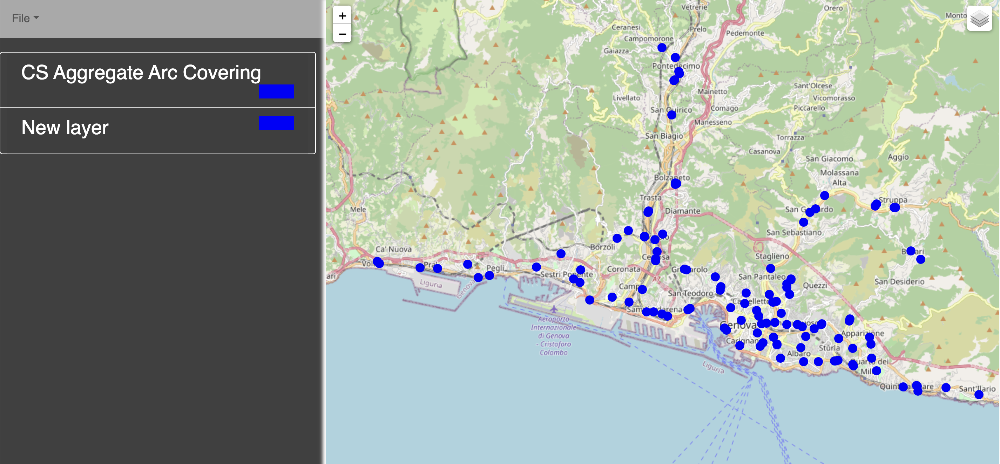

In [4]:
cs_to_open = [1543, 6664, 3083, 524, 2575, 528, 3620, 554, 5167, 1094, 5195, 5203, 2136, 3162, 6239, 
              610, 613, 4713, 1136, 2672, 4722, 4727, 633, 1147, 3708, 4225, 3714, 3203, 3204, 3207, 
              1672, 651, 2192, 3217, 5776, 2195, 1685, 6809, 5280, 2211, 1188, 4775, 679, 6316, 6829, 
              6828, 3762, 6325, 7861, 3259, 1216, 7873, 711, 3785, 2766, 2773, 726, 8925, 5358, 8435, 
              1786, 262, 3852, 3853, 7442, 4884, 276, 3879, 1831, 1321, 9002, 1323, 1324, 7465, 1343, 
              834, 3396, 1860, 2885, 845, 342, 2392, 4953, 1373, 5985, 4972, 8557, 3956, 4981, 2422, 
              2423, 2937, 381, 2431, 2433, 1922, 1928, 1423, 911, 912, 4502, 409, 2969, 5531, 1439, 
              931, 3493, 2475, 1463, 1979, 1982, 1987, 453, 4555, 2507, 1486, 976, 981, 6615, 5080, 
              8670, 2527, 3555, 2532, 3047, 493, 2541, 506, 1531, 6653]

In [62]:
for u in filtered_graph.nodes():
    for node in cs_to_open:
        replaceN = str(node).replace(str(node),'n'+str(node))
        try:
            if shortest_paths[u][replaceN]:
                distanza = shortest_paths[u][replaceN]
                if distanza <= 3000:
                    filtered_graph.nodes[u]['reachable'] = True
                    #filtered_graph.add_edge(u, replaceN, weight=distanza, description='reachable' )
                    break
        except:
            continue

In [73]:
reachable_nodes = [node for node in filtered_graph.nodes if filtered_graph.nodes[node].get('reachable') == True]
len(reachable_nodes)

8314

In [72]:
reach_node = []
for u in reachable_nodes:
    x = u.replace('n','')
    reach_node.append(int(x))
print(reach_node)

[246, 247, 248, 290, 256, 257, 258, 480, 259, 260, 261, 1502, 483, 262, 263, 264, 265, 2123, 6427, 2095, 2096, 1660, 266, 267, 268, 1083, 288, 1085, 269, 270, 271, 272, 7718, 3465, 1081, 281, 1851, 273, 274, 275, 276, 340, 341, 283, 277, 278, 279, 282, 3457, 280, 928, 284, 6174, 287, 285, 4401, 4402, 286, 289, 478, 2755, 291, 292, 293, 294, 1577, 6080, 6063, 7790, 295, 296, 1334, 1133, 297, 298, 353, 354, 355, 299, 300, 301, 302, 303, 676, 409, 1068, 7129, 304, 305, 306, 344, 549, 546, 548, 389, 390, 307, 308, 2805, 1606, 309, 310, 311, 313, 658, 530, 312, 4443, 4444, 314, 315, 650, 316, 317, 3785, 3786, 318, 319, 320, 4656, 4657, 3018, 5340, 321, 322, 323, 1909, 1910, 7918, 2004, 324, 325, 326, 8135, 6335, 8136, 1119, 327, 328, 329, 330, 534, 535, 6057, 6058, 4508, 331, 332, 333, 4686, 4687, 334, 335, 631, 6061, 4474, 336, 337, 338, 339, 643, 841, 4484, 4482, 4478, 4479, 6300, 704, 463, 464, 342, 343, 345, 391, 666, 667, 346, 714, 347, 348, 349, 350, 715, 587, 716, 396, 717, 351, 352,

In [70]:
non_reachable_nodes = [node for node in filtered_graph.nodes if filtered_graph.nodes[node].get('reachable') != True]
len(non_reachable_nodes)

663

In [75]:
reach_graph = nx.DiGraph()

for node1 in non_reachable_nodes:
    for node2 in non_reachable_nodes:
        if node1 != node2:
            try:
                if shortest_paths[node1][node2]:
                    distance = shortest_paths[node1][node2]  
                    if distance <= 3000:
                        reach_graph.add_edge(node1, node2, weight=distance) 
            except:
                continue

In [85]:
def solve_dominating_set(graph):
    model = gp.Model("dominating-set")

    dominating_set = model.addVars(graph.nodes, vtype=GRB.BINARY, name="dominating_set")

    model.setObjective(dominating_set.sum(), GRB.MINIMIZE)

    for node in graph.nodes:
        successors = graph.successors(node)
        model.addConstr(dominating_set[node] + gp.quicksum(dominating_set[neighbor] for neighbor in successors) >= 1)

    model.optimize()

    if model.status == GRB.OPTIMAL:
        dominating_set_solution = [node for node in graph.nodes if dominating_set[node].x > 0.5]
        return dominating_set_solution
    else:
        return None


In [86]:
solve_dominating_set(reach_graph)

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 642 rows, 642 columns and 13685 nonzeros
Model fingerprint: 0x3757a81a
Variable types: 0 continuous, 642 integer (642 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 74.0000000
Presolve removed 642 rows and 642 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 2: 67 74 

Optimal solution found (tolerance 1.00e-04)
Best objective 6.700000000000e+01, best bound 6.700000000000e+01, gap 0.0000%


['n572',
 'n573',
 'n835',
 'n576',
 'n5766',
 'n593',
 'n697',
 'n1129',
 'n4692',
 'n866',
 'n1178',
 'n1348',
 'n1352',
 'n6928',
 'n7766',
 'n1678',
 'n7164',
 'n7325',
 'n1738',
 'n8417',
 'n6647',
 'n2003',
 'n7851',
 'n683',
 'n4710',
 'n8076',
 'n5787',
 'n6074',
 'n6940',
 'n4329',
 'n3820',
 'n4346',
 'n9184',
 'n8710',
 'n8021',
 'n4742',
 'n4744',
 'n4948',
 'n4949',
 'n8173',
 'n7348',
 'n5160',
 'n8311',
 'n5506',
 'n7207',
 'n6536',
 'n5591',
 'n5902',
 'n5839',
 'n5733',
 'n5795',
 'n6031',
 'n8060',
 'n5816',
 'n8134',
 'n7809',
 'n6198',
 'n8844',
 'n8654',
 'n8115',
 'n5986',
 'n6005',
 'n6133',
 'n6583',
 'n6869',
 'n8321',
 'n8413']

In [81]:
WITH ['n572','n573','n835','n576','n5766','n593','n697','n1129','n4692','n866','n1178',
      'n1348','n1352','n6928','n7766','n1678','n7164','n7325','n1738','n8417','n6647',
      'n2003','n7851','n683','n4710','n8076','n5787','n6074','n6940','n4329','n3820',
      'n4346','n9184','n8710','n8021','n4742','n4744','n4948','n4949','n8173','n7348',
      'n5160','n8311','n5506','n7207','n6536','n5591','n5902','n5839','n5733','n5795',
      'n6031','n8060','n5816','n8134','n7809','n6198','n8844','n8654','n8115','n5986',
      'n6005','n6133','n6583','n6869','n8321','n8413'] as nodes 
UNWIND nodes AS singleNode
WITH apoc.text.replace(singleNode,'n','') as id 
MATCH (p:Point) 
WHERE id(p)=toFloat(id) 
SET p:newStation

67

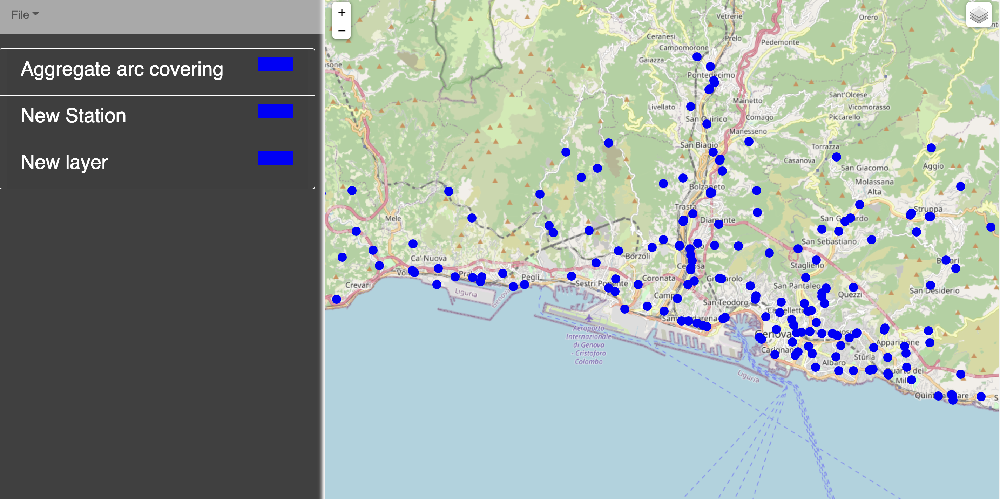

## Prendo tutte le fasce orarie

Le labels nel database da considerare sono tutti i nodi con :allAggregateArcCovering, mentre per le nuove stazioni sono da considerare i nodi con :allNewStation. I nodi che non raggiungono le stazioni hanno le labels :allNotReachable

In [23]:
tot_results = set()
model_num = 0
for index, row in df1.iterrows():
    subgraph_nodes = []
    # le liste nodi_origine e nodi_destinazione servono per inserire tutti i nodi che appartengono alla zona
    nodi_origine = []
    nodi_destinazione = []
    # Prendo nodo origine e destinazione dal dataframe
    name_origine = row['origine']
    name_destinazione = row['destinazione']
    
    pattern_o = re.compile(name_origine, re.IGNORECASE)
    pattern_d = re.compile(name_destinazione, re.IGNORECASE)
    
    # Prendo nel grafo tutti i nodi che appartengono alla zona di origine e tutti i nodi che appartengono alla zona
    # destinazione. Creo una lista per i nodi origine e destinazione.
    for node, attrs in G.nodes(data=True):
        if 'zona_di_appartenenza' in attrs and pattern_o.search(attrs['zona_di_appartenenza']):
            nodi_origine.append(node)
        if 'zona_di_appartenenza' in attrs and pattern_d.search(attrs['zona_di_appartenenza']):
            nodi_destinazione.append(node)
    
    
    calcola_shortest_path(name_origine,name_destinazione,nodi_origine,nodi_destinazione,subgraph_nodes)
    
    path_dict = dict()
    flows_dict = {}
    flusso_tot = []
    zone_att = []
    numPath = 0
    for i in subgraph_nodes:
        zone_att = set(calcolo_zone_attraversate(i))
        path_dict[numPath] = zone_att
     
        # CALCOLO FLUSSO PER LE ZONE CHE IL PATH ATTRAVERSA
        if len(zone_att) > 0:
            total_flow = calcolo_flusso(list(zone_att), flows_dict)
        if total_flow == 0:
            total_flow = 10
            
        flusso_tot.append(total_flow)
        flows_dict[numPath] = float(total_flow)
        
        numPath = numPath + 1
        
    unique_nodes = get_unique_nodes(subgraph_nodes)
    nodi_interi = []
    for n in unique_nodes:
        nodi_interi.append(int(n.replace("n",'')))
        
    tot_res = create_model(nodi_interi,subgraph_nodes,flusso_tot,model_num,tot_results)
    model_num = model_num + 1 
    
    tot_results.update(tot_res)
    
print("CHARGING STATION TO ACTIVATE: " + str(tot_results))

ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2150 rows, 231 columns and 19051 nonzeros
Model fingerprint: 0x09dcae35
Variable types: 0 continuous, 231 integer (231 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2061 rows and 182 columns
Presolve time: 0.02s
Presolved: 89 rows, 49 columns, 372 nonzeros
Found heuristic solution: objective 5716.0000000
Variable types: 0 continuous, 49 integer (47 binary)

Root relaxation: cutoff, 56 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0     cutoff    0 

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1154 rows and 41 columns
Presolve time: 0.02s
Presolved: 740 rows, 148 columns, 7398 nonzeros
Variable types: 0 continuous, 148 integer (140 binary)

Root relaxation: objective 2.133091e+04, 202 iterations, 0.00 seconds (0.01 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 21330.9091    0   67   -0.00000 21330.9091      -     -    0s
H    0     0                    4190.0000000 21330.9091   409%     -    0s
H    0     0                    6285.0000000 19553.3333   211%     -    0s
     0     0 19553.3333    0   63 6285.00000 19553.3333   211%     -    0s
     0     0 17335.0980    0   47 6285.00000 17335.0980   176%     -    0s
     0     


    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

H    0     0                    12460.000000 64115.0000   415%     -    0s
     0     0          -    0      12460.0000 12460.0000  0.00%     -    0s

Explored 1 nodes (79 simplex iterations) in 0.02 seconds (0.03 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 12460 5340 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 1.246000000000e+04, best bound 1.246000000000e+04, gap 0.0000%
MODEL COUNT: 10 RESULTS: [2306, 4734]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1116 rows, 171 columns and 7874 nonzeros
Model fingerprint: 0xf38eba18
Variable types: 0 continuous, 171 integer (171 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1

MODEL COUNT: 16 RESULTS: [1930]
CS PRESENTE: 1617
CS PRESENTE: 756
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 873 rows, 137 columns and 7154 nonzeros
Model fingerprint: 0x287103d2
Variable types: 0 continuous, 137 integer (137 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 873 rows and 137 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0

CS PRESENTE: 309
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1786 rows, 176 columns and 18745 nonzeros
Model fingerprint: 0x6b0c1e14
Variable types: 0 continuous, 176 integer (176 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1786 rows and 176 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 24 RESULTS: [309]
CS PRESEN

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 709 rows and 137 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 30 RESULTS: [2156, 2155]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 885 rows, 117 columns and 7482 nonzeros
Model fingerprint: 0x309b5fc6
Variable types: 0 continuous, 117 integer (117 binary)
Coefficient statistics

Thread count was 8 (of 8 available processors)

Solution count 3: 2502 1251 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 2.502000000000e+03, best bound 2.502000000000e+03, gap 0.0000%
MODEL COUNT: 35 RESULTS: [8925, 5939]
CS PRESENTE: 8925
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 766 rows, 109 columns and 6966 nonzeros
Model fingerprint: 0x27e8cb51
Variable types: 0 continuous, 109 integer (109 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 766 rows and 109 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 avail

Found heuristic solution: objective -0.0000000
Presolve removed 1391 rows and 159 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.03 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 43 RESULTS: [1294, 1297]
CS PRESENTE: 309
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1062 rows, 152 columns and 9853 nonzeros
Model fingerprint: 0x7edc3f85
Variable types: 0 continuous, 152 integer (152 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Fou

CS PRESENTE: 4819
CS PRESENTE: 2155
CS PRESENTE: 2156
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1501 rows, 216 columns and 11420 nonzeros
Model fingerprint: 0x1bfa2c25
Variable types: 0 continuous, 216 integer (216 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1501 rows and 216 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MOD

Thread count was 8 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 55 RESULTS: [1071, 2072]
CS PRESENTE: 297
CS PRESENTE: 4221
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 804 rows, 125 columns and 6879 nonzeros
Model fingerprint: 0x7c312366
Variable types: 0 continuous, 125 integer (125 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 804 rows and 125 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00

  Objective range  [9e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1223 rows and 182 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 63 RESULTS: [309]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1078 rows, 139 columns and 11262 nonzeros
Model fingerprint: 0x16de62bb
Variable types: 0 continuous, 139 integer (139 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02,

MODEL COUNT: 70 RESULTS: [309]
CS PRESENTE: 4630
CS PRESENTE: 4631
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 546 rows, 121 columns and 5271 nonzeros
Model fingerprint: 0x743214c5
Variable types: 0 continuous, 121 integer (121 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 546 rows and 121 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1911 rows, 218 columns and 22278 nonzeros
Model fingerprint: 0x3d080b66
Variable types: 0 continuous, 218 integer (218 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1911 rows and 218 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 78 RESULTS: [5634, 1543, 5292]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 2759
CS PRESENTE: 2525
ACTIVATE CS= 4
Gurobi O

Variable types: 0 continuous, 321 integer (321 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2942 rows and 321 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 85 RESULTS: [1071, 1294, 1297, 4221, 2345, 297]
CS PRESENTE: 1930
CS PRESENTE: 1931
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1160 rows, 137 columns and 9081 


Optimize a model with 1917 rows, 201 columns and 19952 nonzeros
Model fingerprint: 0x204fc893
Variable types: 0 continuous, 201 integer (201 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1917 rows and 201 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 93 RESULTS: [5071, 5077, 2525]
CS PRESENTE: 259
CS PRESENTE: 2525
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, 

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1288 rows and 115 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 101 RESULTS: [5347, 1972]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1011 rows, 106 columns and 6591 nonzeros
Model fingerprint: 0x8d1dc7b3
Variable types: 0 continuous, 106 integer (106 binary)
Coefficient statist

Found heuristic solution: objective -0.0000000
Presolve removed 541 rows and 110 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 109 RESULTS: [1071, 2525]
CS PRESENTE: 1071
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 374 rows, 88 columns and 3498 nonzeros
Model fingerprint: 0xd47f6739
Variable types: 0 continuous, 88 integer (88 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found 

  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2731 rows and 184 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 117 RESULTS: [1435, 2345, 2202]
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2202
CS PRESENTE: 1435
CS PRESENTE: 1071
CS PRESENTE: 2525
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2652 rows, 179 columns and 26567 nonzeros
Model fingerprint: 0x50072b2d
Variable types: 0 continuous, 179 integer (179 binary)
Coefficient statistics:
  Matr

MODEL COUNT: 124 RESULTS: [753, 1420]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 931 rows, 131 columns and 7491 nonzeros
Model fingerprint: 0xa2b6fe88
Variable types: 0 continuous, 131 integer (131 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 931 rows and 131 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 125 RESUL

No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 132 RESULTS: [753, 1071, 1294, 1297, 2345, 3162]
CS PRESENTE: 309
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 666 rows, 135 columns and 6337 nonzeros
Model fingerprint: 0x80163323
Variable types: 0 continuous, 135 integer (135 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 666 rows and 135 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Sol

Presolve time: 0.00s
Presolved: 202 rows, 63 columns, 1344 nonzeros
Variable types: 0 continuous, 63 integer (56 binary)

Root relaxation: objective 6.362000e+03, 66 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 6362.00000    0   23   -0.00000 6362.00000      -     -    0s
H    0     0                    2848.0000000 6362.00000   123%     -    0s
H    0     0                    5271.0000000 6362.00000  20.7%     -    0s

Cutting planes:
  Gomory: 1
  Mod-K: 1

Explored 1 nodes (73 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 5271 2848 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 5.271000000000e+03, best bound 5.271000000000e+03, gap 0.0000%
MODEL COUNT: 139 RESULTS: [2270, 1586]
CS PRESENTE: 658
CS PRESENTE: 8364
CS PRESENTE: 2270
ACT

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 146 RESULTS: [658, 309]
CS PRESENTE: 1543
CS PRESENTE: 1420
CS PRESENTE: 2202
CS PRESENTE: 1435
CS PRESENTE: 5292
CS PRESENTE: 5230
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3967 rows, 286 columns and 51608 nonzeros
Model fingerprint: 0x00940da1
Variable types: 0 continuous, 286 integer (286 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solutio


Optimize a model with 1153 rows, 223 columns and 10874 nonzeros
Model fingerprint: 0x2962ece6
Variable types: 0 continuous, 223 integer (223 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1153 rows and 223 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 154 RESULTS: [1294, 1297, 1435, 1420, 2202]
CS PRESENTE: 297
CS PRESENTE: 3500
CS PRESENTE: 4221
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physica


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7852 rows, 345 columns and 96053 nonzeros
Model fingerprint: 0x33e22102
Variable types: 0 continuous, 345 integer (345 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 7852 rows and 345 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 162 RESULTS: [658, 5230, 4630, 2525, 1543, 5292, 4631]
CS PRESENTE: 5634
CS PRESENTE: 2306
CS PRESENTE: 7293
CS PRESENTE: 5230


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5590 rows, 232 columns and 48037 nonzeros
Model fingerprint: 0xc8b3c117
Variable types: 0 continuous, 232 integer (232 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5590 rows and 232 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 169 RESULTS: [843, 1930, 309, 1617, 1931]
CS PRESENTE: 1930
CS PRESENTE: 1931
CS PRESENTE: 309
CS PRESENTE: 381
ACTIVATE CS= 4

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 176 RESULTS: [309]
CS PRESENTE: 658
CS PRESENTE: 309
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1523 rows, 248 columns and 15679 nonzeros
Model fingerprint: 0xdae75591
Variable types: 0 continuous, 248 integer (248 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1523 rows and 248 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1206 rows and 191 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 183 RESULTS: [1071, 1464]
CS PRESENTE: 259
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1227 rows, 132 columns and 10653 nonzeros
Model fingerprint: 0xa6798030
Variable types: 0 continuous, 132 integer (132 binary)
C

CS PRESENTE: 1543
CS PRESENTE: 8925
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 6074
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6615 rows, 281 columns and 66975 nonzeros
Model fingerprint: 0x4caf6709
Variable types: 0 continuous, 281 integer (281 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6615 rows and 281 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.00000000000

Root relaxation: objective 4.446667e+03, 79 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 4446.66667    0   21   -0.00000 4446.66667      -     -    0s
H    0     0                    2384.0000000 4446.66667  86.5%     -    0s
H    0     0                    2980.0000000 4446.66667  49.2%     -    0s

Cutting planes:
  Gomory: 1
  Mod-K: 1

Explored 1 nodes (88 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 2980 2384 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 2.980000000000e+03, best bound 2.980000000000e+03, gap 0.0000%
MODEL COUNT: 198 RESULTS: [6668, 1713]
CS PRESENTE: 6842
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, usi

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1026 rows and 170 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 205 RESULTS: [2156, 3727, 5167, 2155, 5166]
CS PRESENTE: 5634
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 5292
CS PRESENTE: 4819
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 212 RESULTS: [1435, 2525, 1420, 2202]
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 1420
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1268 rows, 191 columns and 12140 nonzeros
Model fingerprint: 0xb24fd13c
Variable types: 0 continuous, 191 integer (191 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: ob

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 220 RESULTS: [4221, 2411, 297]
CS PRESENTE: 6293
CS PRESENTE: 753
CS PRESENTE: 756
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 381
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3911 rows, 243 columns and 39253 nonzeros
Model fingerprint: 0x9d986ea2
Variable types: 0 continuous, 243 integer (243 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range     

MODEL COUNT: 226 RESULTS: [2995, 2942]
CS PRESENTE: 8418
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2942
CS PRESENTE: 2992
CS PRESENTE: 2995
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6575 rows, 286 columns and 76340 nonzeros
Model fingerprint: 0x1cae35cc
Variable types: 0 continuous, 286 integer (286 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6575 rows and 286 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 


Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 234 RESULTS: [658, 843, 1930, 309, 311, 1931]
CS PRESENTE: 309
CS PRESENTE: 4444
CS PRESENTE: 1930
CS PRESENTE: 1931
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4243 rows, 239 columns and 40540 nonzeros
Model fingerprint: 0x7dc2af56
Variable types: 0 continuous, 239 integer (239 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4243 rows and


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 884 rows, 157 columns and 7017 nonzeros
Model fingerprint: 0x4dccc4e1
Variable types: 0 continuous, 157 integer (157 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 884 rows and 157 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 242 RESULTS: [2306, 4734]
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 7952
CS PRESENTE: 1515
ACTIVATE CS= 4
Gurobi Optimizer

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 249 RESULTS: [7267, 1294, 1297, 7268]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 1071
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 4444
CS PRESENTE: 416
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 983 rows, 251 columns and 10636 nonzeros
Model fingerprint: 0x058d06f7
Variable types: 0 continuous, 251 integer (251 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 983 rows and 251 columns
P

Found heuristic solution: objective -0.0000000
Presolve removed 5791 rows and 310 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 257 RESULTS: [5230, 1294, 1297, 5634, 8418, 5292]
CS PRESENTE: 1543
CS PRESENTE: 5292
CS PRESENTE: 1515
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3435 rows, 275 columns and 42481 nonzeros
Model fingerprint: 0x3239a6fd
Variable types: 0 continuous, 275 integer (275 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 5e+03]
  Bounds

CS PRESENTE: 6668
CS PRESENTE: 4734
CS PRESENTE: 1713
CS PRESENTE: 2306
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1354 rows, 229 columns and 10516 nonzeros
Model fingerprint: 0xa2126f4f
Variable types: 0 continuous, 229 integer (229 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1354 rows and 229 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+0


Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 272 RESULTS: [619, 7929, 4819, 2759, 4630, 4991, 2270, 1464, 4631, 416, 4637]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4819
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 4991
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2334 rows, 163 columns and 18504 nonzeros
Model fingerprint: 0x5f4fc576
Variable types: 0 continuous, 163 integer (163 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heur

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 279 RESULTS: [658, 619, 2759, 2270, 416]
CS PRESENTE: 1464
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 897 rows, 106 columns and 9477 nonzeros
Model fingerprint: 0x78df6a00
Variable types: 0 continuous, 106 integer (106 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 897 rows and 106 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1371 rows and 255 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 286 RESULTS: [658, 309, 311]
CS PRESENTE: 4221
CS PRESENTE: 658
CS PRESENTE: 297
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 843
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 920 rows, 146 columns and 8528 nonzeros

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 293 RESULTS: [7267, 1071, 1294, 1297, 7268, 1435, 2525, 2306, 6668, 1420, 2202]
CS PRESENTE: 1543
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 5292
CS PRESENTE: 736
CS PRESENTE: 3500
CS PRESENTE: 2525
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 12704 rows, 374 columns and 140925 nonzeros
Model fingerprint: 0x112d411d
Variable types: 0 continuous, 374 integer (374 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 12704 rows and 374 columns
Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.03 seconds (0.

Model fingerprint: 0xa98cf2a9
Variable types: 0 continuous, 154 integer (154 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1160 rows and 154 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 301 RESULTS: [843, 381, 259]
CS PRESENTE: 1543
CS PRESENTE: 5230
CS PRESENTE: 4728
CS PRESENTE: 7293
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimiz

H    0     0                    1916.0000000 3065.60000  60.0%     -    0s
H    0     0                    2395.0000000 2874.00000  20.0%     -    0s
     0     0 2636.60000    0   20 2395.00000 2636.60000  10.1%     -    0s

Cutting planes:
  Gomory: 1

Explored 1 nodes (86 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 2395 1916 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 2.395000000000e+03, best bound 2.395000000000e+03, gap 0.0000%
MODEL COUNT: 308 RESULTS: [1256, 3880]
CS PRESENTE: 4221
CS PRESENTE: 297
CS PRESENTE: 843
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 525 rows, 112 columns and 4137 nonzeros
Model fingerprint: 0x7a7f6ed0
Variable types: 0 continuous, 112 integer (112 binary)
Coefficient statistics:
  Matrix range     [1e+00

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2586 rows and 259 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 316 RESULTS: [3727, 1381, 309, 4444]
CS PRESENTE: 4734
CS PRESENTE: 5347
CS PRESENTE: 2306
CS PRESENTE: 1972
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1963 rows, 174 columns and 15370 nonzeros
Model fingerprint: 0


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 588 rows, 93 columns and 5442 nonzeros
Model fingerprint: 0x591bcc48
Variable types: 0 continuous, 93 integer (93 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 298 rows and 17 columns
Presolve time: 0.01s
Presolved: 290 rows, 76 columns, 2457 nonzeros
Variable types: 0 continuous, 76 integer (71 binary)

Root relaxation: objective 4.340000e+03, 78 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

*    0     0               0    4340.0000000 4340.00000  0.00%     -    0s

Explored 1 nodes (78 simplex iterations) in 0.01 seconds (0.01 work units

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 331 RESULTS: [753, 1294, 1297, 2345, 1464]
CS PRESENTE: 1543
CS PRESENTE: 736
CS PRESENTE: 2525
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3333 rows, 234 columns and 39426 nonzeros
Model fingerprint: 0xed11cd1a
Variable types: 0 continuous, 234 integer (234 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3333 rows and 234 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 si

Presolve removed 3364 rows and 211 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 339 RESULTS: [5230, 5634, 5292]
CS PRESENTE: 1543
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 5292
CS PRESENTE: 736
CS PRESENTE: 4444
CS PRESENTE: 2525
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7403 rows, 307 columns and 86447 nonzeros
Model fingerprint: 0x56cd6a84
Variable types: 0 continuous, 307 integer (307 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  

MODEL COUNT: 346 RESULTS: [619, 416]
CS PRESENTE: 4630
CS PRESENTE: 4631
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1124 rows, 190 columns and 10971 nonzeros
Model fingerprint: 0x63441c49
Variable types: 0 continuous, 190 integer (190 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1124 rows and 190 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 354 RESULTS: [2995, 5634, 5939, 5292, 2942]
CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1294
CS PRESENTE: 1297
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 651 rows, 173 columns and 5806 nonzeros
Model fingerprint: 0xc0fa3392
Variable types: 0 continuous, 173 integer (173 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found

Variable types: 0 continuous, 114 integer (114 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 611 rows and 114 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 362 RESULTS: [736, 1464]
CS PRESENTE: 2072
CS PRESENTE: 736
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 598 rows, 103 columns and 5662 nonzeros
Model fingerprint

Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 525 rows, 137 columns and 4263 nonzeros
Model fingerprint: 0xe7358236
Variable types: 0 continuous, 137 integer (137 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 525 rows and 137 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 370 RESULTS: [6668]
CS PRESENTE: 6668
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2202
CS PRESENTE: 1713
CS PRESENTE: 753
CS PRESENTE: 1294
CS PR

Variable types: 0 continuous, 266 integer (266 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+03, 7e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4105 rows and 266 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 377 RESULTS: [5230, 1543, 5292]
CS PRESENTE: 1543
CS PRESENTE: 5230
CS PRESENTE: 5292
CS PRESENTE: 736
CS PRESENTE: 2525
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model 

MODEL COUNT: 384 RESULTS: [2879, 2387, 736]
CS PRESENTE: 1071
CS PRESENTE: 2879
CS PRESENTE: 2387
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 435 rows, 101 columns and 2841 nonzeros
Model fingerprint: 0x0abcd2d7
Variable types: 0 continuous, 101 integer (101 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 435 rows and 101 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best b


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 392 RESULTS: [2072, 4976]
CS PRESENTE: 4976
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 526 rows, 97 columns and 3977 nonzeros
Model fingerprint: 0x85cbd173
Variable types: 0 continuous, 97 integer (97 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 526 rows and 97 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explor


Optimize a model with 1391 rows, 148 columns and 13724 nonzeros
Model fingerprint: 0x717d42ff
Variable types: 0 continuous, 148 integer (148 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1391 rows and 148 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 400 RESULTS: [3500]
CS PRESENTE: 3500
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optim

MODEL COUNT: 407 RESULTS: [2995, 309, 658, 1297, 8418, 2942, 753, 2345, 311, 736, 1294, 5939]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4819
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 2942
CS PRESENTE: 4991
CS PRESENTE: 2995
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 16213 rows, 373 columns and 172113 nonzeros
Model fingerprint: 0xb5815777
Variable types: 0 continuous, 373 integer (373 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 16213 rows and 373 columns
Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 s

  Objective range  [9e+02, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 829 rows and 94 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 415 RESULTS: [7293, 4728, 3162]
CS PRESENTE: 1559
CS PRESENTE: 3162
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 773 rows, 84 columns and 7247 nonzeros
Model fingerprint: 0xeafc1c37
Variable types: 0 continuous, 84 integer (84 binary)
Coefficient statistics:
  Matrix range   

MODEL COUNT: 422 RESULTS: [7267, 7268, 7293, 4728]
CS PRESENTE: 6668
CS PRESENTE: 4728
CS PRESENTE: 7293
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 590 rows, 105 columns and 4521 nonzeros
Model fingerprint: 0xf14f9482
Variable types: 0 continuous, 105 integer (105 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 590 rows and 105 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00,

Found heuristic solution: objective -0.0000000
Presolve removed 3546 rows and 210 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 430 RESULTS: [7267, 736, 1071, 1294, 1297, 7268, 1435, 2525, 1420, 2202]
CS PRESENTE: 4221
CS PRESENTE: 297
CS PRESENTE: 309
CS PRESENTE: 381
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1290 rows, 162 columns and 13621 nonzeros
Model fingerprint: 0x4243d93f
Variable types: 0 continuous, 162 integer (162 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Ob

Model fingerprint: 0x18a11fc2
Variable types: 0 continuous, 149 integer (149 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1024 rows and 149 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 438 RESULTS: [619, 736, 4630, 4631, 416]
CS PRESENTE: 1617
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 7952
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 381
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64

Presolve removed 729 rows and 134 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 445 RESULTS: [1649, 843, 736, 4221, 1464, 1648, 297]
CS PRESENTE: 2072
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 843
CS PRESENTE: 381
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 791 rows, 133 columns and 6469 nonzeros
Model fingerprint: 0xd7ffe8dc
Variable types: 0 continuous, 133 integer (133 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 1e+03]
  Bounds range     [1

MODEL COUNT: 452 RESULTS: [1256, 309, 311]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 3805
CS PRESENTE: 1323
CS PRESENTE: 1381
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1981 rows, 149 columns and 14294 nonzeros
Model fingerprint: 0xd2609cd3
Variable types: 0 continuous, 149 integer (149 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1981 rows and 149 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5313 rows, 400 columns and 52694 nonzeros
Model fingerprint: 0xd21b996a
Variable types: 0 continuous, 400 integer (400 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5313 rows and 400 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 460 RESULTS: [7268, 309, 1559, 658, 7267, 1297, 843, 753, 2345, 2306, 311, 1294, 6668]
CS PRESENTE: 3727
CS PRESENTE: 658
CS P


Explored 0 nodes (0 simplex iterations) in 0.03 seconds (0.03 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 466 RESULTS: [2995, 8925, 309, 1297, 2942, 753, 4819, 2345, 5166, 311, 1294, 5167]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 8925
CS PRESENTE: 736
CS PRESENTE: 5939
CS PRESENTE: 4444
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9881 rows, 351 columns and 109393 nonzeros
Model fingerprint: 0x6d54f25a
Variable types: 0 continuous, 351 integer (351 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+03, 7e+03]
  Bounds range   


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 473 RESULTS: [619, 753, 736, 2345, 416]
CS PRESENTE: 4631
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 843
CS PRESENTE: 381
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 791 rows, 163 columns and 8489 nonzeros
Model fingerprint: 0x2cf7217e
Variable types: 0 continuous, 163 integer (163 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 791 rows and 163 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread

Presolve removed 1254 rows and 184 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 479 RESULTS: [1543, 5292]
CS PRESENTE: 1294
CS PRESENTE: 1297
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1354 rows, 161 columns and 16939 nonzeros
Model fingerprint: 0xa0c99d80
Variable types: 0 continuous, 161 integer (161 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: obj

Model fingerprint: 0xe60bd64e
Variable types: 0 continuous, 95 integer (95 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 518 rows and 95 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 2: 350 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 3.500000000000e+02, best bound 3.500000000000e+02, gap 0.0000%
MODEL COUNT: 487 RESULTS: [1703, 4542]
CS PRESENTE: 1703
CS PRESENTE: 6842
CS PRESENTE: 4542
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 563 rows, 108 columns and 3201 nonzeros
Mo

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 494 RESULTS: [1294, 1297]
CS PRESENTE: 1420
CS PRESENTE: 2525
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1228 rows, 149 columns and 11926 nonzeros
Model fingerprint: 0x0fb5c500
Variable types: 0 continuous, 149 integer (149 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1228 rows and 149 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (to

  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2798 rows and 220 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 502 RESULTS: [3661, 753, 309, 6169, 2345, 311, 4138]
CS PRESENTE: 1543
CS PRESENTE: 5292
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 9044
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up 

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 509 RESULTS: [8925]
CS PRESENTE: 8925
CS PRESENTE: 5939
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 843 rows, 102 columns and 7314 nonzeros
Model fingerprint: 0xa359310f
Variable types: 0 continuous, 102 integer (102 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 843 rows and 102 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5188 rows and 228 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 517 RESULTS: [5071, 2995, 8925, 5077, 2942]
CS PRESENTE: 7722
CS PRESENTE: 3162
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 4415
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical proce

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 8841 rows, 332 columns and 100979 nonzeros
Model fingerprint: 0x54b3136e
Variable types: 0 continuous, 332 integer (332 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 8841 rows and 332 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 524 RESULTS: [658, 2995, 3661, 753, 1294, 1297, 309, 6169,

Found heuristic solution: objective -0.0000000
Presolve removed 2822 rows and 308 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 531 RESULTS: [3805, 843, 4221, 1381, 309, 1323, 297]
CS PRESENTE: 3805
CS PRESENTE: 1323
CS PRESENTE: 843
CS PRESENTE: 3500
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2239 rows, 270 columns and 16042 nonzeros
Model fingerprint: 0xa5a423d3
Variable types: 0 continuous, 270 integer (270 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1780 rows, 151 columns and 23586 nonzeros
Model fingerprint: 0x8b6af46c
Variable types: 0 continuous, 151 integer (151 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1780 rows and 151 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 539 RESULTS: [5230, 1543, 5292]
CS PRESENTE: 1543
CS PRESENTE: 5230
CS PRESENTE: 5292
ACTIVATE CS= 3
Gurobi Optimizer version 

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 546 RESULTS: [2879, 2387, 2345]
CS PRESENTE: 1543
CS PRESENTE: 5230
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1352 rows, 170 columns and 15556 nonzeros
Model fingerprint: 0x320bf6f7
Variable types: 0 continuous, 170 integer (170 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1352 rows and 170 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 se


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 554 RESULTS: [5634, 5292]
CS PRESENTE: 753
CS PRESENTE: 1420
CS PRESENTE: 2525
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 629 rows, 117 columns and 5452 nonzeros
Model fingerprint: 0x2bf5e06d
Variable types: 0 continuous, 117 integer (117 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 629 rows and 117 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count wa


Optimize a model with 818 rows, 91 columns and 8067 nonzeros
Model fingerprint: 0xe85df665
Variable types: 0 continuous, 91 integer (91 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 818 rows and 91 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 562 RESULTS: [3162]
CS PRESENTE: 309
CS PRESENTE: 311
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threa

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 569 RESULTS: [7267, 736, 1294, 1297, 7268, 1381, 1435, 4630, 2525, 4631, 1420, 2202]
CS PRESENTE: 1559
CS PRESENTE: 3162
CS PRESENTE: 8925
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 2995
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5019 rows, 248 columns and 53308 nonzeros
Model fingerprint: 0x42147b06
Variable types: 0 continuous, 248 integer (248 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5019 rows an

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 576 RESULTS: [3606, 3500]
CS PRESENTE: 3606
CS PRESENTE: 2423
CS PRESENTE: 3500
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1754 rows, 159 columns and 13266 nonzeros
Model fingerprint: 0x11588874
Variable types: 0 continuous, 159 integer (159 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1754 rows a


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2016 rows, 284 columns and 14789 nonzeros
Model fingerprint: 0x63307221
Variable types: 0 continuous, 284 integer (284 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2016 rows and 284 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 584 RESULTS: [7267, 736, 7263, 1294, 1297, 4221, 7268, 1435, 2525, 2306, 1559, 1420, 297, 2202]
ACTIVATE CS= 0
Gurobi Optimize

No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 589 RESULTS: [344, 4631]
CS PRESENTE: 1586
CS PRESENTE: 2636
CS PRESENTE: 619
CS PRESENTE: 843
CS PRESENTE: 344
CS PRESENTE: 2411
CS PRESENTE: 381
CS PRESENTE: 416
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1768 rows, 159 columns and 17853 nonzeros
Model fingerprint: 0x057b1c44
Variable types: 0 continuous, 159 integer (159 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1768 rows and 159 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simp

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 596 RESULTS: [619, 736, 1381, 4630, 344, 4631, 416]
CS PRESENTE: 259
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 1381
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1007 rows, 119 columns and 8438 nonzeros
Model fingerprint: 0x7c5a994a
Variable types: 0 continuous, 119 integer (119 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1007 rows and 119 columns
Presolve time: 0.00s
Presolve: All rows and columns removed


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2066 rows, 224 columns and 18864 nonzeros
Model fingerprint: 0xc6ad6b44
Variable types: 0 continuous, 224 integer (224 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2066 rows and 224 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 604 RESULTS: [658, 843, 309, 344, 311]
CS PRESENTE: 619
CS PRESENTE: 658
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 309


Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+03, 7e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2961 rows and 230 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 611 RESULTS: [5230, 1543, 5292]
CS PRESENTE: 1559
CS PRESENTE: 7263
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1703
CS PRESENTE: 5347
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 1972
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads



Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 618 RESULTS: [2995, 5939, 2942]
CS PRESENTE: 8418
CS PRESENTE: 2942
CS PRESENTE: 2995
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4694 rows, 237 columns and 50653 nonzeros
Model fingerprint: 0x55803ee8
Variable types: 0 continuous, 237 integer (237 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4694 rows and 237 columns
Presolve time: 0.0

Model fingerprint: 0x7922f6d9
Variable types: 0 continuous, 220 integer (220 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3387 rows and 220 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 626 RESULTS: [8418]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 309
CS PRESENTE: 311
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 633 RESULTS: [753, 7267, 1294, 1297, 7268, 1381, 309, 2345, 311]
CS PRESENTE: 1543
CS PRESENTE: 2942
CS PRESENTE: 2959
CS PRESENTE: 2995
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3302 rows, 249 columns and 36840 nonzeros
Model fingerprint: 0xecf68e56
Variable types: 0 continuous, 249 integer (249 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3302 rows and 249 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex 

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2692 rows, 182 columns and 28685 nonzeros
Model fingerprint: 0x0dd620d4
Variable types: 0 continuous, 182 integer (182 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2692 rows and 182 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 641 RESULTS: [8925]
CS PRESENTE: 3880
CS PRESENTE: 1381
ACT


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1326 rows, 130 columns and 10405 nonzeros
Model fingerprint: 0x6a3cf732
Variable types: 0 continuous, 130 integer (130 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1326 rows and 130 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 648 RESULTS: [1703, 5347, 2306, 4734, 1972]
CS PRESENTE: 4734
CS PRESENTE: 2306
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 8058 rows, 343 columns and 96132 nonzeros
Model fingerprint: 0x2caaa706
Variable types: 0 continuous, 343 integer (343 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 8058 rows and 343 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 655 RESULTS: [5230, 753, 1294, 1297, 381, 2411, 5634, 5292, 2345]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 2879
ACTIVA

Variable types: 0 continuous, 167 integer (167 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1732 rows and 167 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 662 RESULTS: [843, 756, 309, 2411, 1617, 311]
CS PRESENTE: 309
CS PRESENTE: 363
CS PRESENTE: 2411
CS PRESENTE: 381
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1

Presolve removed 1807 rows and 142 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 669 RESULTS: [736, 4444, 4630, 344, 1464, 4631]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 553 rows, 128 columns and 4900 nonzeros
Model fingerprint: 0x5907959a
Variable types: 0 continuous, 128 integer (128 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.000000

No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 676 RESULTS: [2879, 2525, 2387]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1227 rows, 157 columns and 12754 nonzeros
Model fingerprint: 0x85c4f309
Variable types: 0 continuous, 157 integer (157 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1227 rows and 157 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other sol


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 684 RESULTS: [7929, 4637]
CS PRESENTE: 7929
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1312 rows, 144 columns and 12300 nonzeros
Model fingerprint: 0x21f90ea5
Variable types: 0 continuous, 144 integer (144 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1312 rows and 144 columns
Presolve time: 0.00s
Presolve: All rows and columns removed


Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 691 RESULTS: [2995, 8925, 1297, 2942, 1648, 1649, 753, 2345, 1294]
CS PRESENTE: 1703
CS PRESENTE: 4542
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1028 rows, 100 columns and 6542 nonzeros
Model fingerprint: 0x039ebf6c
Variable types: 0 continuous, 100 integer (100 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1028 rows and 100 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes

MODEL COUNT: 698 RESULTS: [658, 753, 7267, 736, 1294, 1297, 7268, 309, 2345, 311]
CS PRESENTE: 658
CS PRESENTE: 1787
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 344
CS PRESENTE: 349
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1503 rows, 282 columns and 14421 nonzeros
Model fingerprint: 0x0acc5cbb
Variable types: 0 continuous, 282 integer (282 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1503 rows and 282 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than 

Model fingerprint: 0xb0685f16
Variable types: 0 continuous, 145 integer (145 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1445 rows and 145 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 706 RESULTS: [619, 344, 349, 416]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4637
CS PRESENTE: 619
CS PRESENTE: 7929
CS PRESENTE: 344
CS PRESENTE: 349
CS PRESENTE: 416
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread coun

  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 7709 rows and 322 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 713 RESULTS: [8466, 2525, 1543, 3140]
CS PRESENTE: 5292
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7214 rows, 287 columns and 85916 nonzeros
Model fingerprint: 0x3ce71a17
Variable types: 0 continuous, 287 integer (287 binary)
Coefficient statistics:
  Matrix range     

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1354 rows and 211 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 720 RESULTS: [658, 736, 309, 1787, 344, 311, 349]
CS PRESENTE: 3140
CS PRESENTE: 2202
CS PRESENTE: 8466
CS PRESENTE: 2879
CS PRESENTE: 2387
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 2525
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1919 rows, 159 columns and 20092 nonzeros
Model fingerprint: 0x127fc1

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 521 rows, 127 columns and 5064 nonzeros
Model fingerprint: 0x101314ae
Variable types: 0 continuous, 127 integer (127 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective 1018.0000000
Presolve removed 521 rows and 127 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: 1018 

Optimal solution found (tolerance 1.00e-04)
Best objective 1.018000000000e+03, best bound 1.018000000000e+03, gap 0.0000%
MODEL COUNT: 728 RESULTS: [7929, 4637]
CS PRESENTE: 753
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4115 rows and 207 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 735 RESULTS: [633, 843, 1930, 1381, 309, 634, 311, 1931]
CS PRESENTE: 6169
CS PRESENTE: 4138
CS PRESENTE: 3661
CS PRESENTE: 1381
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 960 rows, 113 columns and 8337 nonzeros
Model fingerprint: 0xa0a61854
Variable types: 0 continuous, 113 integer (113 binary)
Coefficie


Optimize a model with 4597 rows, 229 columns and 51212 nonzeros
Model fingerprint: 0xb1217cec
Variable types: 0 continuous, 229 integer (229 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4597 rows and 229 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 742 RESULTS: [619, 753, 7267, 736, 1294, 1297, 7268, 344, 2345, 416]
CS PRESENTE: 3140
CS PRESENTE: 2202
CS PRESENTE: 8466
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 2995
CS PRESENT


Optimize a model with 801 rows, 124 columns and 7277 nonzeros
Model fingerprint: 0xa612120f
Variable types: 0 continuous, 124 integer (124 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 801 rows and 124 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 749 RESULTS: [843, 2411, 2423]
CS PRESENTE: 736
CS PRESENTE: 4415
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, usi

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 756 RESULTS: [658, 753, 7267, 1294, 1297, 7268, 309, 2345, 311]
CS PRESENTE: 2572
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 619
CS PRESENTE: 2202
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 8466
CS PRESENTE: 344
CS PRESENTE: 4444
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 416
CS PRESENTE: 2525
ACTIVATE CS= 20
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3456 rows, 335 columns and 37615 nonzeros
Model fingerprint: 0xf5188d09
Variable types: 0 continuous, 335 integer (335 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+0

MODEL COUNT: 763 RESULTS: [619, 4630, 344, 4631, 416, 3500]
CS PRESENTE: 2306
CS PRESENTE: 3500
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3311 rows, 220 columns and 23402 nonzeros
Model fingerprint: 0x2717ef63
Variable types: 0 continuous, 220 integer (220 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3311 rows and 220 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best 

  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6599 rows and 296 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 771 RESULTS: [5230, 736, 1071, 8466, 2525, 1543, 5292, 3140]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 658
CS PRESENTE: 1787
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 344
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2624 rows, 275 columns and 24020 nonzeros
Mode


Optimize a model with 3783 rows, 469 columns and 41729 nonzeros
Model fingerprint: 0xe2269257
Variable types: 0 continuous, 469 integer (469 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3783 rows and 469 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 778 RESULTS: [2995, 8925, 309, 1015, 658, 1297, 8418, 2942, 753, 2345, 311, 736, 1294]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 3727
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 363
ACTIVATE CS= 6
Gurobi Optimizer

  Objective range  [3e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 653 rows and 116 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 785 RESULTS: [658, 619, 309, 344, 416]
CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 7263
CS PRESENTE: 1713
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 693 rows, 113 columns and 6728 nonzeros
Model fingerprint: 0xffafbbf5
Variable types: 0 continuous, 113 integer (113 bi


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 672 rows, 188 columns and 6609 nonzeros
Model fingerprint: 0x115b7f09
Variable types: 0 continuous, 188 integer (188 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 672 rows and 188 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 793 RESULTS: [619, 1787, 344, 712, 349, 416]
CS PRESENTE: 4637
CS PRESENTE: 4819
CS PRESENTE: 7929
ACTIVATE CS= 3
Gurobi Optimize

Found heuristic solution: objective -0.0000000
Presolve removed 1468 rows and 200 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 800 RESULTS: [1713, 7962, 6842, 1703, 2306, 6668, 4734]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 1071
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 2202
CS PRESENTE: 736
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 8466
CS PRESENTE: 344
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 416
CS PRESENTE: 2525
ACTIVATE CS= 15
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5038 row

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 807 RESULTS: [2995, 8925, 1297, 2942, 843, 753, 381, 2345, 1294]
CS PRESENTE: 3140
CS PRESENTE: 4221
CS PRESENTE: 8925
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 297
CS PRESENTE: 5939
CS PRESENTE: 381
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 2525
CS PRESENTE: 1015
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9807 rows, 390 columns and 107054 nonzeros
Model fingerprint: 0xfc05e268
Variable types: 0 continuous, 390 integer (390 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 9807 rows and 390 columns
Presolve time: 0.01s
Presolve: All rows and colu

Model fingerprint: 0xc9aea102
Variable types: 0 continuous, 253 integer (253 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5368 rows and 253 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 815 RESULTS: [1713, 2995, 1543, 7293, 2942, 2982, 2992, 4728]
CS PRESENTE: 5634
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 2942
CS PRESENTE: 2992
CS PRESENTE: 2995
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8


Optimize a model with 5317 rows, 307 columns and 53887 nonzeros
Model fingerprint: 0xee6e8e6a
Variable types: 0 continuous, 307 integer (307 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5317 rows and 307 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 822 RESULTS: [619, 309, 7929, 2759, 344, 2270, 416, 4637, 3500]
CS PRESENTE: 5071
CS PRESENTE: 5077
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 phys

  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 419 rows and 118 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 829 RESULTS: [2156, 2155]
CS PRESENTE: 2155
CS PRESENTE: 2156
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 507 rows, 95 columns and 3939 nonzeros
Model fingerprint: 0x2cc5cd5d
Variable types: 0 continuous, 95 integer (95 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 5e+02]
  Bounds range     [1e


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1196 rows, 140 columns and 9409 nonzeros
Model fingerprint: 0x40b0d7f7
Variable types: 0 continuous, 140 integer (140 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1196 rows and 140 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 837 RESULTS: [1649, 633, 843, 381, 634, 1648]
CS PRESENTE: 309
CS PRESENTE: 843
CS PRESENTE: 2411
CS PRESENTE: 381
CS PRESENTE:

MODEL COUNT: 844 RESULTS: [2155]
CS PRESENTE: 4637
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 4819
CS PRESENTE: 7929
CS PRESENTE: 4991
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2124 rows, 178 columns and 17311 nonzeros
Model fingerprint: 0x6b9fc75a
Variable types: 0 continuous, 178 integer (178 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2124 rows and 178 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4726 rows and 280 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 852 RESULTS: [2995, 8925, 8466, 6074, 5939, 2942, 3140]
CS PRESENTE: 8925
CS PRESENTE: 8418
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 1015
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9950 rows, 345 columns and 109302 nonzeros
Model fingerprint: 0xe99f0a77
Variable types: 0 continuous, 345 integer (3

MODEL COUNT: 859 RESULTS: [736, 1294, 1297, 8466, 1381, 1435, 8418, 4630, 2525, 344, 4631, 1420, 3140, 2202]
CS PRESENTE: 1648
CS PRESENTE: 1649
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1617 rows, 193 columns and 13613 nonzeros
Model fingerprint: 0xa0882823
Variable types: 0 continuous, 193 integer (193 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1617 rows and 193 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.

Found heuristic solution: objective -0.0000000
Presolve removed 3552 rows and 278 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 867 RESULTS: [8466, 8418, 2525, 1420, 3140]
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3005 rows, 230 columns and 30619 nonzeros
Model fingerprint: 0xdb0a82d7
Variable types: 0 continuous, 230 integer (230 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+0


Optimize a model with 2129 rows, 167 columns and 22700 nonzeros
Model fingerprint: 0x1176a4d1
Variable types: 0 continuous, 167 integer (167 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2129 rows and 167 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 875 RESULTS: [633, 658, 843, 4221, 309, 634, 311, 297]
CS PRESENTE: 2155
CS PRESENTE: 2156
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical core


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 882 RESULTS: [309, 4444, 3500]
CS PRESENTE: 634
CS PRESENTE: 309
CS PRESENTE: 843
CS PRESENTE: 1381
CS PRESENTE: 381
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2031 rows, 182 columns and 21812 nonzeros
Model fingerprint: 0x2c211422
Variable types: 0 continuous, 182 integer (182 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2031 rows and 182 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 

Presolve removed 533 rows and 122 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 890 RESULTS: [5167, 5166]
CS PRESENTE: 3140
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 1285
CS PRESENTE: 8466
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6215 rows, 324 columns and 64508 nonzeros
Model fingerprint: 0x8a2ede31
Variable types: 0 continuous, 324 integer (324 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objec

  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2397 rows and 170 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 897 RESULTS: [4415, 7267, 736, 1071, 1294, 1297, 7268, 1435, 2525, 1420, 2202]
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 4415
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2019 row

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 904 RESULTS: [4415, 736, 1071, 8466, 1435, 2525, 1420, 3140, 2202]
CS PRESENTE: 736
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 4415
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2379 rows, 198 columns and 22429 nonzeros
Model fingerprint: 0xc3aa9fe3
Variable types: 0 continuous, 198 integer (198 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2379 rows and 


Optimize a model with 3915 rows, 226 columns and 38416 nonzeros
Model fingerprint: 0xef025d7d
Variable types: 0 continuous, 226 integer (226 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3915 rows and 226 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 912 RESULTS: [1649, 1930, 736, 8466, 2525, 1648, 1931, 3140]
CS PRESENTE: 2072
CS PRESENTE: 3140
CS PRESENTE: 2202
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 2525
ACTIVATE CS= 8
Guro

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 919 RESULTS: [736, 1381, 4630, 344, 4631]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 276
CS PRESENTE: 309
CS PRESENTE: 311
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1516 rows, 120 columns and 11770 nonzeros
Model fingerprint: 0x04a1ece0
Variable types: 0 continuous, 120 integer (120 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1516 rows and 120 columns
Presolve time: 0.00s
Presolve: All rows and column


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2499 rows, 302 columns and 26475 nonzeros
Model fingerprint: 0x04955a1c
Variable types: 0 continuous, 302 integer (302 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2499 rows and 302 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 927 RESULTS: [619, 736, 309, 1863, 2759, 4630, 344, 2387, 2270, 1464, 4631, 416]
CS PRESENTE: 736
CS PRESENTE: 4415
CS PRESENT


Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 934 RESULTS: [2995, 8925, 1015, 5862, 1297, 2942, 753, 2345, 736, 1294]
CS PRESENTE: 1559
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2241 rows, 274 columns and 22724 nonzeros
Model fingerprint: 0xc6e20dd4
Variable types: 0 continuous, 274 integer (274 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds ra

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2816 rows and 223 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 941 RESULTS: [7267, 7263, 8466, 7268, 3180, 3140]
CS PRESENTE: 1559
CS PRESENTE: 3180
CS PRESENTE: 3183
CS PRESENTE: 1713
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 418 rows, 103 columns and 3096 nonzeros
Model fingerprint: 0x32fb8c27
Variable types: 0 continuous, 103 integer (103 binary)
Coefficient stat


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 948 RESULTS: [4016, 1787, 2759, 2270]
CS PRESENTE: 2270
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 809 rows, 156 columns and 7498 nonzeros
Model fingerprint: 0xeb12e141
Variable types: 0 continuous, 156 integer (156 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 809 rows and 156 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available pro


Optimize a model with 1208 rows, 252 columns and 12778 nonzeros
Model fingerprint: 0x6636c247
Variable types: 0 continuous, 252 integer (252 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1208 rows and 252 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 956 RESULTS: [619, 736, 1071, 2759, 4630, 344, 2270, 4631, 349, 416]
CS PRESENTE: 736
CS PRESENTE: 1464
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 963 RESULTS: [658, 4016, 309]
CS PRESENTE: 4637
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 658
CS PRESENTE: 7929
CS PRESENTE: 309
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2586 rows, 261 columns and 22706 nonzeros
Model fingerprint: 0x71736690
Variable types: 0 continuous, 261 integer (261 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2586 rows and 261 columns
Presolve time: 0.00s
Presolve: All rows and


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2193 rows, 185 columns and 21759 nonzeros
Model fingerprint: 0xf1bd82e4
Variable types: 0 continuous, 185 integer (185 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2193 rows and 185 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 971 RESULTS: [7267, 736, 7263, 1294, 1297, 7268, 1435, 1703, 5347, 2525, 1972, 1559, 1420, 2202]
CS PRESENTE: 3140
CS PRESENTE


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2339 rows, 204 columns and 19217 nonzeros
Model fingerprint: 0xef5dc765
Variable types: 0 continuous, 204 integer (204 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2339 rows and 204 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 978 RESULTS: [633, 658, 1285, 843, 309, 634, 311, 1800]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4221
CS PRESENTE: 736

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2784 rows and 227 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 985 RESULTS: [2974, 8925, 5939, 2992]
CS PRESENTE: 8925
CS PRESENTE: 2942
CS PRESENTE: 2974
CS PRESENTE: 2982
CS PRESENTE: 2992
CS PRESENTE: 2995
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2832 rows, 238 columns and 25410 nonzeros
Model fingerprint: 0x511cbfe9
Variable types: 0 continuous, 238 integer (23


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 992 RESULTS: [9044, 2879, 753, 1294, 1297, 5634, 8418, 2345]
CS PRESENTE: 2879
CS PRESENTE: 2387
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 278 rows, 75 columns and 1678 nonzeros
Model fingerprint: 0x734e7586
Variable types: 0 continuous, 75 integer (75 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+01, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective 545.0000000
Presolve removed 278 rows and 75 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)


Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1868 rows, 162 columns and 20034 nonzeros
Model fingerprint: 0xa2419db3
Variable types: 0 continuous, 162 integer (162 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1868 rows and 162 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1000 RESULTS: [309, 4444]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 1930
CS PRESENTE: 1931
ACTIVATE CS= 5
Gurobi Optimizer 

  Objective range  [4e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 10509 rows and 467 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1007 RESULTS: [2995, 309, 4991, 1297, 8418, 2942, 753, 4819, 2345, 5166, 311, 1294, 5167]
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 2995
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3469 rows, 217 columns and 40815 nonzeros
Model fingerprint: 0xc8de4486
Variable typ


Root relaxation: objective 1.390667e+03, 50 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 1390.66667    0   18   -0.00000 1390.66667      -     -    0s
H    0     0                     691.0000000 1390.66667   101%     -    0s
H    0     0                    1382.0000000 1390.66667  0.63%     -    0s

Cutting planes:
  Gomory: 1

Explored 1 nodes (53 simplex iterations) in 0.02 seconds (0.00 work units)
Thread count was 8 (of 8 available processors)

Solution count 3: 1382 691 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 1.382000000000e+03, best bound 1.382000000000e+03, gap 0.0000%
MODEL COUNT: 1014 RESULTS: [3360, 2584]
CS PRESENTE: 1420
CS PRESENTE: 2525
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical process


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1021 RESULTS: [9044, 2879, 8466, 7952, 2525, 1543, 3140]
CS PRESENTE: 1071
CS PRESENTE: 3140
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 1420
CS PRESENTE: 2525
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1572 rows, 140 columns and 15846 nonzeros
Model fingerprint: 0x82615fb6
Variable types: 0 continuous, 140 integer (140 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1572 rows and 140 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

E


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1231 rows, 153 columns and 13960 nonzeros
Model fingerprint: 0x294d14e9
Variable types: 0 continuous, 153 integer (153 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1231 rows and 153 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1029 RESULTS: [619, 4415, 736, 2759, 4630, 344, 2270, 4631, 349, 416]
CS PRESENTE: 2584
CS PRESENTE: 1648
CS PRESENTE: 1649
CS


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4434 rows, 246 columns and 41699 nonzeros
Model fingerprint: 0x7106297d
Variable types: 0 continuous, 246 integer (246 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4434 rows and 246 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1036 RESULTS: [2995, 8925, 4542, 5634, 1703, 7293, 2942, 4728]
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 1703
CS PRESEN

Presolve removed 1816 rows and 239 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1043 RESULTS: [1649, 843, 736, 4221, 2411, 1863, 2387, 1464, 1648, 297]
CS PRESENTE: 1559
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1703
CS PRESENTE: 5347
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 1972
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2921 rows, 185 columns and 26340 nonzeros
Model fingerprint: 0x40c3f6ac
Variable types: 0 continuous, 185 integer (185 binary)

Presolve removed 3604 rows and 205 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1050 RESULTS: [7267, 7263, 1294, 1297, 7268, 1435, 1703, 5347, 2525, 1972, 1559, 1420, 2202]
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 3180
CS PRESENTE: 3183
CS PRESENTE: 2202
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 1435
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1296 rows, 148 columns and 16503 nonzeros
Model fingerprint: 0x23b2ebb6
Variable types: 0 continuous, 148 integer (148 binary)
Coefficient st

Found heuristic solution: objective -0.0000000
Presolve removed 4883 rows and 315 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1057 RESULTS: [9044, 1071, 8466, 7952, 2525, 1543, 3140]
CS PRESENTE: 1543
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 7952
CS PRESENTE: 8466
CS PRESENTE: 9044
CS PRESENTE: 344
CS PRESENTE: 4444
CS PRESENTE: 416
CS PRESENTE: 2525
ACTIVATE CS= 15
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7212 ro

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3338 rows and 257 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1064 RESULTS: [753, 1294, 1297, 5634, 8418, 2584]
CS PRESENTE: 6668
CS PRESENTE: 2572
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1294
CS PRESENTE: 1297
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1308 rows, 139 columns and 16546 nonzeros
Model fingerprint: 0xaf5c6695
Variable types: 0 continuous, 139

Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6101 rows, 364 columns and 55749 nonzeros
Model fingerprint: 0x1d4c9696
Variable types: 0 continuous, 364 integer (364 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6101 rows and 364 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1071 RESULTS: [7268, 309, 7267, 1297, 753, 4819, 2345, 5166, 311, 1294, 5167]
CS PRESENTE: 736
CS PRESENTE: 1867
ACTIVATE CS= 2
Gurobi Optimizer ve

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1078 RESULTS: [7293, 1515, 4728]
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1294
CS PRESENTE: 1297
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3804 rows, 244 columns and 49210 nonzeros
Model fingerprint: 0x6c65daa9
Variable types: 0 continuous, 244 integer (244 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3804 rows and 244 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions


Optimize a model with 1661 rows, 169 columns and 19360 nonzeros
Model fingerprint: 0x08201a54
Variable types: 0 continuous, 169 integer (169 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1661 rows and 169 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1085 RESULTS: [7267, 736, 1294, 1297, 7268, 1435, 2525, 1867, 1420, 3162, 2202]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 2202
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
C

  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3037 rows and 202 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1092 RESULTS: [1649, 843, 753, 7267, 1294, 1297, 7268, 381, 2345, 1648, 3162]
CS PRESENTE: 4631
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 276
CS PRESENTE: 381
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 731 rows, 12

Found heuristic solution: objective -0.0000000
Presolve removed 2906 rows and 259 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1099 RESULTS: [1649, 2879, 736, 4221, 2525, 2345, 1648, 297]
CS PRESENTE: 1071
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 779 rows, 134 columns and 6913 nonzeros
Model fingerprint: 0xf66a86d3
Variable types: 0 continuous, 134 integer (134 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective rang


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1515 rows, 117 columns and 11936 nonzeros
Model fingerprint: 0x9c5fd5cd
Variable types: 0 continuous, 117 integer (117 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1515 rows and 117 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1107 RESULTS: [633, 2411, 634, 4542]
CS PRESENTE: 276
CS PRESENTE: 843
CS PRESENTE: 2411
CS PRESENTE: 381
ACTIVATE CS= 4
Gurob

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2664 rows and 214 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1114 RESULTS: [8466, 1863, 1435, 8418, 2525, 1867, 1420, 3140, 2202]
CS PRESENTE: 2584
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 3360
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 809 rows, 146

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2220 rows and 170 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1121 RESULTS: [2156, 1381, 2155]
CS PRESENTE: 3140
CS PRESENTE: 8466
CS PRESENTE: 2879
CS PRESENTE: 2942
CS PRESENTE: 2982
CS PRESENTE: 2992
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7106 rows, 304 columns and 82105 nonzeros
Model fingerprint: 0xd80eab00
Variable types

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1128 RESULTS: [1649, 753, 1294, 1297, 8418, 2345, 1648]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 634
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1662 rows, 181 columns and 16993 nonzeros
Model fingerprint: 0x8ee7f481
Variable types: 0 continuous, 181 integer (181 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1662 rows and 181 columns

MODEL COUNT: 1135 RESULTS: [2995, 8925, 8466, 2525, 5939, 3140, 2942]
CS PRESENTE: 1071
CS PRESENTE: 3140
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4533 rows, 261 columns and 52048 nonzeros
Model fingerprint: 0x19de523a
Variable types: 0 continuous, 261 integer (261 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 7e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4533 rows and 261 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions be


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2168 rows, 200 columns and 20482 nonzeros
Model fingerprint: 0x052c178c
Variable types: 0 continuous, 200 integer (200 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2168 rows and 200 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1143 RESULTS: [736, 309, 1863, 4630, 344, 1464, 4631]
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS

Found heuristic solution: objective -0.0000000
Presolve removed 3992 rows and 287 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1150 RESULTS: [619, 309, 4444, 2759, 344, 2270, 416, 3500]
CS PRESENTE: 1543
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 658
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 344
CS PRESENTE: 416
CS PRESENTE: 2525
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3363 rows, 296 columns and 37307 nonzeros


Found heuristic solution: objective -0.0000000
Presolve removed 3278 rows and 360 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1157 RESULTS: [9044, 309, 658, 1297, 8418, 2270, 753, 2345, 311, 736, 1294, 1586]
CS PRESENTE: 1586
CS PRESENTE: 658
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1787
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 349
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2871 rows, 298 columns and 27687 nonzeros
Model fingerpr

CS PRESENTE: 3587
CS PRESENTE: 3200
CS PRESENTE: 4819
CS PRESENTE: 768
CS PRESENTE: 4991
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3802 rows, 206 columns and 40382 nonzeros
Model fingerprint: 0xda55ec8d
Variable types: 0 continuous, 206 integer (206 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3802 rows and 206 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -

  Objective range  [7e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 984 rows and 121 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1171 RESULTS: [1381, 5167, 5166]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4819
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 843
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3453 rows, 189 columns and 25917 nonzeros
Model fingerprint: 0xf57c7285
Variable types: 0 co

  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5195 rows and 269 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1178 RESULTS: [1703, 5347, 1543, 7293, 1972, 4728]
CS PRESENTE: 5634
CS PRESENTE: 5230
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 1703
CS PRESENTE: 5347
CS PRESENTE: 1972
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4485 rows, 227 columns and 37532 nonzeros
Model fingerprint: 0x3dd2d9c8
Variable types: 0 continuous, 227 integer (227 b

Presolve removed 2741 rows and 202 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1185 RESULTS: [619, 736, 1071, 8466, 4630, 2525, 344, 4631, 349, 416, 3140]
CS PRESENTE: 2572
CS PRESENTE: 4221
CS PRESENTE: 2202
CS PRESENTE: 736
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 297
CS PRESENTE: 2411
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 2525
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2852 rows, 203 columns and 27994 nonzeros
Model fingerprint: 0x6e1688c7
Variable types: 0 continuous, 203

CS PRESENTE: 2584
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 3360
CS PRESENTE: 2345
CS PRESENTE: 843
CS PRESENTE: 2411
CS PRESENTE: 381
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2650 rows, 204 columns and 24618 nonzeros
Model fingerprint: 0xb629756d
Variable types: 0 continuous, 204 integer (204 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2650 rows and 204 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found

Model fingerprint: 0xc8252631
Variable types: 0 continuous, 160 integer (160 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 655 rows and 160 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1200 RESULTS: [1649, 4415, 736, 344, 4467, 1648, 276]
CS PRESENTE: 4415
CS PRESENTE: 2497
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model wi

Presolve time: 0.02s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1207 RESULTS: [2995, 8925, 8466, 1015, 2525, 2942, 3140, 5939]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 1071
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 8925
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 5939
CS PRESENTE: 344
CS PRESENTE: 2942
CS PRESENTE: 416
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 14
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 15607 rows, 456 columns and 172126 nonzeros
Model fingerprint: 0x050bd62a
Variable types: 0 continuous, 456 i

Variable types: 0 continuous, 295 integer (295 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 7369 rows and 295 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1214 RESULTS: [2995, 8925, 8418, 2942, 1586]
CS PRESENTE: 8925
CS PRESENTE: 8418
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 6074
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Opt

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1221 RESULTS: [2995, 8925, 736, 8466, 2525, 5939, 1464, 2942, 3140]
CS PRESENTE: 3140
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 4221
CS PRESENTE: 8925
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 297
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 14
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9247 rows, 352 columns and 99257 nonzeros
Model fingerprint: 0x22cc1d8e
Variable types: 0 continuous, 352 integer (352 binary

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1228 RESULTS: [753, 1294, 1297, 7952, 8418, 2345]
CS PRESENTE: 8925
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 1867
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 1464
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4980 rows, 321 columns and 56814 nonzeros
Model fingerprint: 0xe0233f67
Variable types: 0 continuous, 321 integer (321 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4980 rows and 321 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds 


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1506 rows, 224 columns and 13474 nonzeros
Model fingerprint: 0x90302215
Variable types: 0 continuous, 224 integer (224 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1506 rows and 224 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1236 RESULTS: [633, 658, 843, 753, 4221, 309, 634, 2345, 311, 297]
CS PRESENTE: 1543
CS PRESENTE: 9044
CS PRESENTE: 2942
CS PR

MODEL COUNT: 1242 RESULTS: [619, 843, 381, 309, 7929, 4819, 768, 2759, 344, 2270, 416, 4637]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 4819
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 843
CS PRESENTE: 4991
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3690 rows, 207 columns and 27511 nonzeros
Model fingerprint: 0xc563d228
Variable types: 0 continuous, 207 integer (207 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3690 rows and 207 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available p

No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1249 RESULTS: [4976, 736, 1787, 1863, 2759, 349, 1867]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 619
CS PRESENTE: 6258
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 1787
CS PRESENTE: 1863
CS PRESENTE: 1867
CS PRESENTE: 344
CS PRESENTE: 416
CS PRESENTE: 1464
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 829 rows, 124 columns and 9484 nonzeros
Model fingerprint: 0x7d7a5602
Variable types: 0 continuous, 124 integer (124 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve

MODEL COUNT: 1256 RESULTS: [736, 2109]
CS PRESENTE: 3727
CS PRESENTE: 3805
CS PRESENTE: 1285
CS PRESENTE: 1800
CS PRESENTE: 1323
CS PRESENTE: 309
CS PRESENTE: 4444
CS PRESENTE: 1381
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1870 rows, 230 columns and 15842 nonzeros
Model fingerprint: 0x7458e6ad
Variable types: 0 continuous, 230 integer (230 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1870 rows and 230 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0


Presolve removed 2295 rows and 177 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1264 RESULTS: [1713, 2306, 6668, 3162]
CS PRESENTE: 4138
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 658
CS PRESENTE: 3805
CS PRESENTE: 1285
CS PRESENTE: 1323
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 843
CS PRESENTE: 1381
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2079 rows, 240 columns and 16376 nonzeros
Model fingerprint: 0x33a17b89
Variable types: 0 continuous, 240 integer (240 binary)
Coefficient statist

  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 831 rows and 168 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1271 RESULTS: [2879, 736, 1863, 2072, 2387, 2109, 1867]
CS PRESENTE: 2109
CS PRESENTE: 3140
CS PRESENTE: 8466
CS PRESENTE: 1863
CS PRESENTE: 1867
CS PRESENTE: 2525
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1502 rows, 158 columns and 16360 nonzeros
Model fingerprint: 0xec0b31a9
Variable types: 0 continuous, 158 integer (158 binary)
Coeffic

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1278 RESULTS: [2879, 1294, 1297, 8466, 1435, 2525, 2572, 2387, 1420, 3140, 2202]
CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 7267
CS PRESENTE: 7268
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2799 rows, 200 columns and 29939 nonzeros
Model fingerprint: 0xc9ff2fb5
Variable types: 0 continuous, 200 integer (200 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range    

Presolve removed 1597 rows and 185 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1285 RESULTS: [658, 4976, 309, 1863, 311, 2109]
CS PRESENTE: 2109
CS PRESENTE: 658
CS PRESENTE: 736
CS PRESENTE: 1787
CS PRESENTE: 768
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 1863
CS PRESENTE: 349
CS PRESENTE: 4976
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1736 rows, 246 columns and 16296 nonzeros
Model fingerprint: 0xd9884acb
Variable types: 0 continuous, 246 integer (246 binary)
Coefficient statistics:
  Ma

Thread count was 1 (of 8 available processors)

Solution count 1: 4444 

Optimal solution found (tolerance 1.00e-04)
Best objective 4.444000000000e+03, best bound 4.444000000000e+03, gap 0.0000%
MODEL COUNT: 1292 RESULTS: [4415, 4976, 736, 1863, 2497, 1464, 2109, 1867]
CS PRESENTE: 2109
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 1863
CS PRESENTE: 1867
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1140 rows, 205 columns and 8649 nonzeros
Model fingerprint: 0x0b49a70b
Variable types: 0 continuous, 205 integer (205 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1140 rows and 205 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

E


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5553 rows, 290 columns and 52246 nonzeros
Model fingerprint: 0x1447592e
Variable types: 0 continuous, 290 integer (290 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5553 rows and 290 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1300 RESULTS: [5071, 753, 1294, 1297, 5077, 309, 5167, 8418, 2345, 5166, 311]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE:

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1306 RESULTS: [1649, 753, 7267, 7860, 1294, 1297, 7268, 1703, 2345, 4542, 1464, 1648, 1559]
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 1464
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1368 rows, 135 columns and 14704 nonzeros
Model fingerprint: 0xb2a906f7
Variable types: 0 continuous, 135 integer (135 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1368 rows and 135 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count

Presolve removed 1096 rows and 180 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1314 RESULTS: [1713, 2306, 6668, 1559]
CS PRESENTE: 2202
CS PRESENTE: 753
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 1515
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1616 rows, 196 columns and 18076 nonzeros
Model fingerprint: 0xa4016cb4
Variable types: 0 continuous, 196 integer (196 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 3e+03]
  Bounds range     [1e+00, 1e+0


Optimize a model with 692 rows, 111 columns and 6242 nonzeros
Model fingerprint: 0x1d86c724
Variable types: 0 continuous, 111 integer (111 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 692 rows and 111 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1322 RESULTS: [349]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 548 

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4624 rows and 230 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1329 RESULTS: [1649, 753, 8418, 2345, 2576, 1648, 3500]
CS PRESENTE: 2345
CS PRESENTE: 2879
CS PRESENTE: 2387
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1258 rows, 168 columns and 9980 nonzeros
Model fingerprint: 0x27050a93
Variable types: 0 continuous, 168 integer (168 binary)
Coefficient statistics:
  M

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1336 RESULTS: [4415, 7267, 736, 7263, 1071, 1294, 1297, 7268, 1435, 1703, 2525, 2306, 6668, 1559, 1420, 2202]
CS PRESENTE: 2576
CS PRESENTE: 1559
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1703
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 4415
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3122 rows, 211 columns and 29277 nonzeros
Model fingerprint: 0x759cdcef
Variable types: 0 continuous, 211 integer (211 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3122 rows and 211 columns
Presolve time: 0.00s



Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1343 RESULTS: [1649, 1930, 736, 2525, 1648, 1931, 1800, 1420]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 879 rows, 115 columns and 8767 nonzeros
Model fingerprint: 0x08b9878a
Variable types: 0 continuous, 115 integer (115 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 560 rows and 39 columns
Presolve time: 0.01s
Presolved: 319 rows, 76 columns, 2483 nonzeros
Variable types: 0 continuous, 76 integer (67 binary)

Root relaxation: objective 5.392000e+03, 90 it

  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3053 rows and 212 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1350 RESULTS: [843, 4221, 381, 309, 5167, 4819, 4991, 5166, 311, 297]
CS PRESENTE: 1543
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 1515
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3918 rows, 233 columns and 42515 nonzeros
Model fingerprint: 0x79169d

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1357 RESULTS: [619, 843, 381, 309, 7929, 768, 2759, 344, 2270, 416, 4637]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4637
CS PRESENTE: 4819
CS PRESENTE: 736
CS PRESENTE: 7929
CS PRESENTE: 309
CS PRESENTE: 344
CS PRESENTE: 1381
CS PRESENTE: 1464
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3803 rows, 281 columns and 34678 nonzeros
Model fingerprint: 0xf2bdb6ad
Variable types: 0 continuous, 281 integer (281 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Obj

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1364 RESULTS: [753, 7267, 1294, 1297, 7268, 1863, 2345, 6668, 1464, 2576, 2109, 1559, 1867]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 736
CS PRESENTE: 1863
CS PRESENTE: 1464
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1496 rows, 112 columns and 17747 nonzeros
Model fingerprint: 0x2006a1ea
Variable types: 0 continuous, 112 integer (112 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1496 rows and 112 column


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4334 rows, 473 columns and 44099 nonzeros
Model fingerprint: 0x019fd45c
Variable types: 0 continuous, 473 integer (473 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4334 rows and 473 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1372 RESULTS: [7268, 309, 1435, 1559, 7267, 1297, 2525, 344, 4542, 4631, 2202, 2306, 736, 7263, 1294, 4630, 6668, 4734, 1420]



Optimize a model with 2741 rows, 314 columns and 27826 nonzeros
Model fingerprint: 0xbbcbfcfa
Variable types: 0 continuous, 314 integer (314 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2741 rows and 314 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1379 RESULTS: [619, 7267, 1294, 1297, 7268, 1435, 768, 2759, 344, 2306, 6668, 2270, 416, 1420, 2202]
CS PRESENTE: 5347
CS PRESENTE: 1972
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU


Optimize a model with 869 rows, 90 columns and 6803 nonzeros
Model fingerprint: 0x5239b62f
Variable types: 0 continuous, 90 integer (90 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 869 rows and 90 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1386 RESULTS: [1649, 1648, 4976]
CS PRESENTE: 4631
CS PRESENTE: 4415
CS PRESENTE: 344
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical

CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 7263
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2202
CS PRESENTE: 7860
CS PRESENTE: 2306
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2879
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 4542
CS PRESENTE: 2525
ACTIVATE CS= 15
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4151 rows, 317 columns and 48132 nonzeros
Model fingerprint: 0x8cb259ae
Variable types: 0 continuous, 317 integer (317 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4151 rows and 317 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count wa


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4137 rows, 352 columns and 38071 nonzeros
Model fingerprint: 0x5b45c7b2
Variable types: 0 continuous, 352 integer (352 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4137 rows and 352 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1401 RESULTS: [309, 3200, 416, 658, 344, 2270, 1285, 381, 2759, 619, 1381, 768]
CS PRESENTE: 1071
CS PRESENTE: 2202
CS PRESENT

Found heuristic solution: objective -0.0000000
Presolve removed 1313 rows and 257 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1407 RESULTS: [658, 619, 4016, 1787, 1387, 3587, 416, 6258]
CS PRESENTE: 3587
CS PRESENTE: 768
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 588 rows, 118 columns and 5915 nonzeros
Model fingerprint: 0x506a20db
Variable types: 0 continuous, 118 integer (118 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 1e+03]
  Bounds range     


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 527 rows, 117 columns and 3742 nonzeros
Model fingerprint: 0x9a6d7bae
Variable types: 0 continuous, 117 integer (117 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 527 rows and 117 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1415 RESULTS: [843, 309, 311, 2334]
CS PRESENTE: 843
CS PRESENTE: 2411
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0

MODEL COUNT: 1422 RESULTS: [4160, 1387]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4160
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 3727
CS PRESENTE: 1387
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1103 rows, 178 columns and 10726 nonzeros
Model fingerprint: 0x91e7ff16
Variable types: 0 continuous, 178 integer (178 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1103 rows and 178 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solutio


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1254 rows, 166 columns and 13971 nonzeros
Model fingerprint: 0xb44fdf8f
Variable types: 0 continuous, 166 integer (166 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1254 rows and 166 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1430 RESULTS: [736, 2072, 4630, 344, 1464, 4631, 4467]
CS PRESENTE: 2072
CS PRESENTE: 1617
CS PRESENTE: 6293
CS PRESENTE: 756



Optimize a model with 4693 rows, 289 columns and 62216 nonzeros
Model fingerprint: 0x0c3c850c
Variable types: 0 continuous, 289 integer (289 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4693 rows and 289 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1437 RESULTS: [8099, 753, 1294, 1297, 8819, 5634, 5292, 2576]
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2202
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 2525
ACTIVATE CS= 8
Gu

Variable types: 0 continuous, 196 integer (196 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2714 rows and 196 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1444 RESULTS: [4819, 4542, 4991]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 3727
CS PRESENTE: 4819
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 363
CS PRESENTE: 1387
CS PRESENTE: 4991
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physica

Presolve removed 6862 rows and 271 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1451 RESULTS: [753, 736, 1294, 1297, 2345, 2576, 2992]
CS PRESENTE: 4221
CS PRESENTE: 297
CS PRESENTE: 344
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1246 rows, 170 columns and 12903 nonzeros
Model fingerprint: 0xead5b398
Variable types: 0 continuous, 170 integer (170 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range       


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4693 rows, 213 columns and 53850 nonzeros
Model fingerprint: 0xaf392f70
Variable types: 0 continuous, 213 integer (213 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4693 rows and 213 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1459 RESULTS: [2995, 7263, 2942, 2992]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4138
CS PRESENTE: 3162
CS PRESENTE: 72

CS PRESENTE: 7702
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 768
CS PRESENTE: 3880
CS PRESENTE: 309
CS PRESENTE: 344
CS PRESENTE: 4444
CS PRESENTE: 416
CS PRESENTE: 3500
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4209 rows, 312 columns and 44201 nonzeros
Model fingerprint: 0x9fd02837
Variable types: 0 continuous, 312 integer (312 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4209 rows and 312 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions bet


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 662 rows, 127 columns and 4803 nonzeros
Model fingerprint: 0xb1aee1e8
Variable types: 0 continuous, 127 integer (127 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 662 rows and 127 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1473 RESULTS: [736, 1863, 2109, 1867]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 2072
CS PRESENTE: 4160
CS PRESENTE: 736
CS

Variable types: 0 continuous, 284 integer (284 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4062 rows and 284 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1480 RESULTS: [619, 736, 7929, 1387, 1863, 4819, 768, 2759, 4630, 344, 4991, 2270, 1464, 4631, 416, 4637]
CS PRESENTE: 7702
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 843
CS PRESENTE: 8613
CS PRESENTE: 3500
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thre

Presolve removed 5743 rows and 280 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1487 RESULTS: [2879, 753, 1294, 1297, 2387, 5292, 2345, 2576]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 1071
CS PRESENTE: 2109
CS PRESENTE: 619
CS PRESENTE: 736
CS PRESENTE: 1863
CS PRESENTE: 2387
CS PRESENTE: 344
CS PRESENTE: 416
CS PRESENTE: 1464
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2508 rows, 196 columns and 24968 nonzeros
Model fingerprint: 0x38d78860
Variable types: 0 continuous, 196 integer (196 bi

  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1120 rows and 152 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1494 RESULTS: [633, 658, 843, 309, 1787, 634, 768, 344, 311]
CS PRESENTE: 3587
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 4221
CS PRESENTE: 658
CS PRESENTE: 1787
CS PRESENTE: 297
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 843
CS PRESENTE: 344
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1638 rows, 212 columns and 16133 nonzeros
Mod

  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3424 rows and 311 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1501 RESULTS: [1713, 5230, 8819, 1543, 3109, 7293, 4728, 1559]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 252 rows, 71 columns and 1644 nonzeros
Model fingerprint: 0xe19fa623
Variable types: 0 continuous, 71 integer (71 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+01, 4e+02]
  Bounds range     [

Variable types: 0 continuous, 273 integer (273 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4399 rows and 273 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1508 RESULTS: [7267, 736, 1294, 1297, 7268, 1435, 4444, 4630, 2525, 344, 4631, 1420, 2202]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 619
CS PRESENTE: 2202
CS PRESENTE: 1713
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 768
CS PRESENTE: 1294
CS PRESENTE: 1


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3760 rows, 330 columns and 40194 nonzeros
Model fingerprint: 0x93ce2be5
Variable types: 0 continuous, 330 integer (330 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3760 rows and 330 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1515 RESULTS: [2156, 7141, 753, 7267, 1294, 1297, 7268, 309, 5167, 2345, 2155, 5166, 311, 2576]
CS PRESENTE: 4160
CS PRESENTE:


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1522 RESULTS: [4016, 768]
CS PRESENTE: 7702
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 4819
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 843
CS PRESENTE: 8613
CS PRESENTE: 3500
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6988 rows, 277 columns and 53784 nonzeros
Model fingerprint: 0xdf9cd3b4
Variable types: 0 continuous, 277 integer (277 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6988 rows and 277 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Ex

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1529 RESULTS: [1285, 1930, 1931, 1800]
ACTIVATE CS= 0
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1512 rows, 136 columns and 12557 nonzeros
Model fingerprint: 0x257d7c1b
Variable types: 0 continuous, 136 integer (136 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1512 rows and 136 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Threa

Variable types: 0 continuous, 164 integer (164 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2096 rows and 164 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1537 RESULTS: [633, 634, 5347, 2423, 1972]
CS PRESENTE: 712
CS PRESENTE: 344
CS PRESENTE: 381
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1334 rows, 137 columns


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1146 rows, 115 columns and 11310 nonzeros
Model fingerprint: 0xbe254b6c
Variable types: 0 continuous, 115 integer (115 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 818 rows and 52 columns
Presolve time: 0.01s
Presolved: 328 rows, 63 columns, 1922 nonzeros
Variable types: 0 continuous, 63 integer (52 binary)

Root relaxation: objective 2.145455e+03, 116 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 2145.45455    0   31   -0.00000 2145.45455      -     -    0s
     0     0 1788.00000    0   20   -0.00000 1788.00000      -     -


Optimize a model with 5739 rows, 293 columns and 69638 nonzeros
Model fingerprint: 0xa784ae6c
Variable types: 0 continuous, 293 integer (293 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 7e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5739 rows and 293 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1551 RESULTS: [5230, 1071, 8466, 2525, 1543, 5292, 3140]
CS PRESENTE: 6668
CS PRESENTE: 2576
CS PRESENTE: 1559
CS PRESENTE: 7263
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 1713
CS PRESENTE: 753
CS PRESENTE: 1294
CS PR

CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 768
CS PRESENTE: 2345
CS PRESENTE: 2879
CS PRESENTE: 344
CS PRESENTE: 1387
CS PRESENTE: 416
CS PRESENTE: 2525
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5189 rows, 308 columns and 55128 nonzeros
Model fingerprint: 0x28e3fb4e
Variable types: 0 continuous, 308 integer (308 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5189 rows and 308 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution

CS PRESENTE: 2576
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 7141
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1678 rows, 153 columns and 17066 nonzeros
Model fingerprint: 0x2d903fed
Variable types: 0 continuous, 153 integer (153 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1678 rows and 153 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+0

  Objective range  [9e+01, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 304 rows and 34 columns
Presolve time: 0.01s
Presolved: 233 rows, 73 columns, 1583 nonzeros
Variable types: 0 continuous, 73 integer (66 binary)

Root relaxation: objective 1.780667e+03, 53 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 1780.66667    0   10   -0.00000 1780.66667      -     -    0s
H    0     0                    1352.0000000 1780.66667  31.7%     -    0s

Cutting planes:
  Gomory: 1

Explored 1 nodes (65 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 8 (of 8 available processors)

Solution count 2: 1352 -0 

Optimal solution found (tolerance 1.00e-04)
Best objective 1.352000000000e+03, best bound 1.352000000000e+03, gap 0.00

Model fingerprint: 0xed52f10b
Variable types: 0 continuous, 169 integer (169 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1338 rows and 169 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1579 RESULTS: [736, 8466, 1435, 2525, 1420, 3140, 2202]
CS PRESENTE: 2576
CS PRESENTE: 2072
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 1464
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU mo

  Objective range  [1e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2372 rows and 265 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1586 RESULTS: [6187, 7267, 7263, 1294, 1297, 7268, 1435, 1703, 6225, 5347, 4542, 2306, 6668, 1559, 2202]
CS PRESENTE: 2576
CS PRESENTE: 8925
CS PRESENTE: 8418
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 1015
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Op

No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1593 RESULTS: [753, 2572]
CS PRESENTE: 2562
CS PRESENTE: 3140
CS PRESENTE: 8466
CS PRESENTE: 5071
CS PRESENTE: 5077
CS PRESENTE: 2525
CS PRESENTE: 1515
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2099 rows, 239 columns and 22507 nonzeros
Model fingerprint: 0x889dabd3
Variable types: 0 continuous, 239 integer (239 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2099 rows and 239 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iteratio


Optimize a model with 3735 rows, 244 columns and 39178 nonzeros
Model fingerprint: 0xf5978cef
Variable types: 0 continuous, 244 integer (244 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3735 rows and 244 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1601 RESULTS: [2995, 8925, 5318, 1543, 3109, 5939, 7293, 2942, 4728]
CS PRESENTE: 5634
CS PRESENTE: 3109
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 5318
CS PRESENTE: 8437
CS PRESENTE: 2942
CS PRESENTE: 2995
ACTIVATE C

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1608 RESULTS: [6293, 2106, 756, 381, 1617]
CS PRESENTE: 4160
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 658
CS PRESENTE: 6293
CS PRESENTE: 756
CS PRESENTE: 309
CS PRESENTE: 4444
CS PRESENTE: 1387
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2031 rows, 238 columns and 19599 nonzeros
Model fingerprint: 0xb375b58c
Variable types: 0 continuous, 238 integer (238 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 4e+03]


Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1615 RESULTS: [5230, 1071, 8466, 5292, 416, 2525, 344, 4631, 3140, 1543, 619, 736, 4630, 349]
CS PRESENTE: 1543
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4160
CS PRESENTE: 3140
CS PRESENTE: 5741
CS PRESENTE: 5230
CS PRESENTE: 5292
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 344
CS PRESENTE: 4444
CS PRESENTE: 1381
CS PRESENTE: 2525
ACTIVATE CS= 14
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 8785 rows, 351 columns and 105239 nonzeros
Model fingerprint: 0x67fdc4d9
Variable types: 0 continuous, 351 integer (351 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1622 RESULTS: [2995, 1294, 1297, 2942, 2576, 2992]
CS PRESENTE: 5634
CS PRESENTE: 2576
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 5230
CS PRESENTE: 5292
CS PRESENTE: 712
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 11829 rows, 379 columns and 150711 nonzeros
Model fingerprint: 0xce25e0db
Variable types: 0 continuous, 379 integer (379 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Fo

  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2812 rows and 220 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1629 RESULTS: [7929, 1387, 4819, 4637]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4819
CS PRESENTE: 753
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5253 rows, 243 columns and 46087 nonzeros
Model fingerprint: 0x44be

MODEL COUNT: 1636 RESULTS: [9044, 1294, 1297, 5634, 5292, 2584]
CS PRESENTE: 5634
CS PRESENTE: 2576
CS PRESENTE: 5292
CS PRESENTE: 1294
CS PRESENTE: 1297
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3829 rows, 229 columns and 49723 nonzeros
Model fingerprint: 0x598ea64f
Variable types: 0 continuous, 229 integer (229 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3829 rows and 229 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tol

MODEL COUNT: 1643 RESULTS: [7267, 7268, 5318, 6668, 1559]
CS PRESENTE: 2572
CS PRESENTE: 2584
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2202
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 3360
CS PRESENTE: 1420
CS PRESENTE: 1435
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 908 rows, 135 columns and 10311 nonzeros
Model fingerprint: 0x52246f87
Variable types: 0 continuous, 135 integer (135 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 908 rows and 135 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

S


Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1650 RESULTS: [1649, 753, 1930, 7267, 1294, 1297, 7268, 2345, 2576, 1648, 1931]
CS PRESENTE: 619
CS PRESENTE: 1787
CS PRESENTE: 768
CS PRESENTE: 311
CS PRESENTE: 344
CS PRESENTE: 363
CS PRESENTE: 4467
CS PRESENTE: 416
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1550 rows, 178 columns and 13355 nonzeros
Model fingerprint: 0x42e957e0
Variable types: 0 continuous, 178 integer (178 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS rang


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1657 RESULTS: [2562, 7268, 2584, 7722, 7267, 3162]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 2345
CS PRESENTE: 2879
CS PRESENTE: 2525
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5527 rows, 286 columns and 45092 nonzeros
Model fingerprint: 0x343d6b41
Variable types: 0 continuous, 286 integer (286 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5527 rows and 286 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explore

MODEL COUNT: 1664 RESULTS: [843, 381, 344, 712, 4631]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 2345
CS PRESENTE: 2879
CS PRESENTE: 3500
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5158 rows, 237 columns and 43178 nonzeros
Model fingerprint: 0x8cacd578
Variable types: 0 continuous, 237 integer (237 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5158 rows and 237 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.0

Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 538 rows, 120 columns and 4213 nonzeros
Model fingerprint: 0xf20c63f8
Variable types: 0 continuous, 120 integer (120 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 5e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 538 rows and 120 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1672 RESULTS: [2156, 2155]
CS PRESENTE: 2155
CS PRESENTE: 2156
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU 

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 8186 rows, 426 columns and 82260 nonzeros
Model fingerprint: 0xd7a417f7
Variable types: 0 continuous, 426 integer (426 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 8186 rows and 426 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1679 RESULTS: [8466, 7268, 1435, 1323, 7267, 1297, 2525, 16


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2842 rows, 225 columns and 30101 nonzeros
Model fingerprint: 0x0588cd4e
Variable types: 0 continuous, 225 integer (225 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2842 rows and 225 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1686 RESULTS: [2879, 753, 1294, 1297, 2345, 2576]
CS PRESENTE: 6668
CS PRESENTE: 2576
CS PRESENTE: 7267
CS PRESENTE: 7268
CS P


Optimize a model with 1212 rows, 161 columns and 10312 nonzeros
Model fingerprint: 0x35061ddb
Variable types: 0 continuous, 161 integer (161 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1212 rows and 161 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1693 RESULTS: [1649, 843, 736, 4221, 1863, 1464, 1648, 297]
CS PRESENTE: 2576
CS PRESENTE: 2109
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 1863
CS PRESENTE: 1867
CS PRESENTE: 1464
AC

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3006 rows and 240 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1700 RESULTS: [1649, 2879, 1863, 2387, 1648, 1867, 3500]
CS PRESENTE: 2109
CS PRESENTE: 3140
CS PRESENTE: 8466
CS PRESENTE: 1863
CS PRESENTE: 1867
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 t

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1707 RESULTS: [8437, 5318, 1543, 3109, 7293, 4728]
CS PRESENTE: 7722
CS PRESENTE: 3162
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 4221
CS PRESENTE: 2202
CS PRESENTE: 736
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 297
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 2525
ACTIVATE CS= 17
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3453 rows, 236 columns and 37718 nonzeros
Model fingerprint: 0xf81f7505
Variable types: 0 continuous, 236 integer (236 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range


Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1714 RESULTS: [4819, 4991, 6258]
CS PRESENTE: 4637
CS PRESENTE: 7929
CS PRESENTE: 1387
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1006 rows, 137 columns and 8346 nonzeros
Model fingerprint: 0x0225f0ed
Variable types: 0 continuous, 137 integer (137 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1006 rows and 137 columns
Presolve time: 0.0


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1721 RESULTS: [7141, 753, 309, 5167, 3360, 2345, 5166, 311, 2576, 2584]
CS PRESENTE: 2576
CS PRESENTE: 2584
CS PRESENTE: 753
CS PRESENTE: 2345
CS PRESENTE: 1464
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 827 rows, 91 columns and 7427 nonzeros
Model fingerprint: 0x719b8b3d
Variable types: 0 continuous, 91 integer (91 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 827 rows and 91 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work u


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2746 rows, 184 columns and 30039 nonzeros
Model fingerprint: 0x59a3a591
Variable types: 0 continuous, 184 integer (184 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2746 rows and 184 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1729 RESULTS: [658, 619, 736, 1435, 2759, 4630, 2525, 344, 2572, 2270, 4631, 2584, 416, 1420, 2202]
CS PRESENTE: 2572
CS PRESE

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1735 RESULTS: [7267, 7263, 1294, 1297, 7268, 1435, 1703, 5347, 2754, 1972, 1559, 1420, 2202]
CS PRESENTE: 2072
CS PRESENTE: 4160
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 1381
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1588 rows, 167 columns and 14494 nonzeros
Model fingerprint: 0x0c721c43
Variable types: 0 continuous, 167 integer (167 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2031 rows, 190 columns and 22130 nonzeros
Model fingerprint: 0xa9b3a94f
Variable types: 0 continuous, 190 integer (190 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2031 rows and 190 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1743 RESULTS: [1649, 736, 1381, 309, 4630, 344, 4160, 1464, 4631, 1648]
CS PRESENTE: 2576
CS PRESENTE: 1617
CS PRESENTE: 5292



Optimize a model with 10310 rows, 405 columns and 114078 nonzeros
Model fingerprint: 0xa80d1624
Variable types: 0 continuous, 405 integer (405 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 10310 rows and 405 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.02 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1750 RESULTS: [2995, 8925, 309, 1297, 4160, 2942, 753, 2345, 311, 2576, 1294, 1381]
CS PRESENTE: 3140
CS PRESENTE: 8925
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 5939
CS PRESENTE: 4415
CS PRESENTE: 2942
CS PRESENTE

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1756 RESULTS: [2995, 8925, 2156, 7141, 6074, 8418, 2155, 1015, 2942]
CS PRESENTE: 1586
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 1787
CS PRESENTE: 843
CS PRESENTE: 344
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1802 rows, 176 columns and 16481 nonzeros
Model fingerprint: 0xd487d736
Variable types: 0 continuous, 176 integer (176 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1802 rows and 176 columns
Presol

MODEL COUNT: 1763 RESULTS: [2995, 619, 8925, 736, 1071, 8466, 4630, 2525, 344, 5939, 2942, 4631, 416, 3140]
CS PRESENTE: 5634
CS PRESENTE: 8925
CS PRESENTE: 2942
CS PRESENTE: 2995
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4663 rows, 271 columns and 53558 nonzeros
Model fingerprint: 0xf00c01ce
Variable types: 0 continuous, 271 integer (271 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4663 rows and 271 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

O

Presolve removed 4618 rows and 264 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1770 RESULTS: [2995, 8466, 5717, 2525, 2942, 2982, 3140]
CS PRESENTE: 7702
CS PRESENTE: 3140
CS PRESENTE: 5717
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 2942
CS PRESENTE: 2959
CS PRESENTE: 8613
CS PRESENTE: 2995
CS PRESENTE: 6099
CS PRESENTE: 2525
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9347 rows, 375 columns and 100323 nonzeros
Model fingerprint: 0x3cf17991
Variable types

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1776 RESULTS: [658, 1381, 1387, 3553, 1643, 4160, 4138]
CS PRESENTE: 1586
CS PRESENTE: 5717
CS PRESENTE: 3200
CS PRESENTE: 8418
CS PRESENTE: 2942
CS PRESENTE: 2959
CS PRESENTE: 2995
CS PRESENTE: 7141
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3104 rows, 184 columns and 30112 nonzeros
Model fingerprint: 0xff65c1cd
Variable types: 0 continuous, 184 integer (184 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3104 rows and 184 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work 

Presolve removed 2853 rows and 213 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1783 RESULTS: [756, 309, 2387, 311, 2109]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 2879
CS PRESENTE: 1863
CS PRESENTE: 1867
CS PRESENTE: 2387
CS PRESENTE: 3500
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3300 rows, 232 columns and 25961 nonzeros
Model fingerprint: 0x2b00312c
Variable types: 0 continuous, 232 integer (232 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1790 RESULTS: [736, 1071, 4630, 344, 4631, 349]
CS PRESENTE: 2109
CS PRESENTE: 736
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2177 rows, 188 columns and 24463 nonzeros
Model fingerprint: 0x07c5bdeb
Variable types: 0 continuous, 188 integer (188 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2177 rows and 188 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterati

  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1312 rows and 136 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1798 RESULTS: [309, 5167, 344, 712, 5166, 311]
CS PRESENTE: 5166
CS PRESENTE: 5167
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 673 rows, 95 columns and 4302 nonzeros
Model fingerprint: 0xc15ca8c3
Variable types: 0 continuous, 95 integer (9

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1805 RESULTS: [658, 309, 5167, 768, 5166, 3587]
CS PRESENTE: 619
CS PRESENTE: 311
CS PRESENTE: 344
CS PRESENTE: 349
CS PRESENTE: 416
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1610 rows, 198 columns and 15226 nonzeros
Model fingerprint: 0xc87c46d7
Variable types: 0 continuous, 198 integer (198 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1610 rows and 198 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution cou


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3025 rows, 268 columns and 34421 nonzeros
Model fingerprint: 0x8ffc00a6
Variable types: 0 continuous, 268 integer (268 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3025 rows and 268 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1813 RESULTS: [3162, 7263, 3109, 7293, 4728, 1559]
CS PRESENTE: 1643
CS PRESENTE: 1381
ACTIVATE CS= 2
Gurobi Optimizer version


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1820 RESULTS: [7293, 8437, 3109, 4728, 5318]
CS PRESENTE: 3109
CS PRESENTE: 8819
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 1703
CS PRESENTE: 6842
CS PRESENTE: 5318
CS PRESENTE: 8437
CS PRESENTE: 7962
CS PRESENTE: 4542
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1626 rows, 148 columns and 11873 nonzeros
Model fingerprint: 0xc22d05f3
Variable types: 0 continuous, 148 integer (148 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1626 rows and 148 columns


MODEL COUNT: 1827 RESULTS: [1649, 2879, 309, 5167, 2345, 4687, 5166, 311, 1648]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 619
CS PRESENTE: 736
CS PRESENTE: 344
CS PRESENTE: 416
CS PRESENTE: 1464
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1321 rows, 181 columns and 13721 nonzeros
Model fingerprint: 0xeb045573
Variable types: 0 continuous, 181 integer (181 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1321 rows and 181 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solut


Optimize a model with 1000 rows, 168 columns and 10425 nonzeros
Model fingerprint: 0xa6c0ab9c
Variable types: 0 continuous, 168 integer (168 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1000 rows and 168 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1835 RESULTS: [309, 1387, 768, 311, 3587]
CS PRESENTE: 2576
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2334
CS PRESENTE: 2335
CS PRESENTE: 2345
CS PRESENTE: 2411
CS PRESENTE: 381
ACTIVATE CS= 9
Gurobi

  Objective range  [8e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1045 rows and 122 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1842 RESULTS: [2306]
CS PRESENTE: 2306
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1317 rows, 128 columns and 11304 nonzeros
Model fingerprint: 0xa3694619
Variable types: 0 continuous, 128 integer (128 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Obj


Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1849 RESULTS: [7267, 1294, 1297, 2562, 7268, 2584, 1559]
CS PRESENTE: 2562
CS PRESENTE: 2584
CS PRESENTE: 7267
CS PRESENTE: 7268
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 488 rows, 107 columns and 4438 nonzeros
Model fingerprint: 0x8bb1dfd7
Variable types: 0 continuous, 107 integer (107 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+01, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 488

  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1869 rows and 160 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1856 RESULTS: [7929, 768, 4637]
CS PRESENTE: 1586
CS PRESENTE: 3140
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1787
CS PRESENTE: 8466
CS PRESENTE: 2345
CS PRESENTE: 349
CS PRESENTE: 7141
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1733 rows, 217 columns and 16770 nonze

  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3041 rows and 205 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1863 RESULTS: [1649, 736, 8613, 1648, 7702, 3500]
CS PRESENTE: 1071
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 768
CS PRESENTE: 349
CS PRESENTE: 416
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1085 rows, 135 columns and 12388 nonzeros
Model fingerprint: 0x655960de
Variable types: 0 continuous, 135 integer (135 binary

Presolve removed 4000 rows and 230 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1870 RESULTS: [843, 753, 1294, 1297, 381, 2345, 2576]
CS PRESENTE: 619
CS PRESENTE: 6258
CS PRESENTE: 1787
CS PRESENTE: 843
CS PRESENTE: 344
CS PRESENTE: 2423
CS PRESENTE: 381
CS PRESENTE: 416
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1544 rows, 143 columns and 14956 nonzeros
Model fingerprint: 0xd919f92c
Variable types: 0 continuous, 143 integer (143 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]



CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3844 rows, 351 columns and 38115 nonzeros
Model fingerprint: 0xb2cc7cdf
Variable types: 0 continuous, 351 integer (351 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3844 rows and 351 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1878 RESULTS: [7268, 309, 1435, 1703, 1972, 416, 1559, 658, 7267, 1297, 2525, 344, 2270, 4631, 2202, 6187, 2759, 5347, 619, 73

  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 799 rows and 110 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1885 RESULTS: [1649, 4687, 1648]
CS PRESENTE: 2072
CS PRESENTE: 1648
CS PRESENTE: 1649
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 502 rows, 94 columns and 3828 nonzeros
Model fingerprint: 0x98a92462
Variable types: 0 continuous, 94 integer (94 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 7e+0


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3083 rows, 161 columns and 21782 nonzeros
Model fingerprint: 0xf2c65b48
Variable types: 0 continuous, 161 integer (161 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 9e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3083 rows and 161 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1893 RESULTS: [1285, 3805, 1930, 1323, 3553, 1643, 1931, 1800]
CS PRESENTE: 736
CS PRESENTE: 1464
ACTIVATE CS= 2
Gurobi Optimi


Optimize a model with 2099 rows, 201 columns and 20406 nonzeros
Model fingerprint: 0x0d5da607
Variable types: 0 continuous, 201 integer (201 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2099 rows and 201 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1900 RESULTS: [1071, 1294, 1297, 8466, 1435, 2525, 2576, 1420, 3140, 2202]
CS PRESENTE: 2572
CS PRESENTE: 1071
CS PRESENTE: 1420
CS PRESENTE: 2525
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[roset

Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1907 RESULTS: [7141, 753, 736, 2525, 2345, 1586]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4138
CS PRESENTE: 2109
CS PRESENTE: 736
CS PRESENTE: 2879
CS PRESENTE: 344
CS PRESENTE: 4444
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1899 rows, 148 columns and 18191 nonzeros
Model fingerprint: 0x43e98054
Variable types: 0 continuous, 148 integer (148 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1914 RESULTS: [2387, 2109, 4467]
CS PRESENTE: 1586
CS PRESENTE: 619
CS PRESENTE: 6258
CS PRESENTE: 3200
CS PRESENTE: 658
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 1787
CS PRESENTE: 309
CS PRESENTE: 344
CS PRESENTE: 381
CS PRESENTE: 416
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 991 rows, 190 columns and 10424 nonzeros
Model fingerprint: 0xbd96b0d8
Variable types: 0 continuous, 190 integer (190 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 991 rows and 190 columns
Presolve time: 0.00s
Presolve: All rows a

MODEL COUNT: 1921 RESULTS: [7268, 309, 4991, 3183, 7267, 1297, 3180, 7141, 753, 4819, 2345, 5166, 311, 2576, 1294, 5167]
CS PRESENTE: 3140
CS PRESENTE: 8925
CS PRESENTE: 8466
CS PRESENTE: 5939
CS PRESENTE: 2879
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 6074
CS PRESENTE: 6099
CS PRESENTE: 2525
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 8697 rows, 339 columns and 96409 nonzeros
Model fingerprint: 0x0f67ddd2
Variable types: 0 continuous, 339 integer (339 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 8697 rows and 339 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0

Variable types: 0 continuous, 88 integer (88 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+01, 6e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 489 rows and 88 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1928 RESULTS: [2879, 2387, 2109]
CS PRESENTE: 1071
CS PRESENTE: 2879
ACTIVATE CS= 2
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1353 rows, 106 columns and 12333 nonzeros
Model fin

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1935 RESULTS: [1294, 1297, 2202, 8418]
CS PRESENTE: 2576
CS PRESENTE: 619
CS PRESENTE: 8819
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 349
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6156 rows, 293 columns and 69121 nonzeros
Model fingerprint: 0x8080edce
Variable types: 0 continuous, 293 integer (293 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 6156 row


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1942 RESULTS: [2995, 5939, 6099, 2942, 1559, 3162]
CS PRESENTE: 3140
CS PRESENTE: 5717
CS PRESENTE: 8466
CS PRESENTE: 5939
CS PRESENTE: 2879
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 6099
CS PRESENTE: 2525
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4405 rows, 288 columns and 50357 nonzeros
Model fingerprint: 0x7033923c
Variable types: 0 continuous, 288 integer (288 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4405 rows and 288 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 

CS PRESENTE: 2202
CS PRESENTE: 8925
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 1435
CS PRESENTE: 2995
CS PRESENTE: 6099
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5819 rows, 292 columns and 66907 nonzeros
Model fingerprint: 0x1110d68f
Variable types: 0 continuous, 292 integer (292 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5819 rows and 292 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best object

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+00]
Found heuristic solution: objective 129.0000000
Presolve removed 238 rows and 58 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: 129 

Optimal solution found (tolerance 1.00e-04)
Best objective 1.290000000000e+02, best bound 1.290000000000e+02, gap 0.0000%
MODEL COUNT: 1957 RESULTS: [753, 1420]
CS PRESENTE: 2109
CS PRESENTE: 736
CS PRESENTE: 1863
CS PRESENTE: 1867
CS PRESENTE: 1420
CS PRESENTE: 2525
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1747 rows, 154 columns and 16670 nonzeros
Model fingerprint: 0x24c49da4
Variable types: 0 continuous, 154 integer (154 binary)
Coefficient statistics:
  Matrix range 

Presolve removed 525 rows and 78 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1964 RESULTS: [2562, 2576, 2572, 2345, 753]
CS PRESENTE: 753
CS PRESENTE: 2345
CS PRESENTE: 1420
CS PRESENTE: 1464
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1565 rows, 137 columns and 15341 nonzeros
Model fingerprint: 0x1e392cf7
Variable types: 0 continuous, 137 integer (137 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range 


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1971 RESULTS: [658, 753, 736, 2562, 309, 768, 2345, 311, 2576]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4819
CS PRESENTE: 753
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 4991
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5220 rows, 226 columns and 45483 nonzeros
Model fingerprint: 0x73726e4a
Variable types: 0 continuous, 226 integer (226 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 5220 rows and 226 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (

  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6576 rows and 415 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1978 RESULTS: [7268, 309, 2411, 1435, 3183, 7267, 1297, 2525, 344, 3180, 4631, 2202, 843, 381, 736, 1294, 4630, 363, 1420]
CS PRESENTE: 5634
CS PRESENTE: 3109
CS PRESENTE: 5230
CS PRESENTE: 8819
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 1703
CS PRESENTE: 5318
CS PRESENTE: 8437
CS PRESENTE: 4542
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a mode


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2364 rows, 199 columns and 21860 nonzeros
Model fingerprint: 0x570a1afe
Variable types: 0 continuous, 199 integer (199 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2364 rows and 199 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1985 RESULTS: [4976, 756, 381, 1863, 1617, 2109]
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 768
CS PRES

Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4763 rows, 239 columns and 38976 nonzeros
Model fingerprint: 0xf1812505
Variable types: 0 continuous, 239 integer (239 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4763 rows and 239 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 1992 RESULTS: [1649, 1285, 3805, 753, 1323, 2345, 1648]
CS PRESENTE: 4160
CS PRESENTE: 753
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS P

MODEL COUNT: 1997 RESULTS: [753, 7267, 7263, 1294, 1297, 7268, 309, 5167, 4819, 2345, 5166, 311, 2576, 3162]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 1141
CS PRESENTE: 2754
CS PRESENTE: 4819
CS PRESENTE: 1787
CS PRESENTE: 276
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 349
CS PRESENTE: 3959
CS PRESENTE: 7141
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3977 rows, 389 columns and 35182 nonzeros
Model fingerprint: 0x344b09d3
Variable types: 0 continuous, 389 integer (389 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3977 rows and 389 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations

Model fingerprint: 0xce479105
Variable types: 0 continuous, 230 integer (230 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1643 rows and 230 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2004 RESULTS: [1713, 8819, 5318, 3109, 7293, 6668, 4728, 1559]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4637
CS PRESENTE: 3162
CS PRESENTE: 7263
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 619
CS PRESENTE: 1141
CS PRESENTE: 2202
CS PRESENTE: 2759
CS PRESENTE: 4819
CS PRESENT

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2010 RESULTS: [7267, 7263, 1294, 1297, 2562, 7268, 5318, 1435, 2525, 6668, 1559, 1420, 2202]
CS PRESENTE: 6668
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2202
CS PRESENTE: 5318
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 7141
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 938 rows, 141 columns and 11593 nonzeros
Model fingerprint: 0x095c10c2
Variable types: 0 continuous, 141 integer (141 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 938 rows and 141 columns
Presolve time: 0.00s
Presolve: All rows and columns remo

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2017 RESULTS: [7267, 1294, 1297, 2562, 7268, 8418, 2576, 2584]
CS PRESENTE: 3140
CS PRESENTE: 4221
CS PRESENTE: 736
CS PRESENTE: 8466
CS PRESENTE: 297
CS PRESENTE: 1420
CS PRESENTE: 2525
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2313 rows, 188 columns and 21065 nonzeros
Model fingerprint: 0xf2c48a14
Variable types: 0 continuous, 188 integer (188 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2313 rows and 188 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread

Presolve removed 7694 rows and 312 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2024 RESULTS: [2995, 8925, 736, 8466, 2072, 2525, 5939, 6099, 2942, 2992, 3140]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 658
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 768
CS PRESENTE: 8466
CS PRESENTE: 344
CS PRESENTE: 2942
CS PRESENTE: 416
CS PRESENTE: 2982
CS PRESENTE: 2992
CS PRESENTE: 2995
CS PRESENTE: 2525
ACTIVATE CS= 17
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model wi


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5726 rows, 294 columns and 54735 nonzeros
Model fingerprint: 0xc9afaf95
Variable types: 0 continuous, 294 integer (294 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5726 rows and 294 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2031 RESULTS: [2995, 8437, 5318, 5634, 5717, 3109, 2959, 2306, 7293, 6668, 2942, 4728]
CS PRESENTE: 5634
CS PRESENTE: 6668
CS 

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2037 RESULTS: [736, 756, 1294, 1297, 1435, 4630, 2525, 344, 4631, 2584, 1420, 2202]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 619
CS PRESENTE: 2202
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 8418
CS PRESENTE: 768
CS PRESENTE: 8466
CS PRESENTE: 344
CS PRESENTE: 1387
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 416
CS PRESENTE: 2525
ACTIVATE CS= 19
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4875 rows, 299 columns and 54689 nonzeros
Model fingerprint: 0xd5600dd0
Variable types: 0 continuous, 299 integer (299 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2044 RESULTS: [753, 2562, 2572, 2345, 2576]
CS PRESENTE: 2109
CS PRESENTE: 736
CS PRESENTE: 2345
CS PRESENTE: 2879
CS PRESENTE: 1867
CS PRESENTE: 2387
CS PRESENTE: 2525
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1064 rows, 164 columns and 9869 nonzeros
Model fingerprint: 0x5944707a
Variable types: 0 continuous, 164 integer (164 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1064 rows and 164 columns
Presolve ti

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2051 RESULTS: [1649, 736, 4221, 6063, 1464, 1648, 297]
CS PRESENTE: 2576
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 2942
CS PRESENTE: 2974
CS PRESENTE: 2982
CS PRESENTE: 2995
CS PRESENTE: 1464
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7289 rows, 287 columns and 85383 nonzeros
Model fingerprint: 0xcfdabbfd
Variable types: 0 continuous, 287 integer (287 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 7289 rows and 287 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iter

MODEL COUNT: 2058 RESULTS: [2879, 843, 381, 2411, 2345]
CS PRESENTE: 5634
CS PRESENTE: 2576
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 843
CS PRESENTE: 9044
CS PRESENTE: 381
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6093 rows, 336 columns and 67719 nonzeros
Model fingerprint: 0x3a3b61f7
Variable types: 0 continuous, 336 integer (336 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6093 rows and 336 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solu


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2942 rows, 168 columns and 26811 nonzeros
Model fingerprint: 0xfe314c55
Variable types: 0 continuous, 168 integer (168 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2942 rows and 168 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2066 RESULTS: [633, 1930, 4221, 634, 1931, 297]
CS PRESENTE: 4221
CS PRESENTE: 297
CS PRESENTE: 381
CS PRESENTE: 6063
ACTIVATE

  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3310 rows and 195 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2073 RESULTS: [7141, 1294, 1297, 8418, 2576]
CS PRESENTE: 3587
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 2270
CS PRESENTE: 768
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1296 rows, 156 columns and 13326 nonzeros
Model fingerprint: 0xa86de49f
Variable types: 0 continuous, 156 integer (156 binary)
Coefficient statistics:
  Matrix ran

  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 10732 rows and 441 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.02 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2080 RESULTS: [2995, 8925, 8466, 1323, 6099, 2525, 2942, 1648, 3140, 1649, 1285, 8613, 3805, 736, 5939, 7702]
CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 6187
CS PRESENTE: 6225
CS PRESENTE: 7263
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 4221
CS PRESENTE: 2202
CS PRESENTE: 5318
CS PRESENTE: 736
CS PRESENTE: 2306
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 297
CS PRESENTE: 1420
CS PRESENTE: 1435
CS PRESENTE: 2525
ACTIVATE CS= 20
Gurobi Optimiz

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2086 RESULTS: [7267, 7860, 7263, 1294, 1297, 7268, 1435, 2525, 2306, 6668, 1559, 1420, 2202]
CS PRESENTE: 6187
CS PRESENTE: 6225
CS PRESENTE: 7860
CS PRESENTE: 1930
CS PRESENTE: 1931
CS PRESENTE: 4542
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3129 rows, 202 columns and 21691 nonzeros
Model fingerprint: 0x4473fea8
Variable types: 0 continuous, 202 integer (202 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
 

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2093 RESULTS: [1863, 2525, 2387, 2345, 2109, 1867]
CS PRESENTE: 2576
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 2387
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 6099
ACTIVATE CS= 9
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4590 rows, 240 columns and 51444 nonzeros
Model fingerprint: 0x82e09802
Variable types: 0 continuous, 240 integer (240 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4590 rows and 240 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2100 RESULTS: [1649, 736, 4221, 1648, 297]
CS PRESENTE: 2072
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 1800
CS PRESENTE: 1930
CS PRESENTE: 1931
CS PRESENTE: 1464
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1974 rows, 175 columns and 15783 nonzeros
Model fingerprint: 0x151ad5ee
Variable types: 0 continuous, 175 integer (175 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1974 rows and 175 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread 

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2107 RESULTS: [1649, 1285, 3805, 3308, 8613, 3377, 1863, 1323, 1648, 7702]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 4637
CS PRESENTE: 619
CS PRESENTE: 1141
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 7929
CS PRESENTE: 768
CS PRESENTE: 3377
CS PRESENTE: 309
CS PRESENTE: 1863
CS PRESENTE: 344
CS PRESENTE: 1387
CS PRESENTE: 416
CS PRESENTE: 1464
ACTIVATE CS= 17
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2739 rows, 304 columns and 28357 nonzeros
Model fingerprint: 0x248ae0a4
Variable types: 0 continuous, 304 integer (304 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01

Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2114 RESULTS: [1649, 1285, 3805, 4415, 736, 4221, 8613, 1323, 1648, 7702, 297]
CS PRESENTE: 4160
CS PRESENTE: 1643
CS PRESENTE: 619
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 4221
CS PRESENTE: 1285
CS PRESENTE: 297
CS PRESENTE: 843
CS PRESENTE: 344
CS PRESENTE: 1381
CS PRESENTE: 416
CS PRESENTE: 3553
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5401 rows, 375 columns and 45162 nonzeros
Model fingerprint: 0xec37ecc8
Variable types: 0 continuous, 375 integer 

Presolve removed 3198 rows and 183 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2121 RESULTS: [1930, 1931]
CS PRESENTE: 1930
CS PRESENTE: 1931
CS PRESENTE: 4542
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3379 rows, 203 columns and 24301 nonzeros
Model fingerprint: 0x8c03bf08
Variable types: 0 continuous, 203 integer (203 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [7e+02, 7e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heur

Presolve removed 4892 rows and 360 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2128 RESULTS: [7268, 1323, 7267, 1297, 1648, 1649, 1285, 753, 2345, 2306, 2576, 3500, 3805, 1294]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 3805
CS PRESENTE: 3308
CS PRESENTE: 1285
CS PRESENTE: 1323
CS PRESENTE: 3377
CS PRESENTE: 1863
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3269 rows, 209 columns and 22733 nonzeros
Model fingerprint: 0x4d849778
Variable types: 0 continuous, 209 integer (209 binary)
Coefficie


Optimize a model with 1463 rows, 210 columns and 15546 nonzeros
Model fingerprint: 0xe9884846
Variable types: 0 continuous, 210 integer (210 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1463 rows and 210 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2135 RESULTS: [619, 736, 1863, 7929, 1387, 768, 2759, 4630, 344, 2270, 1464, 1141, 4631, 416, 1867, 4637]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 619
CS PRESENTE: 6258
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENT


Optimize a model with 3815 rows, 198 columns and 29195 nonzeros
Model fingerprint: 0xafa91231
Variable types: 0 continuous, 198 integer (198 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3815 rows and 198 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2142 RESULTS: [633, 843, 756, 309, 634, 5347, 1972, 311, 363]
CS PRESENTE: 2576
CS PRESENTE: 3162
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 843
C

  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 8388 rows and 344 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2149 RESULTS: [1649, 753, 1294, 1297, 2345, 2576, 1648, 3500]
CS PRESENTE: 2072
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 3500
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1788 rows, 166 columns and 12781 nonzeros
Model fingerprint: 0x2d2e99dc
Variable types: 0 conti

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2156 RESULTS: [633, 843, 1381, 8613, 309, 634, 4160, 311, 7702, 3500]
CS PRESENTE: 1643
CS PRESENTE: 1381
CS PRESENTE: 3553
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2153 rows, 145 columns and 12817 nonzeros
Model fingerprint: 0x604f6d7d
Variable types: 0 continuous, 145 integer (145 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 3e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2153 rows and 145 columns
Presolve time: 0.00s
Presolve: All rows and columns rem


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 696 rows, 139 columns and 6249 nonzeros
Model fingerprint: 0xbc57a0d2
Variable types: 0 continuous, 139 integer (139 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 696 rows and 139 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2164 RESULTS: [658, 309, 768, 344, 712, 2270, 311, 1586]
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 6258
CS PRESENTE: 2759


  Objective range  [8e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 815 rows and 50 columns
Presolve time: 0.02s
Presolved: 476 rows, 68 columns, 4500 nonzeros
Variable types: 0 continuous, 68 integer (57 binary)

Root relaxation: objective 2.812000e+03, 77 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0 2812.00000    0   30   -0.00000 2812.00000      -     -    0s
     0     0 2170.66667    0   34   -0.00000 2170.66667      -     -    0s
     0     0 1869.61131    0   30   -0.00000 1869.61131      -     -    0s
     0     0     cutoff    0        -0.00000   -0.00000  0.00%     -    0s

Cutting planes:
  Gomory: 4
  Mod-K: 1

Explored 1 nodes (211 simplex iterations) in 0.06 seconds (0.07 work units)
Thread count was 8 (of 8 availab


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2177 RESULTS: [3727, 5167, 1387, 4160, 5166]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4160
CS PRESENTE: 3727
CS PRESENTE: 4819
CS PRESENTE: 1387
CS PRESENTE: 3959
CS PRESENTE: 4991
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2478 rows, 198 columns and 19579 nonzeros
Model fingerprint: 0xb407a80d
Variable types: 0 continuous, 198 integer (198 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2478 rows and 198 columns
Presolve time: 0.00s
Presolve: All ro

  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 8555 rows and 320 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2184 RESULTS: [2974, 2995, 736, 8466, 4221, 2335, 2423, 2525, 2942, 2982, 2992, 3140, 297, 2334]
CS PRESENTE: 1543
CS PRESENTE: 3109
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 1703
CS PRESENTE: 5318
CS PRESENTE: 5347
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 1972
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 

Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+02, 4e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 269 rows and 73 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2191 RESULTS: [5318]
CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 2584
CS PRESENTE: 7263
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2306
CS PRESENTE: 3360
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2669 row


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4010 rows, 222 columns and 33933 nonzeros
Model fingerprint: 0xae2e26ac
Variable types: 0 continuous, 222 integer (222 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4010 rows and 222 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2198 RESULTS: [6187, 756, 381, 6225, 5347, 363]
CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 5318
ACTIVATE CS= 3
Gurobi Op


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4434 rows, 266 columns and 44763 nonzeros
Model fingerprint: 0x9f031c9d
Variable types: 0 continuous, 266 integer (266 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4434 rows and 266 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2205 RESULTS: [736, 8466, 4221, 2411, 2335, 1435, 2525, 1420, 3140, 297, 2334, 2202]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PR


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2211 RESULTS: [736, 8466, 4221, 1435, 2525, 1420, 3140, 297, 2202]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 344
CS PRESENTE: 1420
CS PRESENTE: 416
CS PRESENTE: 2525
ACTIVATE CS= 11
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1281 rows, 198 columns and 11660 nonzeros
Model fingerprint: 0x3dbc4e1e
Variable types: 0 continuous, 198 integer (198 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolv

Presolve removed 1264 rows and 182 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2218 RESULTS: [7141, 753, 736, 1787, 2345, 349, 1586, 3200, 6258]
CS PRESENTE: 3219
CS PRESENTE: 736
CS PRESENTE: 1259
CS PRESENTE: 1787
CS PRESENTE: 2345
CS PRESENTE: 349
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5305 rows, 230 columns and 58582 nonzeros
Model fingerprint: 0x0d29930a
Variable types: 0 continuous, 230 integer (230 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2

MODEL COUNT: 2225 RESULTS: [3002, 2572, 3001, 1420, 6258]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 736
CS PRESENTE: 753
CS PRESENTE: 2345
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1123 rows, 143 columns and 8783 nonzeros
Model fingerprint: 0xf382559d
Variable types: 0 continuous, 143 integer (143 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1123 rows and 143 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.

CS PRESENTE: 2576
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 5717
CS PRESENTE: 1141
CS PRESENTE: 3219
CS PRESENTE: 4819
CS PRESENTE: 8418
CS PRESENTE: 1259
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 3959
CS PRESENTE: 2942
CS PRESENTE: 2959
CS PRESENTE: 2995
CS PRESENTE: 6099
CS PRESENTE: 7141
ACTIVATE CS= 21
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 9329 rows, 451 columns and 95696 nonzeros
Model fingerprint: 0x9e47d756
Variable types: 0 continuous, 451 integer (451 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 9329 rows and 451 columns
Presolve time: 0.01s
Presolve: All rows and c

Presolve removed 1661 rows and 223 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2239 RESULTS: [619, 3219, 1381, 309, 1937, 5167, 1387, 768, 4160, 1259, 5166, 311, 3587, 416]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 3219
CS PRESENTE: 1259
CS PRESENTE: 1381
CS PRESENTE: 1387
CS PRESENTE: 1937
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1148 rows, 132 columns and 9367 nonzeros
Model fingerprint: 0xaa4ba1b6
Variable types: 0 continuous, 132 integer (132 binary)
Coefficient statistics:
  Matrix


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2863 rows, 218 columns and 26170 nonzeros
Model fingerprint: 0xc1403cdc
Variable types: 0 continuous, 218 integer (218 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2863 rows and 218 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2247 RESULTS: [633, 658, 3219, 843, 8613, 309, 5167, 634, 1259, 5166, 311, 7702]
CS PRESENTE: 6169
CS PRESENTE: 309
CS PRESENT

CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 1703
CS PRESENTE: 1713
CS PRESENTE: 5318
CS PRESENTE: 2306
CS PRESENTE: 4542
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 624 rows, 166 columns and 4091 nonzeros
Model fingerprint: 0x875ee3fb
Variable types: 0 continuous, 166 integer (166 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 624 rows and 166 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective


Optimize a model with 2380 rows, 219 columns and 26634 nonzeros
Model fingerprint: 0x3b057b04
Variable types: 0 continuous, 219 integer (219 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2380 rows and 219 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2261 RESULTS: [2995, 8925, 8819, 1543, 3109, 5939, 5292, 6099, 2942]
CS PRESENTE: 1543
CS PRESENTE: 3109
CS PRESENTE: 8819
CS PRESENTE: 5292
CS PRESENTE: 5939
CS PRESENTE: 2942
CS PRESENTE: 2995
CS PRESENTE: 6099
ACTIVATE C

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2058 rows and 181 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2268 RESULTS: [736, 1381, 309, 4630, 344, 4160, 4631]
CS PRESENTE: 4160
CS PRESENTE: 259
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 1381
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1506 rows, 114 columns and 12674 nonzeros
Model fingerprint: 0x72e82bf4
Variable types: 0 continuous, 114 integer (114 bin

Model fingerprint: 0x847faf80
Variable types: 0 continuous, 338 integer (338 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 8208 rows and 338 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2275 RESULTS: [2995, 2879, 8925, 753, 1294, 1297, 2345, 6099, 2942, 2576]
CS PRESENTE: 2109
CS PRESENTE: 3308
CS PRESENTE: 2879
CS PRESENTE: 2387
ACTIVATE CS= 4
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logic

CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 1141
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 658
CS PRESENTE: 3219
CS PRESENTE: 1259
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 843
CS PRESENTE: 1930
CS PRESENTE: 1931
ACTIVATE CS= 13
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5127 rows, 273 columns and 43091 nonzeros
Model fingerprint: 0xdd36efac
Variable types: 0 continuous, 273 integer (273 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 5127 rows and 273 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution 

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6801 rows, 382 columns and 76722 nonzeros
Model fingerprint: 0x83977f87
Variable types: 0 continuous, 382 integer (382 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 7e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6801 rows and 382 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2289 RESULTS: [2995, 3219, 8466, 6099, 416, 2525, 344, 1259

Model fingerprint: 0x68a801c2
Variable types: 0 continuous, 219 integer (219 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3067 rows and 219 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2296 RESULTS: [2995, 1543, 5292, 2942, 2982, 2992]
CS PRESENTE: 1543
CS PRESENTE: 2109
CS PRESENTE: 3140
CS PRESENTE: 8466
CS PRESENTE: 3377
CS PRESENTE: 1863
CS PRESENTE: 1867
CS PRESENTE: 2525
ACTIVATE CS= 8
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model:


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2082 rows, 168 columns and 16850 nonzeros
Model fingerprint: 0xf3ebcf10
Variable types: 0 continuous, 168 integer (168 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [8e+01, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2082 rows and 168 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2303 RESULTS: [6187, 843, 2411, 6225, 2306, 4734]
CS PRESENTE: 6668
CS PRESENTE: 2072
CS PRESENTE: 1559
CS PRESENTE: 6187
CS P

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2867 rows and 240 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2309 RESULTS: [619, 3219, 736, 8466, 768, 4444, 2759, 4630, 2525, 344, 1259, 2270, 4631, 416, 1420, 3140]
CS PRESENTE: 2562
CS PRESENTE: 2576
CS PRESENTE: 2584
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 770 rows, 125 columns and 7696 nonzeros
Model fing

  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4012 rows and 278 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2316 RESULTS: [2879, 736, 309, 1787, 768, 2345, 311, 349]
CS PRESENTE: 658
CS PRESENTE: 768
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 363
CS PRESENTE: 2411
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 837 rows, 103 columns and 7121 non


Optimize a model with 1181 rows, 221 columns and 12318 nonzeros
Model fingerprint: 0x339a2a04
Variable types: 0 continuous, 221 integer (221 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1181 rows and 221 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2323 RESULTS: [658, 3219, 4976, 736, 1071, 309, 1787, 1863, 1387, 1259, 311, 349, 276, 1867]
CS PRESENTE: 658
CS PRESENTE: 3219
CS PRESENTE: 736
CS PRESENTE: 1259
CS PRESENTE: 1787
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESE


Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2329 RESULTS: [658, 3219, 4976, 736, 309, 1937, 5167, 1787, 3377, 1863, 1259, 5166, 1141, 311, 349, 3959]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 1141
CS PRESENTE: 3219
CS PRESENTE: 4819
CS PRESENTE: 736
CS PRESENTE: 1259
CS PRESENTE: 1787
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 349
CS PRESENTE: 3959
ACTIVATE CS= 12
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4565 rows, 304 columns and 39628 nonzeros
Model fingerprint: 0xee6a3d80
Variable types: 0 continuous, 304 integer (304 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+0


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1594 rows, 154 columns and 17957 nonzeros
Model fingerprint: 0x453fee3f
Variable types: 0 continuous, 154 integer (154 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1594 rows and 154 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2336 RESULTS: [619, 736, 1787, 3377, 1863, 768, 2759, 4630, 344, 2270, 1464, 4631, 416]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2342 RESULTS: [633, 843, 381, 2411, 634, 6063, 4687]
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 843
CS PRESENTE: 2411
CS PRESENTE: 1930
CS PRESENTE: 1931
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2729 rows, 183 columns and 21483 nonzeros
Model fingerprint: 0x4d200e8d
Variable types: 0 continuous, 183 integer (183 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+02, 1e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2729 rows and 183 columns
Presolve time: 0.00s


MODEL COUNT: 2349 RESULTS: [843, 2411]
CS PRESENTE: 4213
CS PRESENTE: 843
CS PRESENTE: 2411
CS PRESENTE: 1930
CS PRESENTE: 1931
ACTIVATE CS= 5
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2629 rows, 190 columns and 22872 nonzeros
Model fingerprint: 0x19a55dec
Variable types: 0 continuous, 190 integer (190 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [9e+02, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2629 rows and 190 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best obje

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2356 RESULTS: [619, 736, 1071, 1787, 3377, 1863, 768, 2759, 4630, 344, 2387, 2270, 1464, 4631, 349, 2109, 416, 6258]
CS PRESENTE: 2562
CS PRESENTE: 2576
CS PRESENTE: 2584
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 2345
ACTIVATE CS= 7
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1193 rows, 125 columns and 10662 nonzeros
Model fingerprint: 0x5f7a1c50
Variable types: 0 continuous, 125 integer (125 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1193 rows and 125 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simpl


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1592 rows, 199 columns and 15685 nonzeros
Model fingerprint: 0x43530cac
Variable types: 0 continuous, 199 integer (199 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1592 rows and 199 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2364 RESULTS: [736, 1381, 309, 3377, 1863, 4630, 344, 1643, 4160, 1464, 4631]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE:


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1073 rows, 204 columns and 9559 nonzeros
Model fingerprint: 0x2c34b915
Variable types: 0 continuous, 204 integer (204 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1073 rows and 204 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2371 RESULTS: [1649, 843, 736, 4221, 2411, 1648, 297]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 7702
CS PRESENTE: 4160
C


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3418 rows, 240 columns and 27677 nonzeros
Model fingerprint: 0x0ae29704
Variable types: 0 continuous, 240 integer (240 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3418 rows and 240 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2378 RESULTS: [633, 1285, 843, 634, 1617, 1800]
CS PRESENTE: 4160
CS PRESENTE: 658
CS PRESENTE: 3219
CS PRESENTE: 1259
CS PRES


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2750 rows, 203 columns and 25357 nonzeros
Model fingerprint: 0xffc7d032
Variable types: 0 continuous, 203 integer (203 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 9e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 2750 rows and 203 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2385 RESULTS: [843, 753, 1294, 1297, 2562, 381, 2345, 2576, 2584]
CS PRESENTE: 2109
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRE

  RHS range        [1e+00, 5e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3877 rows and 243 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2392 RESULTS: [309, 1387, 6063, 7702, 3500]
CS PRESENTE: 619
CS PRESENTE: 658
CS PRESENTE: 2759
CS PRESENTE: 2270
CS PRESENTE: 768
CS PRESENTE: 309
CS PRESENTE: 344
CS PRESENTE: 1930
CS PRESENTE: 1931
CS PRESENTE: 416
ACTIVATE CS= 10
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 4445 rows, 257 columns and 43875 nonzeros
Model fingerprint: 0x328e31e4
Variab

  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3405 rows and 296 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2399 RESULTS: [1649, 1285, 3805, 753, 1294, 1297, 1381, 309, 1323, 3553, 1643, 4160, 2345, 311, 2576, 1648]
CS PRESENTE: 1648
CS PRESENTE: 1649
CS PRESENTE: 3805
CS PRESENTE: 1285
CS PRESENTE: 1323
CS PRESENTE: 1863
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 2933 rows, 168 columns and 21037 nonzeros
Model fingerprint: 0xd4498c37
Variable 

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2406 RESULTS: [5862, 1015]
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 2759
CS PRESENTE: 8925
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 768
CS PRESENTE: 8466
CS PRESENTE: 5939
CS PRESENTE: 344
CS PRESENTE: 2942
CS PRESENTE: 416
CS PRESENTE: 2995
CS PRESENTE: 6099
CS PRESENTE: 2525
ACTIVATE CS= 17
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 10765 rows, 410 columns and 120783 nonzeros
Model fingerprint: 0xf760cf0a
Variable types: 0 continuous, 410 integer (410 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 7e+03]
  Boun


Optimize a model with 4402 rows, 312 columns and 50203 nonzeros
Model fingerprint: 0xcd9bc190
Variable types: 0 continuous, 312 integer (312 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4402 rows and 312 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2413 RESULTS: [7267, 736, 1294, 1297, 8466, 7268, 5318, 1435, 4444, 4630, 2525, 344, 4631, 1420, 3140, 2202]
CS PRESENTE: 3162
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 4221
CS PRESENTE: 2202
CS PRESENTE: 736
CS PRES

Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2419 RESULTS: [1713, 1703, 5347, 2306, 6668, 1972]
CS PRESENTE: 1703
CS PRESENTE: 5347
CS PRESENTE: 1972
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 761 rows, 98 columns and 4830 nonzeros
Model fingerprint: 0x11b2ed19
Variable types: 0 continuous, 98 integer (98 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 761 rows and 98 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 

Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2426 RESULTS: [736, 8466, 4221, 2525, 2423, 3140, 297]
CS PRESENTE: 1703
CS PRESENTE: 5347
CS PRESENTE: 1972
ACTIVATE CS= 3
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 766 rows, 89 columns and 4792 nonzeros
Model fingerprint: 0x1b4ffbcd
Variable types: 0 continuous, 89 integer (89 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 3e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 766 rows and 89 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions be

CS PRESENTE: 2387
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1095 rows, 135 columns and 6770 nonzeros
Model fingerprint: 0x5ed1d025
Variable types: 0 continuous, 135 integer (135 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1095 rows and 135 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2434 RESULTS: [2387]
CS PRE

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 1330 rows and 110 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2441 RESULTS: [1649, 309, 311, 1648]
CS PRESENTE: 4160
CS PRESENTE: 3727
CS PRESENTE: 3219
CS PRESENTE: 1259
CS PRESENTE: 1387
CS PRESENTE: 4016
ACTIVATE CS= 6
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 828 rows, 154 columns and 8766 nonzeros
Model fingerprint: 0x1a73f391
Variable types: 0 continuous, 154 integer (154 b


Optimize a model with 2250 rows, 274 columns and 22522 nonzeros
Model fingerprint: 0xae794798
Variable types: 0 continuous, 274 integer (274 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2250 rows and 274 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2448 RESULTS: [658, 736, 309, 1787, 768, 344, 2387, 311, 3587, 349, 2109]
CS PRESENTE: 1643
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 658
CS PRESENTE: 3219
CS PRESENTE: 3805
CS PRESENTE: 1259
CS PRESENTE: 1787
CS PRESE


Optimize a model with 2486 rows, 201 columns and 25111 nonzeros
Model fingerprint: 0xc2db379a
Variable types: 0 continuous, 201 integer (201 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2486 rows and 201 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2455 RESULTS: [3219, 4976, 736, 309, 1787, 1863, 1387, 1259, 311, 349]
CS PRESENTE: 6668
CS PRESENTE: 2576
CS PRESENTE: 1559
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2155
CS PRESENTE: 2156
CS PRESENTE: 633
CS PRESEN

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 6328 rows, 310 columns and 68762 nonzeros
Model fingerprint: 0x688540d8
Variable types: 0 continuous, 310 integer (310 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 6328 rows and 310 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2462 RESULTS: [2995, 753, 1294, 1297, 309, 5167, 2345, 6099


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 1941 rows, 211 columns and 13021 nonzeros
Model fingerprint: 0x98fca185
Variable types: 0 continuous, 211 integer (211 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 1941 rows and 211 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2469 RESULTS: [633, 843, 309, 1937, 5167, 634, 5347, 5166, 311, 1972]
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 1643
CS


Optimize a model with 8414 rows, 334 columns and 97349 nonzeros
Model fingerprint: 0x9b71f22b
Variable types: 0 continuous, 334 integer (334 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 8414 rows and 334 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2476 RESULTS: [2995, 8925, 753, 736, 1294, 1297, 2345, 6099, 2942, 2576, 276]
CS PRESENTE: 4687
CS PRESENTE: 1617
CS PRESENTE: 633
CS PRESENTE: 634
CS PRESENTE: 756
CS PRESENTE: 843
CS PRESENTE: 6063
ACTIVATE CS= 7
Gurobi O

  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 4e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 579 rows and 116 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2483 RESULTS: [1649, 843, 6063, 1648]
CS PRESENTE: 4687
ACTIVATE CS= 1
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 447 rows, 102 columns and 3276 nonzeros
Model fingerprint: 0x4e92f5b9
Variable types: 0 continuous, 102 integer (102 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+01

  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+03, 3e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 2237 rows and 299 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2490 RESULTS: [619, 736, 1071, 8466, 1787, 768, 2759, 4630, 2525, 344, 2270, 4631, 349, 416, 1420, 6258, 3140]
CS PRESENTE: 6668
CS PRESENTE: 1559
CS PRESENTE: 1071
CS PRESENTE: 7263
CS PRESENTE: 7267
CS PRESENTE: 7268
CS PRESENTE: 2202
CS PRESENTE: 1703
CS PRESENTE: 6842
CS PRESENTE: 736
CS PRESENTE: 2306
CS PRESENTE: 1294
CS PRESENTE: 1297
CS PRESENTE: 7962
CS PRESENTE: 1420
CS PRESENTE: 1435


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 3083 rows, 218 columns and 27420 nonzeros
Model fingerprint: 0xcc4fa9ff
Variable types: 0 continuous, 218 integer (218 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+01, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 7e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 3083 rows and 218 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2497 RESULTS: [1381, 309, 1937, 3553, 1643, 4160, 3500]
CS PRESENTE: 7702
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 164


Optimize a model with 4583 rows, 301 columns and 51263 nonzeros
Model fingerprint: 0xb1e74b32
Variable types: 0 continuous, 301 integer (301 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 4583 rows and 301 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2504 RESULTS: [658, 3661, 753, 1294, 1297, 309, 8819, 6169, 3109, 2345, 311, 2576]
CS PRESENTE: 2576
CS PRESENTE: 3109
CS PRESENTE: 1586
CS PRESENTE: 8819
CS PRESENTE: 658
CS PRESENTE: 2270
CS PRESENTE: 736
CS PRESENTE: 841


Optimize a model with 4840 rows, 296 columns and 48670 nonzeros
Model fingerprint: 0x2c67e7ec
Variable types: 0 continuous, 296 integer (296 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 5e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 8e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 4840 rows and 296 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2511 RESULTS: [2995, 8925, 8819, 5634, 3109, 5292, 6099, 2942]
CS PRESENTE: 3109
CS PRESENTE: 8819
CS PRESENTE: 4728
CS PRESENTE: 7293
CS PRESENTE: 1703
CS PRESENTE: 5318
CS PRESENTE: 5347
CS PRESENTE: 1972
ACTIVATE CS= 8
G


Optimize a model with 3561 rows, 318 columns and 38433 nonzeros
Model fingerprint: 0x99ef4d25
Variable types: 0 continuous, 318 integer (318 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 2e+01]
Found heuristic solution: objective -0.0000000
Presolve removed 3561 rows and 318 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.01 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2518 RESULTS: [658, 619, 736, 8466, 768, 2759, 4630, 2525, 1543, 3109, 344, 2270, 4631, 416, 3140]
CS PRESENTE: 1543
CS PRESENTE: 4630
CS PRESENTE: 4631
CS PRESENTE: 3140
CS PRESENTE: 619
CS PRESENTE: 5292
CS PRESENTE: 2759


CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 790 rows, 104 columns and 7121 nonzeros
Model fingerprint: 0x84521604
Variable types: 0 continuous, 104 integer (104 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+03, 2e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 6e+00]
Found heuristic solution: objective -0.0000000
Presolve removed 790 rows and 104 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 1: -0 
No other solutions better than -0

Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2525 RESULTS: [619, 1381, 1643, 4160, 349, 416]
CS PRESENTE: 1071
CS PRESENTE: 4160
CS PRESENTE: 1643
CS PRESENTE: 276
CS PRESENT


Optimal solution found (tolerance 1.00e-04)
Best objective -0.000000000000e+00, best bound -0.000000000000e+00, gap 0.0000%
MODEL COUNT: 2531 RESULTS: [736, 8466, 1381, 1937, 4630, 2525, 344, 4160, 4631, 3140]
CS PRESENTE: 2576
CS PRESENTE: 5166
CS PRESENTE: 5167
CS PRESENTE: 4160
CS PRESENTE: 8418
CS PRESENTE: 753
CS PRESENTE: 1294
CS PRESENTE: 7952
CS PRESENTE: 1297
CS PRESENTE: 2345
CS PRESENTE: 309
CS PRESENTE: 311
CS PRESENTE: 1381
CS PRESENTE: 1937
ACTIVATE CS= 14
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 5572 rows, 318 columns and 52819 nonzeros
Model fingerprint: 0x8b4ea83c
Variable types: 0 continuous, 318 integer (318 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [4e+03, 4e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+01]
Found heuristic solution: objective -0.0000000
Pre

In [26]:
len(tot_results)

170

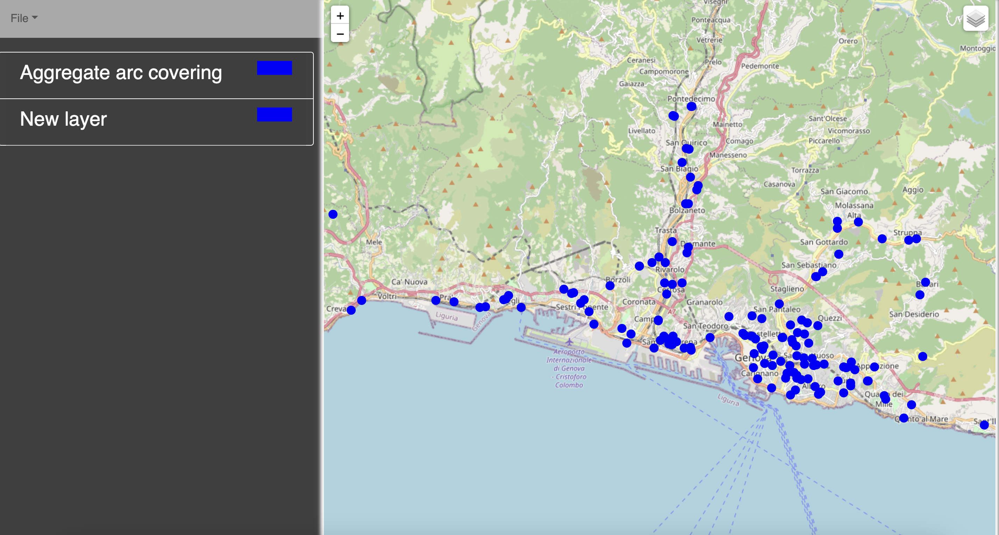

In [35]:
for u in filtered_graph.nodes():
    for node in tot_results:
        replaceN = str(node).replace(str(node),'n'+str(node))
        try:
            if shortest_paths[u][replaceN]:
                distanza = shortest_paths[u][replaceN]
                if distanza <= 3000:
                    filtered_graph.nodes[u]['reachable'] = True
                    break
        except:
            continue

In [36]:
reachable_nodes = [node for node in filtered_graph.nodes if filtered_graph.nodes[node].get('reachable') == True]
len(reachable_nodes)

8456

In [42]:
non_reachable_nodes = [node for node in filtered_graph.nodes if filtered_graph.nodes[node].get('reachable') != True]
len(non_reachable_nodes)

521

In [44]:
reach_graph = nx.DiGraph()

for node1 in non_reachable_nodes:
    for node2 in non_reachable_nodes:
        if node1 != node2:
            try:
                if shortest_paths[node1][node2]:
                    distance = shortest_paths[node1][node2]  
                    if distance <= 3000:
                        reach_graph.add_edge(node1, node2, weight=distance) 
            except:
                continue

In [45]:
def solve_dominating_set(graph):
    model = gp.Model("dominating-set")

    dominating_set = model.addVars(graph.nodes, vtype=GRB.BINARY, name="dominating_set")

    model.setObjective(dominating_set.sum(), GRB.MINIMIZE)

    for node in graph.nodes:
        successors = graph.successors(node)
        model.addConstr(dominating_set[node] + gp.quicksum(dominating_set[neighbor] for neighbor in successors) >= 1)

    model.optimize()

    if model.status == GRB.OPTIMAL:
        dominating_set_solution = [node for node in graph.nodes if dominating_set[node].x > 0.5]
        return dominating_set_solution
    else:
        return None


In [46]:
solve_dominating_set(reach_graph)

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[rosetta2])

CPU model: Apple M1
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 496 rows, 496 columns and 12014 nonzeros
Model fingerprint: 0xefbee30a
Variable types: 0 continuous, 496 integer (496 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 62.0000000
Presolve removed 496 rows and 496 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 8 available processors)

Solution count 2: 57 62 

Optimal solution found (tolerance 1.00e-04)
Best objective 5.700000000000e+01, best bound 5.700000000000e+01, gap 0.0000%


['n572',
 'n573',
 'n835',
 'n576',
 'n5766',
 'n593',
 'n8022',
 'n697',
 'n1129',
 'n4692',
 'n866',
 'n1178',
 'n1347',
 'n7230',
 'n7766',
 'n4349',
 'n5506',
 'n7164',
 'n8091',
 'n1737',
 'n3817',
 'n8583',
 'n7240',
 'n8459',
 'n8533',
 'n4535',
 'n5386',
 'n8019',
 'n4710',
 'n4742',
 'n4744',
 'n4950',
 'n6912',
 'n5139',
 'n7350',
 'n7207',
 'n6528',
 'n5591',
 'n5902',
 'n5839',
 'n5730',
 'n5795',
 'n5793',
 'n6031',
 'n8127',
 'n8133',
 'n5870',
 'n8116',
 'n5987',
 'n8276',
 'n6132',
 'n6198',
 'n6597',
 'n6859',
 'n6870',
 'n8320',
 'n8413']

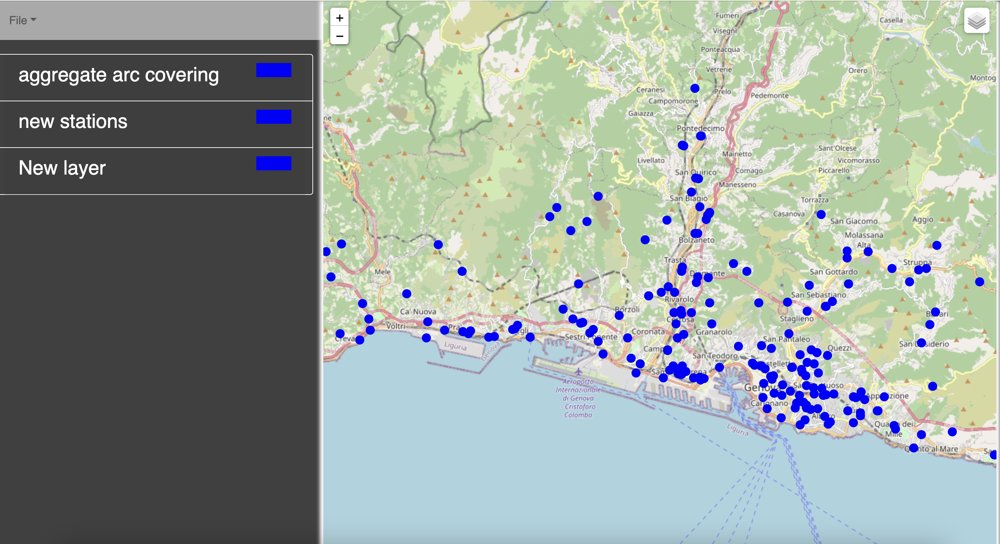